# データファイル詳細（MovieLens 100K）

| ファイル名 | 説明 |
|------------|------|
| `ml-data.tar.gz` | 圧縮ファイル。以下の手順で展開し `u` データを再生成できます：<br>`gunzip ml-data.tar.gz` → `tar xvf ml-data.tar` → `./mku.sh` |
| `u.data` | ユーザー 943 人 × 映画 1,682 本の評価 100,000 行（タブ区切り）<br>形式：`user id \t item id \t rating \t timestamp` |
| `u.info` | `u` データのユーザー数・アイテム数・評価数 |
| `u.item` | 映画情報（タブ区切り）<br>形式：`movie id \t movie title \t release date ...` |
| `u.genre` | ジャンル一覧 |
| `u.user` | ユーザー属性（タブ区切り）<br>形式：`user id \t age \t gender \t occupation \t zip code` |
| `u.occupation` | 職業一覧 |
| `u1.base` / `u1.test` … `u5.base` / `u5.test` | `u.data` を 80% / 20% に分割した5分割交差検証用セット |
| `ua.base` / `ua.test` / `ub.base` / `ub.test` | 各ユーザーのテストに10件ずつ含むよう分割したセット（`ua` と `ub` は相互に排他） |
| `allbut.pl` | 各ユーザーの評価を n 件だけテストに残し、残りを訓練にする Perl スクリプト |
| `mku.sh` | `u.data` から各種分割データを生成するシェルスクリプト |


In [70]:
"""
目標: 
1. クラスタリング(item, userに関して)
2. 行列分解(SVD, NMF, MF)
3. RecBoleのベンチマークを各機械学習モデルを実際に用いて再現する
"""

'\n目標: \n1. クラスタリング(item, userに関して)\n2. 行列分解(SVD, NMF, MF)\n3. RecBoleのベンチマークを各機械学習モデルを実際に用いて再現する\n'

In [71]:
# jupyter用
pip install pandas numpy matplotlib seaborn scikit-learn

SyntaxError: invalid syntax (1721853708.py, line 2)

In [2]:
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import warnings

warnings.filterwarnings('ignore')
np.seterr('ignore')
pd.set_option("display.max_columns", 100)

print("ok")

ok


# u.itemのEDA

In [3]:
cols = ['user_id', 'item_id', 'rating', 'timestamp']

# sep='\t'はタブ区切り
# header=Noneはヘッダ行がないことを示す
# names=colsは列名を指定する
# engine='python'はエンジンをPythonに指定する
df_data = pd.read_csv('u.data', sep='\t', header=None, names=cols, engine='python')

df_data.head(10)

,user_id,item_id,rating,timestamp
0,196,242,3,881250949
1,186,302,3,891717742
2,22,377,1,878887116
3,244,51,2,880606923
4,166,346,1,886397596
5,298,474,4,884182806
6,115,265,2,881171488
7,253,465,5,891628467
8,305,451,3,886324817
9,6,86,3,883603013


In [4]:
# itemに関してクラスタリングを行う

df_item = pd.read_csv("u.item", sep="|", header=None, encoding="latin-1")
print("df_item shape: ", df_item.shape)
df_item.head()

df_item shape:  (1682, 24)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


In [5]:
# 列名がないため，列名を付与する
cols_item = [
    "movie_id", "movie_title", "release_date", "unknown", "url", "unknown", "Action", \
    "Adventure", "Animation", "Children's", "Comedy", "Crime", "Documentary", \
    "Drama", "Fantasy", "Film-Noir", "Horror", "Musical", "Mystery", "Romance",\
    "Sci-Fi", "Thriller", "War", "Western"
    ]
df_item.columns = cols_item
df_item.head(10)

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Shanghai Triad (Yao a yao yao dao waipo qiao) ...,01-Jan-1995,NaN,http://us.imdb.com/Title?Yao+a+yao+yao+dao+wai...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
6,7,Twelve Monkeys (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Twelve%20Monk...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
7,8,Babe (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Babe%20(1995),0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0
8,9,Dead Man Walking (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Dead%20Man%20...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,10,Richard III (1995),22-Jan-1996,NaN,http://us.imdb.com/M/title-exact?Richard%20III...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0


In [6]:
# 欠損値の確認
df_item.isnull().sum()

movie_id           0
movie_title        0
release_date       1
unknown         1682
url                3
unknown            0
Action             0
Adventure          0
Animation          0
Children's         0
Comedy             0
Crime              0
Documentary        0
Drama              0
Fantasy            0
Film-Noir          0
Horror             0
Musical            0
Mystery            0
Romance            0
Sci-Fi             0
Thriller           0
War                0
Western            0
dtype: int64

In [7]:
df_item

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1677,1678,Mat' i syn (1997),06-Feb-1998,NaN,http://us.imdb.com/M/title-exact?Mat%27+i+syn+...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1678,1679,B. Monkey (1998),06-Feb-1998,NaN,http://us.imdb.com/M/title-exact?B%2E+Monkey+(...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0
1679,1680,Sliding Doors (1998),01-Jan-1998,NaN,http://us.imdb.com/Title?Sliding+Doors+(1998),0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
1680,1681,You So Crazy (1994),01-Jan-1994,NaN,http://us.imdb.com/M/title-exact?You%20So%20Cr...,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [8]:
# 6列目以降のジャンルのみを用いてクラスタリングを行う

df_item_X = df_item.iloc[:, 6:].copy()
print("df_item_X shape: ", df_item_X.shape)
df_item_X.head()

df_item_X shape:  (1682, 18)


,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


In [9]:
# 既に二値化されているため，標準化は行わない．
# svd_solverは4種類(auto, full, randomized, arpack)あるので，まずはautoを試す
# (今回のデータ量は1000 * 18 -> auto)

"""
1,000行 × 50列 -> full
10,000行 × 100列 -> auto or randomized
100,000行 × 500列 -> randomized
1,000,000行 × 1000列 -> randomized
"""

pca = PCA(n_components=17, svd_solver='auto')

In [124]:
help(pca)

Help on PCA in module sklearn.decomposition._pca object:

class PCA(sklearn.decomposition._base._BasePCA)
 |  PCA(n_components=None, *, copy=True, whiten=False, svd_solver='auto', tol=0.0, iterated_power='auto', n_oversamples=10, power_iteration_normalizer='auto', random_state=None)
 |  
 |  Principal component analysis (PCA).
 |  
 |  Linear dimensionality reduction using Singular Value Decomposition of the
 |  data to project it to a lower dimensional space. The input data is centered
 |  but not scaled for each feature before applying the SVD.
 |  
 |  It uses the LAPACK implementation of the full SVD or a randomized truncated
 |  SVD by the method of Halko et al. 2009, depending on the shape of the input
 |  data and the number of components to extract.
 |  
 |  With sparse inputs, the ARPACK implementation of the truncated SVD can be
 |  used (i.e. through :func:`scipy.sparse.linalg.svds`). Alternatively, one
 |  may consider :class:`TruncatedSVD` where the data are not centered.


In [10]:
X_pca = pca.fit_transform(df_item_X)

explained_variance:  [0.23178038 0.17385512 0.09304758 0.08820414 0.07725641 0.05567255
 0.04515646 0.0383953  0.03363085 0.0322415  0.02831051 0.02448802
 0.02165152 0.01655481 0.0115628  0.01095801 0.00913868]
explained_variance_sum:  0.9919046593594743


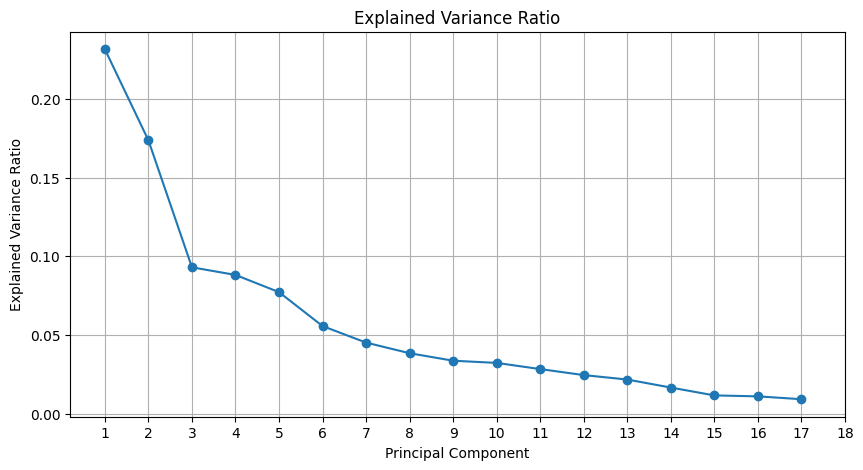

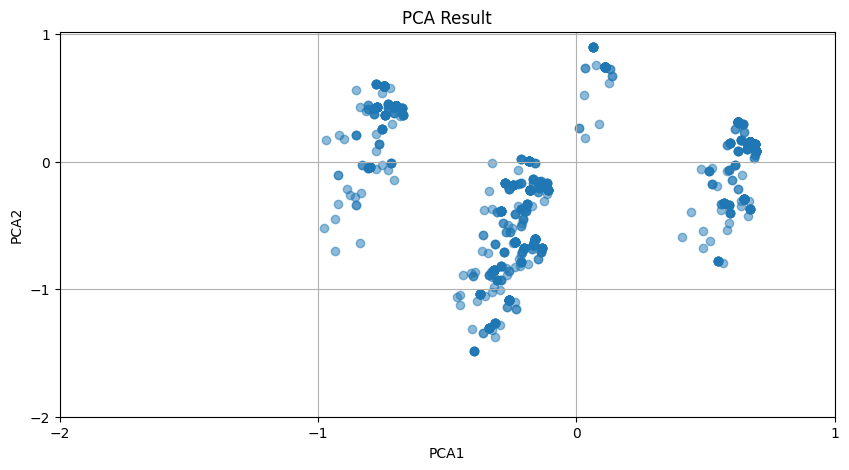

In [12]:
explained_variance = pca.explained_variance_ratio_
print("explained_variance: ", explained_variance)
print("explained_variance_sum: ", explained_variance.sum())

# 分散説明率の可視化
plt.figure(figsize=(10, 5))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.title("Explained Variance Ratio")
plt.xlabel("Principal Component")
plt.ylabel("Explained Variance Ratio")
plt.xticks(range(1, 19))
plt.grid()
plt.show()

# 2次元に圧縮したデータを可視化
plt.figure(figsize=(10, 5))
plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=0.5)
plt.title("PCA Result")
plt.xlabel("PCA1")
plt.ylabel("PCA2")
plt.yticks(range(-2, 2))
plt.xticks(range(-2, 2))
plt.grid()
plt.show()

In [13]:
# 散布図を用いて，映画のタイトルを表示するためのデータフレームの作成

import copy

pca_df_item = copy.deepcopy(df_item[["movie_title"]])
pca_df_item["PCA 1"] = X_pca[:, 0]
pca_df_item["PCA 2"] = X_pca[:, 1]

# PCAの絶対値をとって、新しい列に追加（比較用）
pca_df_item["abs_PCA1"] = pca_df_item["PCA 1"].abs()
pca_df_item["abs_PCA2"] = pca_df_item["PCA 2"].abs()

# 絶対値で降順にソート
pca_df_item["abs_sum"] = pca_df_item["abs_PCA1"] + pca_df_item["abs_PCA2"]
pca_df_item_sorted = pca_df_item.sort_values(by="abs_sum", ascending=False)

# 4. 上位10件を表示
pca_df_item_sorted[["movie_title", "PCA 1", "PCA 2", "abs_sum"]].head(10)

,movie_title,PCA 1,PCA 2,abs_sum
830,Escape from L.A. (1996),-0.396994,-1.487859,1.884853
163,"Abyss, The (1989)",-0.396994,-1.487859,1.884853
251,"Lost World: Jurassic Park, The (1997)",-0.396994,-1.487859,1.884853
357,Spawn (1997),-0.396994,-1.487859,1.884853
635,Escape from New York (1981),-0.396994,-1.487859,1.884853
425,"Transformers: The Movie, The (1986)",-0.405632,-1.311884,1.717516
182,Alien (1979),-0.360729,-1.340875,1.701604
664,Alien 3 (1992),-0.360729,-1.340875,1.701604
801,Hard Target (1993),-0.314907,-1.377877,1.692784
259,Event Horizon (1997),-0.327202,-1.322560,1.649762


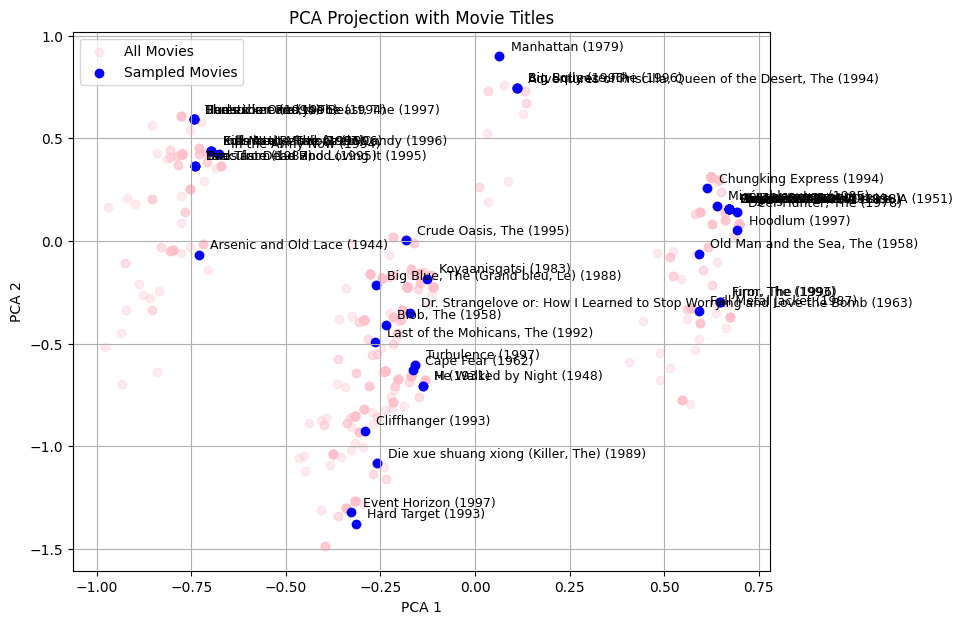

In [14]:
# 点のプロット（全体：ピンク）
plt.figure(figsize=(9, 7))
plt.scatter(pca_df_item["PCA 1"], pca_df_item["PCA 2"], color='pink', alpha=0.3, label='All Movies')

# ラベル付きプロット（サンプル：青）
sampled_df = pca_df_item.sample(50, random_state=0)
plt.scatter(sampled_df["PCA 1"], sampled_df["PCA 2"], color='blue', label='Sampled Movies')

# タイトルを表示（ズラして）
for _, row in sampled_df.iterrows():
    x, y = row["PCA 1"], row["PCA 2"]
    title = row["movie_title"]
    plt.text(x + 0.03, y + 0.03, title, fontsize=9)

plt.title("PCA Projection with Movie Titles")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.grid(True)
plt.legend()
plt.show()


In [17]:
# cos類似度と比較する
from sklearn.metrics.pairwise import cosine_similarity

pca = PCA(n_components=2, svd_solver='auto')
X_pca = pca.fit_transform(df_item_X)

# PCAを行ってからcos類似度行列を計算
cos_sim = cosine_similarity(X_pca)

print("ok")

ok


In [18]:
df_item.head(10)

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Shanghai Triad (Yao a yao yao dao waipo qiao) ...,01-Jan-1995,NaN,http://us.imdb.com/Title?Yao+a+yao+yao+dao+wai...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
6,7,Twelve Monkeys (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Twelve%20Monk...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
7,8,Babe (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Babe%20(1995),0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0
8,9,Dead Man Walking (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Dead%20Man%20...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,10,Richard III (1995),22-Jan-1996,NaN,http://us.imdb.com/M/title-exact?Richard%20III...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0


In [19]:
# 元データでのcos類似度の計算
cos_sim_raw = cosine_similarity(df_item_X)

# PCA後での類似度（次元削減後）
cos_sim_pca = cosine_similarity(X_pca)

# 例：映画 i 番と j 番の類似度比較
i, j = 0, 28

title_i = df_item.iloc[i]["movie_title"]
title_j = df_item.iloc[j]["movie_title"]

print(f"i番目とj番目は: {title_i} と {title_j}")
print("元データでの類似度：", cos_sim_raw[i, j])
print("PCA後の類似度：", cos_sim_pca[i, j])


i番目とj番目は: Toy Story (1995) と Batman Forever (1995)
元データでの類似度： 0.2886751345948129
PCA後の類似度： 0.6619945002301955


In [20]:
# コサイン類似度が最大のペアを探す（自己比較を除く）
np.fill_diagonal(cos_sim_pca, 0)
i, j = np.unravel_index(np.argmax(cos_sim_pca), cos_sim_pca.shape)

# 映画タイトルの確認
print("類似な映画ペア：", df_item["movie_title"].iloc[i], "-", df_item["movie_title"].iloc[j])

類似な映画ペア： Four Rooms (1995) - Nikita (La Femme Nikita) (1990)


In [21]:
df_item_X.head()

,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


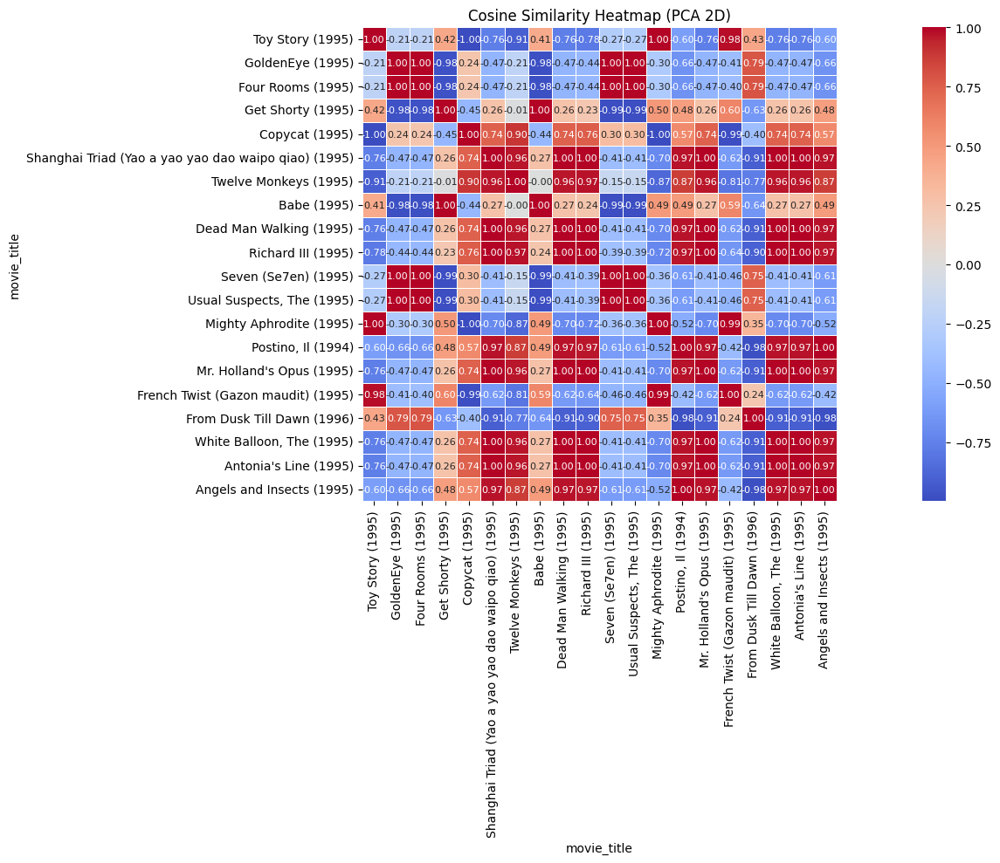

In [22]:
# 散布図で類似度の高い映画同士を線で結ぶ．

# PCAは2次元で圧縮済み
cos_sim_pca_2d = cosine_similarity(X_pca)

# 映画タイトルをインデックスに設定
movie_titles = df_item["movie_title"]
sim_df = pd.DataFrame(cos_sim_pca_2d, index=movie_titles, columns=movie_titles)

# 最初の20本を抽出
subset_df = sim_df.iloc[:20, :20]

# ヒートマップ表示(最初の20本)
plt.figure(figsize=(20, 10))
sns.heatmap(
    subset_df,
    cmap="coolwarm",
    annot=True,
    fmt=".2f",
    square=True,
    linewidths=0.5,
    annot_kws={"size": 8}  # 👈 数値の文字サイズを小さく
)
plt.title("Cosine Similarity Heatmap (PCA 2D)")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

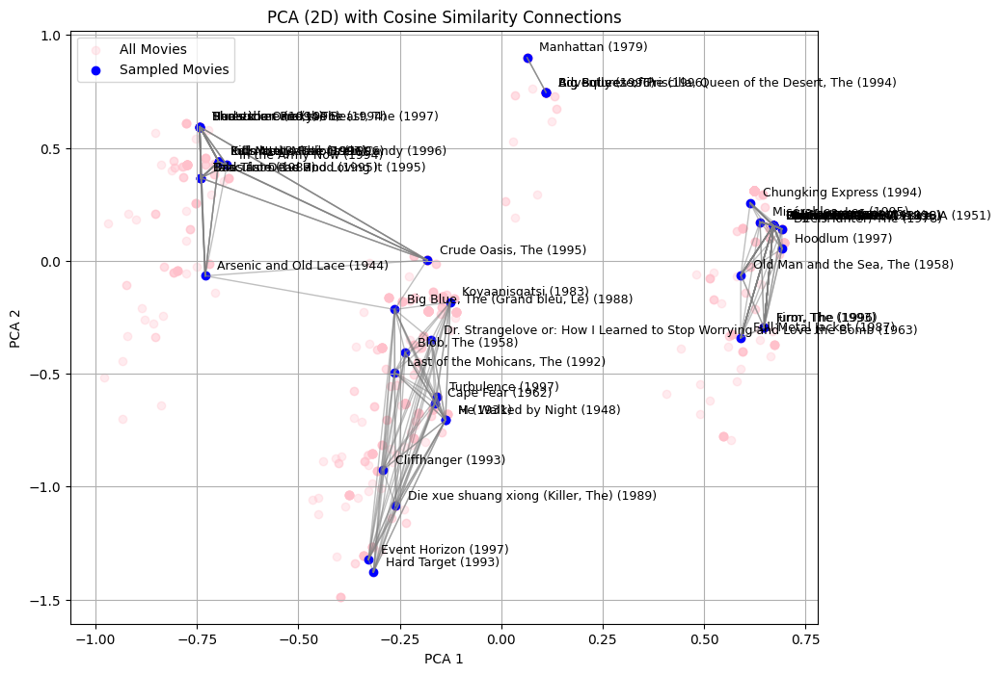

In [23]:
"""
PCAをした後で線で繋いだバージョン
-> 元のデータ構造が崩れているから，正確なcos類似度ではないのでは.....
"""

# 1. PCA空間でコサイン類似度を計算（2次元）
X_pca_2d = pca_df_item[["PCA 1", "PCA 2"]].values
cos_sim = cosine_similarity(X_pca_2d)

# 2. 映画のサンプル（タイトルつき）を50件だけ抽出
sampled_df = pca_df_item.sample(50, random_state=0).reset_index(drop=True)
X_sample = sampled_df[["PCA 1", "PCA 2"]].values
titles = sampled_df["movie_title"].tolist()

# 3. サンプル内で再計算（50×50）
cos_sim_sample = cosine_similarity(X_sample)

# 4. 散布図を描画
plt.figure(figsize=(10, 8))
plt.scatter(pca_df_item["PCA 1"], pca_df_item["PCA 2"], color='pink', alpha=0.3, label='All Movies')
plt.scatter(X_sample[:, 0], X_sample[:, 1], color='blue', label='Sampled Movies')

# 5. 類似度が高いペア（0.70以上）に線を引く
threshold = 0.70
for i in range(len(X_sample)):
    for j in range(i + 1, len(X_sample)):
        if cos_sim_sample[i, j] >= threshold:
            x1, y1 = X_sample[i]
            x2, y2 = X_sample[j]
            plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

# 6. タイトルを表示
for i, (x, y) in enumerate(X_sample):
    plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

plt.title("PCA (2D) with Cosine Similarity Connections")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.grid(True)
plt.legend()
plt.show()


In [ ]:
# 全ペアを作成してcos類似度を計算する→可視化するために2次元にする

from sklearn.decomposition import PCA

# 特徴量（元空間）
X = df_item_X.values

# 類似度計算（元の高次元空間）
cos_sim = cosine_similarity(X)

# 次元削減（PCAで2次元）
pca = PCA(n_components=2, random_state=0)
X_pca = pca.fit_transform(X)

# タイトル取得（任意）
titles = df_item["movie_title"].tolist()

# 類似度のしきい値リスト
thresholds = [0.7, 0.8, 0.9, 0.95]

# 上三角インデックスを取得（自己比較・重複除く）
n = len(X)
triu_idx = np.triu_indices(n, k=1)

# 各しきい値で描画
for threshold in thresholds:
    plt.figure(figsize=(10, 8))
    
    # 全点を描画（ピンク）
    plt.scatter(X_pca[:, 0], X_pca[:, 1], color='pink', alpha=0.4, label='All Movies')

    # 条件を満たすペアのみ描画
    for i, j in zip(*triu_idx):
        if cos_sim[i, j] >= threshold:
            x1, y1 = X_pca[i]
            x2, y2 = X_pca[j]
            plt.plot([x1, x2], [y1, y2], color='gray', linewidth=0.5, alpha=0.5)

    plt.title(f"Cosine Similarity ≥ {threshold} (All Movies)")
    plt.xlabel("PCA 1")
    plt.ylabel("PCA 2")
    plt.grid(True)
    plt.legend()
    plt.show()

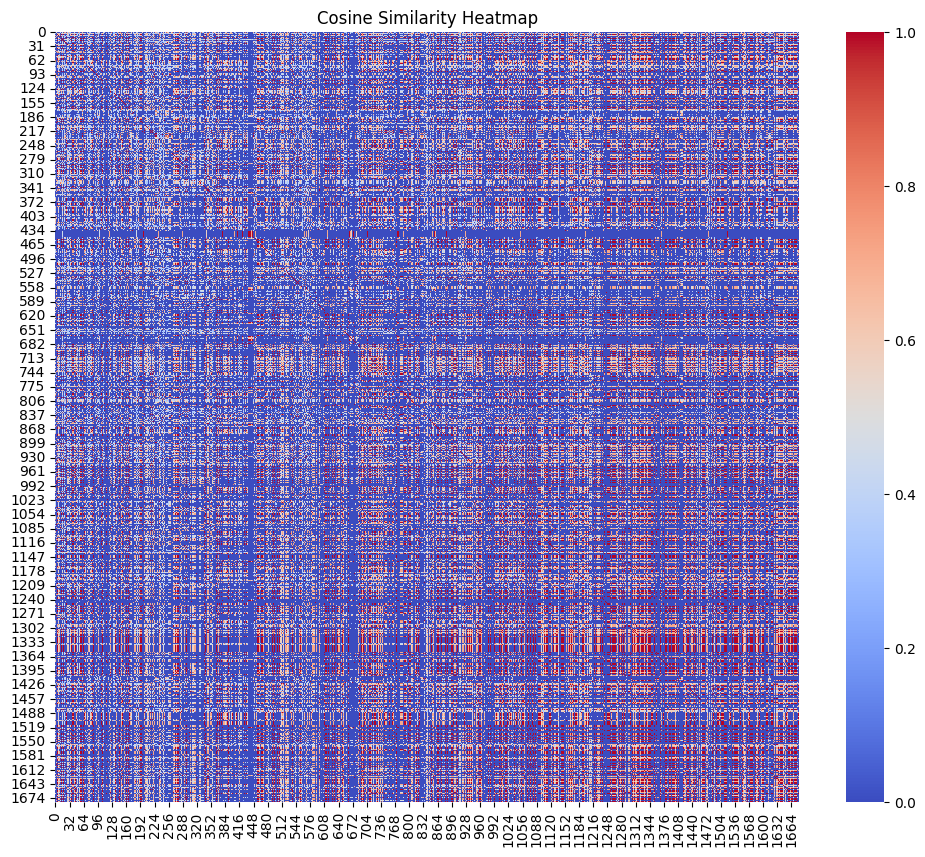

In [25]:
# cos類似度のヒートマップを描画する

cos_sim_matrix = cosine_similarity(df_item_X.values)
plt.figure(figsize=(12, 10))
sns.heatmap(cos_sim_matrix, cmap='coolwarm', vmin=0, vmax=1)
plt.title("Cosine Similarity Heatmap")
plt.show()

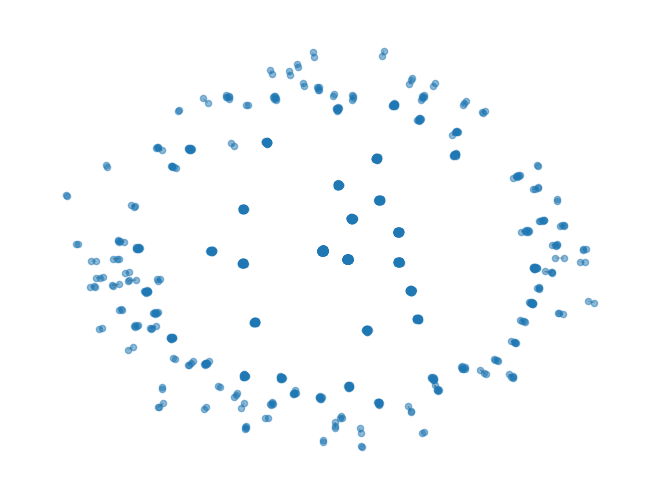

In [26]:
import networkx as nx

G = nx.Graph()
for i, j in zip(*np.triu_indices(n, k=1)):
    if cos_sim_matrix[i, j] >= 0.9:
        G.add_edge(i, j, weight=cos_sim_matrix[i, j])

# 可視化（spring layoutなどで）
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=False, node_size=20, edge_color='gray', alpha=0.5)


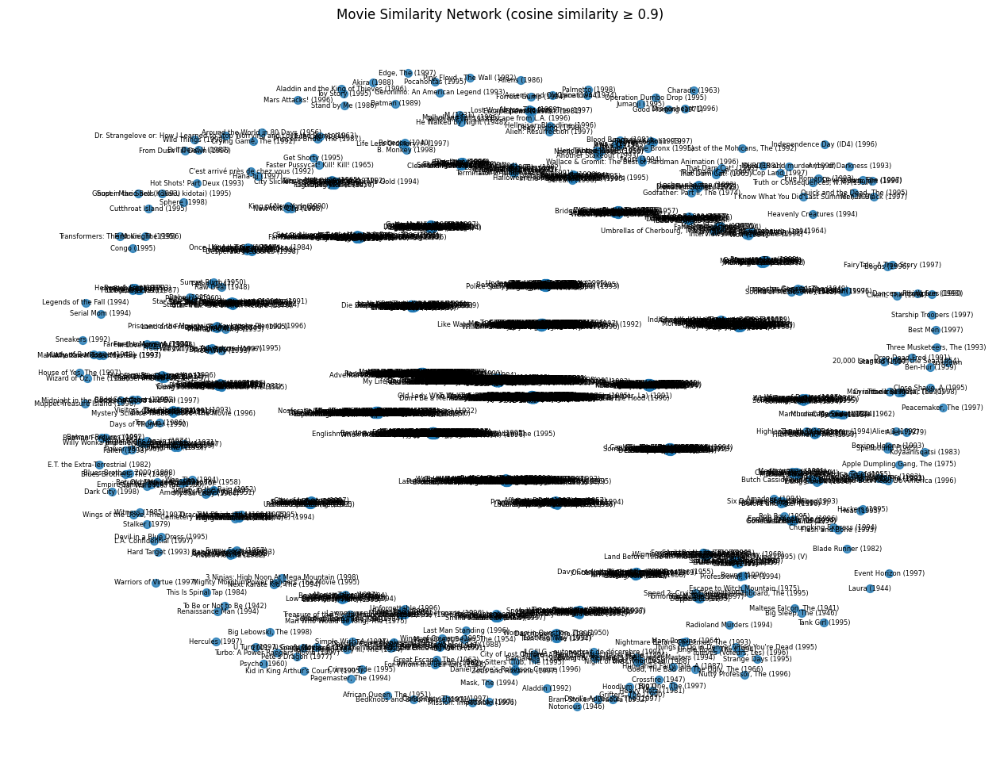

In [27]:
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

# 特徴ベクトルとタイトル
X = df_item_X.values
titles = df_item["movie_title"].tolist()

# 類似度の計算
cos_sim_matrix = cosine_similarity(X)

# 類似度のしきい値
threshold = 0.9

# グラフ初期化
G = nx.Graph()

# ノード追加（タイトルをラベルとして持たせる）
for idx, title in enumerate(titles):
    G.add_node(idx, label=title)

# エッジ追加（類似度がしきい値以上のペア）
n = len(titles)
for i in range(n):
    for j in range(i + 1, n):
        if cos_sim_matrix[i, j] >= threshold:
            G.add_edge(i, j, weight=cos_sim_matrix[i, j])

# レイアウト（spring_layoutが自然）
pos = nx.spring_layout(G, seed=42)

# 描画設定
plt.figure(figsize=(16, 12))
nx.draw_networkx_nodes(G, pos, node_size=50, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=0.5, alpha=0.3)

# タイトルを表示（ノード番号に対応するタイトルを表示）
labels = nx.get_node_attributes(G, 'label')
nx.draw_networkx_labels(G, pos, labels, font_size=6)

plt.title("Movie Similarity Network (cosine similarity ≥ 0.9)")
plt.axis("off")
plt.show()


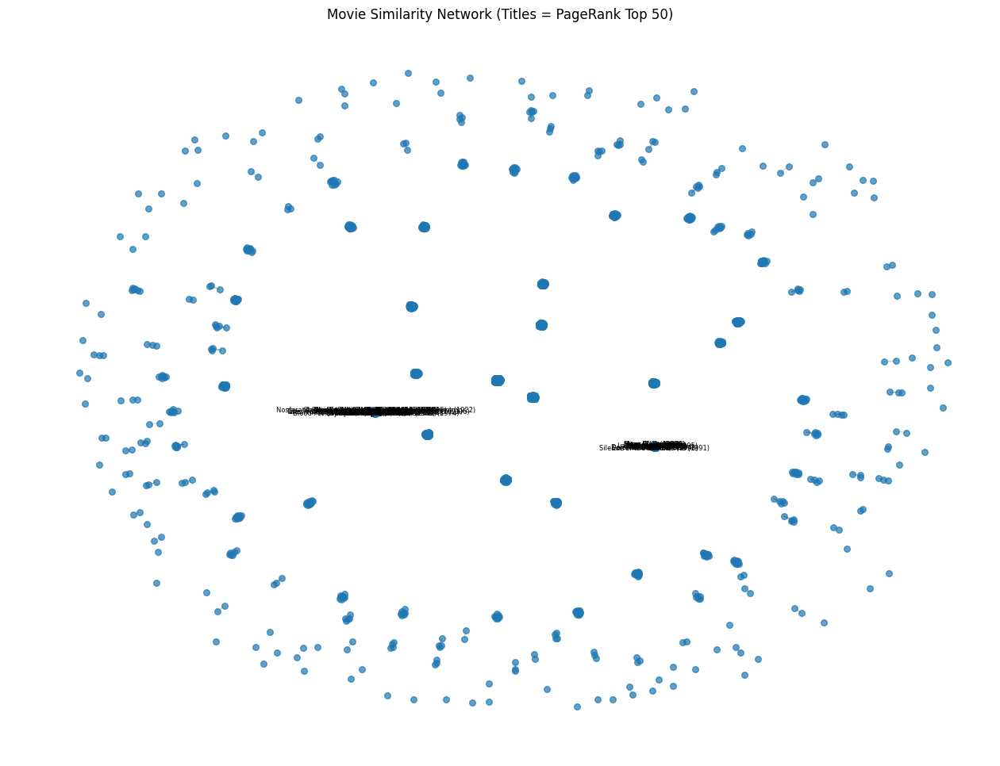

In [28]:
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

# 類似度としきい値
X = df_item_X.values
titles = df_item["movie_title"].tolist()
cos_sim = cosine_similarity(X)
threshold = 0.9

# グラフ作成
G = nx.Graph()
for i, title in enumerate(titles):
    G.add_node(i, label=title)

n = len(titles)
for i in range(n):
    for j in range(i + 1, n):
        if cos_sim[i, j] >= threshold:
            G.add_edge(i, j)

# レイアウト
pos = nx.spring_layout(G, seed=42)

# PageRankで上位ノードだけラベル表示
pagerank = nx.pagerank(G)
top_nodes = sorted(pagerank, key=pagerank.get, reverse=True)[:50]  # 上位50件

labels = {i: G.nodes[i]["label"] for i in top_nodes}

# 可視化
plt.figure(figsize=(16, 12))
nx.draw_networkx_nodes(G, pos, node_size=30, alpha=0.7)
nx.draw_networkx_edges(G, pos, width=0.5, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=6)

plt.title("Movie Similarity Network (Titles = PageRank Top 50)")
plt.axis("off")
plt.show()


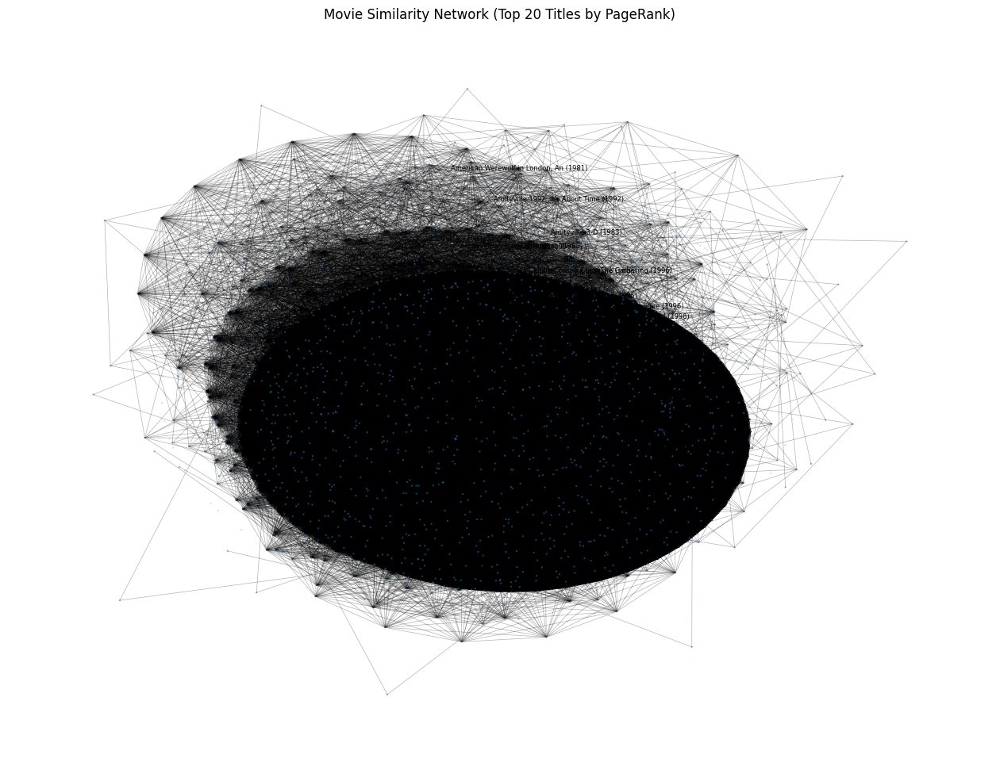

In [29]:
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

# 特徴量とタイトル
X = df_item_X.values
titles = df_item["movie_title"].tolist()
cos_sim = cosine_similarity(X)
threshold = 0.9

# グラフ構築
G = nx.Graph()
for i, title in enumerate(titles):
    G.add_node(i, label=title)

n = len(titles)
for i in range(n):
    for j in range(i + 1, n):
        if cos_sim[i, j] >= threshold:
            G.add_edge(i, j)

# レイアウト（kamada_kawaiの方が詰まらない）
pos = nx.kamada_kawai_layout(G)

# PageRankでノード重要度を計算
pagerank = nx.pagerank(G)
top_nodes = sorted(pagerank, key=pagerank.get, reverse=True)[:20]  # 上位20件のみラベル表示

# ラベルとノードサイズを定義
labels = {i: G.nodes[i]["label"] for i in top_nodes}
node_sizes = [500 * pagerank[i] for i in G.nodes]

# 描画
plt.figure(figsize=(16, 12))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, alpha=0.6)
nx.draw_networkx_edges(G, pos, width=0.5, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=6)

plt.title("Movie Similarity Network (Top 20 Titles by PageRank)")
plt.axis("off")
plt.show()


In [30]:
import networkx as nx
from sklearn.metrics.pairwise import cosine_similarity

# 特徴ベクトルとタイトル
X = df_item_X.values
titles = df_item["movie_title"].tolist()

# コサイン類似度計算
cos_sim = cosine_similarity(X)
threshold = 0.9  # 類似度のしきい値

# グラフ構築
G = nx.Graph()
for i, title in enumerate(titles):
    G.add_node(i, label=title)

n = len(titles)
for i in range(n):
    for j in range(i + 1, n):
        if cos_sim[i, j] >= threshold:
            G.add_edge(i, j)

# PageRank計算（中心性の指標）
pagerank = nx.pagerank(G)

# 上位20件（中心に位置する映画）
top_nodes = sorted(pagerank, key=pagerank.get, reverse=True)[:20]

# タイトルとスコアを出力
print("🔍 中心に位置する映画（PageRank上位20）:")
for rank, node in enumerate(top_nodes, 1):
    print(f"{rank:2d}. {titles[node]} (score: {pagerank[node]:.5f})")


🔍 中心に位置する映画（PageRank上位20）:
 1. Taxi Driver (1976) (score: 0.00063)
 2. Disclosure (1994) (score: 0.00063)
 3. Dolores Claiborne (1994) (score: 0.00063)
 4. Firm, The (1993) (score: 0.00063)
 5. Silence of the Lambs, The (1991) (score: 0.00063)
 6. Diabolique (1996) (score: 0.00063)
 7. Shining, The (1980) (score: 0.00063)
 8. Nightmare on Elm Street, A (1984) (score: 0.00063)
 9. Sling Blade (1996) (score: 0.00063)
10. Apt Pupil (1998) (score: 0.00063)
11. Crash (1996) (score: 0.00063)
12. Prophecy II, The (1998) (score: 0.00063)
13. Mary Reilly (1996) (score: 0.00063)
14. Tales From the Crypt Presents: Demon Knight (1995) (score: 0.00063)
15. Tales from the Crypt Presents: Bordello of Blood (1996) (score: 0.00063)
16. Children of the Corn: The Gathering (1996) (score: 0.00063)
17. American Werewolf in London, An (1981) (score: 0.00063)
18. Amityville 1992: It's About Time (1992) (score: 0.00063)
19. Amityville 3-D (1983) (score: 0.00063)
20. Amityville: A New Generation (1993) (score:

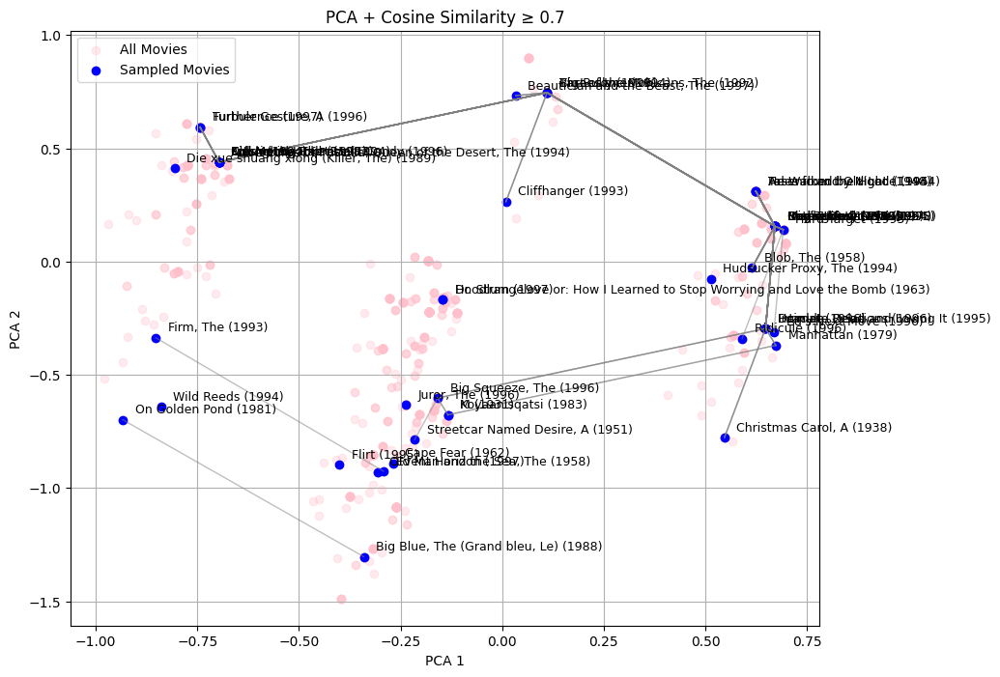

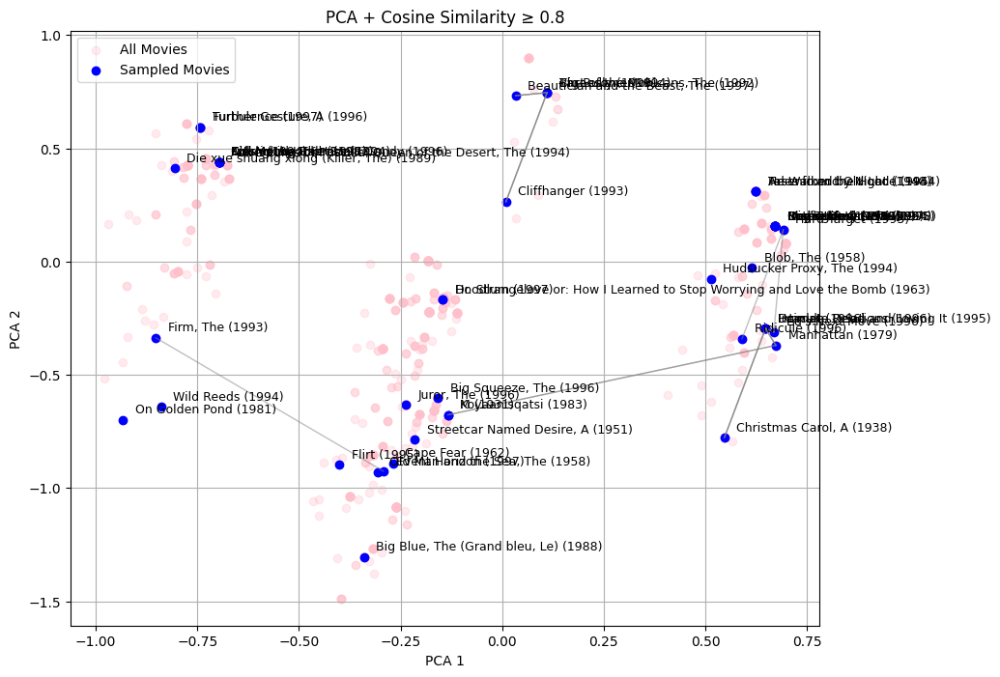

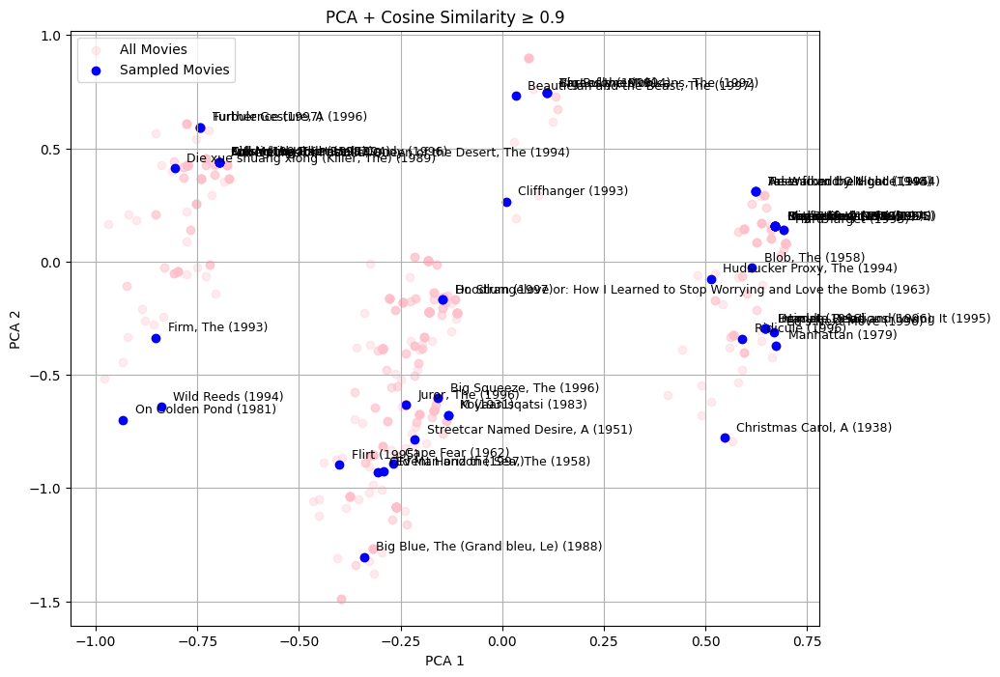

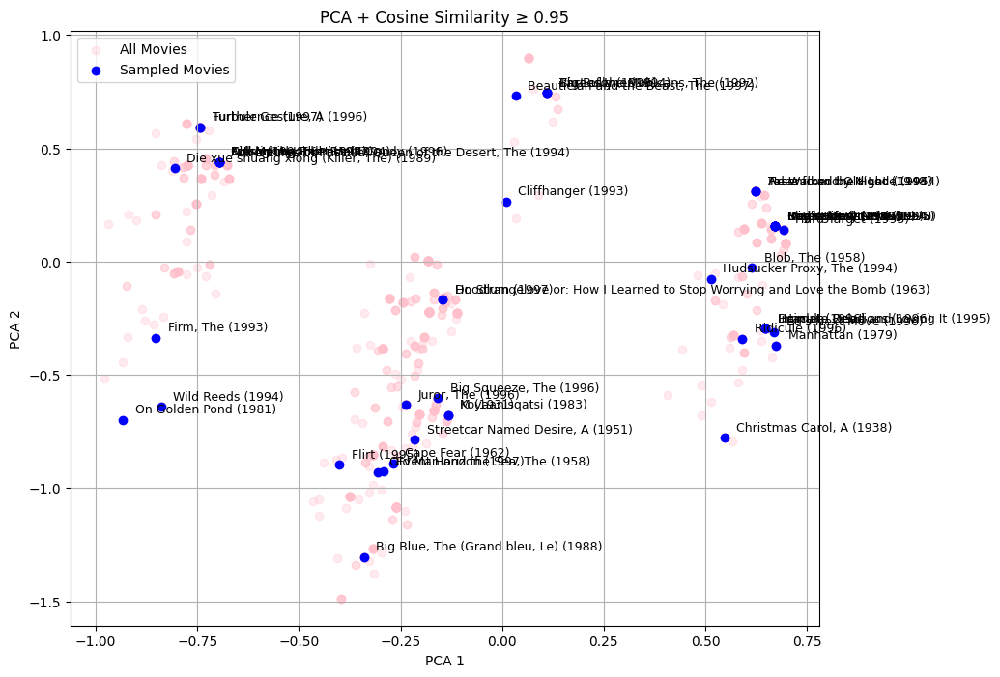

In [31]:
# 1. PCAで全体を2次元に圧縮（プロット用）
X_all = df_item_X.values
pca = PCA(n_components=2, random_state=0)
X_all_2d = pca.fit_transform(X_all)

# 2. サンプル50件を抽出（タイトル付き）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
titles = sampled_df["movie_title"].tolist()

# 3. サンプルの座標と類似度
X_sample_2d = X_all_2d[sample_indices]
cos_sim_sample = cosine_similarity(df_item_X.iloc[sample_indices].values)

# 4. 閾値を変えながらプロット
thresholds = [0.7, 0.8, 0.9, 0.95]

for threshold in thresholds:
    plt.figure(figsize=(10, 8))

    # 4.1 全体の点（ピンク）
    plt.scatter(X_all_2d[:, 0], X_all_2d[:, 1], color='pink', alpha=0.3, label='All Movies')

    # 4.2 サンプル点（青）
    plt.scatter(X_sample_2d[:, 0], X_sample_2d[:, 1], color='blue', label='Sampled Movies')

    # 4.3 類似度が高いペアに線を引く
    for i in range(len(X_sample_2d)):
        for j in range(i + 1, len(X_sample_2d)):
            if cos_sim_sample[i, j] >= threshold:
                x1, y1 = X_sample_2d[i]
                x2, y2 = X_sample_2d[j]
                plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

    # 4.4 タイトルを表示
    for i, (x, y) in enumerate(X_sample_2d):
        plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

    plt.title(f"PCA + Cosine Similarity ≥ {threshold}")
    plt.xlabel("PCA 1")
    plt.ylabel("PCA 2")
    plt.grid(True)
    plt.legend()
    plt.show()


| コサイン類似度 | PCA空間での意味       | 解釈例                                                         |
|----------------|------------------------|------------------------------------------------------------------|
| ≒1.0           | ほぼ同じ方向           | 主成分空間で類似している（＝圧縮された軸での特徴が似ている）     |
| 0.7〜0.9       | やや近い方向           | 圧縮後の要素で共通のパターンがある                             |
| 0.4〜0.7       | 中程度                 | 一部の成分が一致するが他は異なる可能性あり                      |
| < 0.4          | 異なる方向             | PCA軸では明確に異なる特徴を持つと判断される                    |


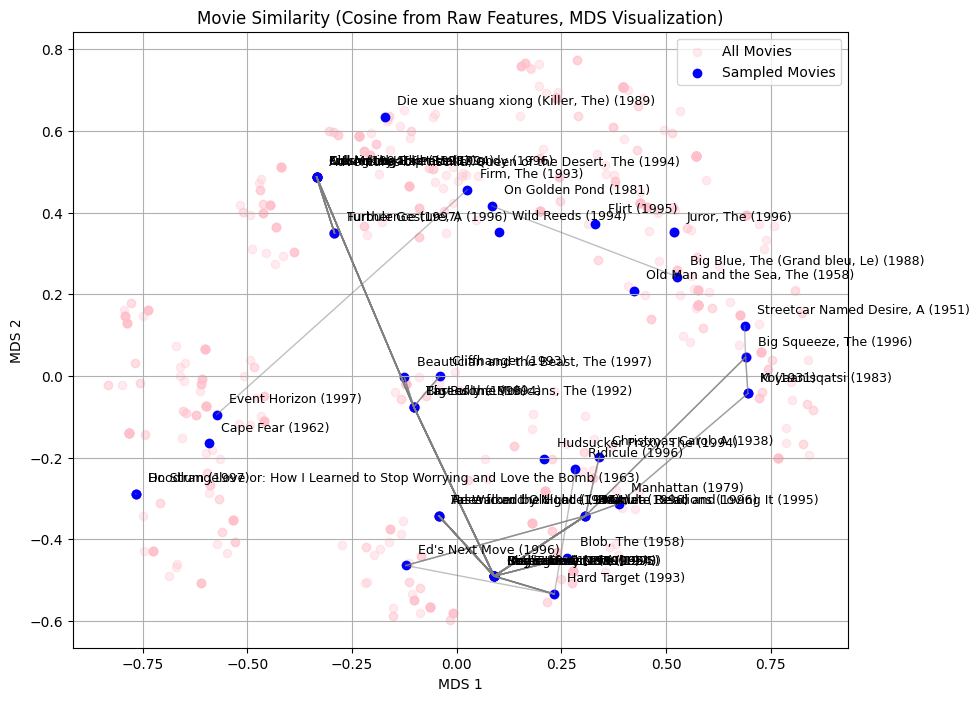

In [32]:
# MDSを用いてPCAと比較する

from sklearn.manifold import MDS

# 1. 類似度計算（元特徴量）
X_all = df_item_X.values
cos_sim_all = cosine_similarity(X_all)

# 2. 全体をMDSで2次元に可視化（距離＝1 - 類似度）
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=0)
cos_dist_all = 1 - cos_sim_all
X_all_2d = mds.fit_transform(cos_dist_all)

# 3. サンプル50件を抽出（タイトル付き）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
titles = sampled_df["movie_title"].tolist()

# 4. サンプルの2次元位置と類似度
X_sample_2d = X_all_2d[sample_indices]
cos_sim_sample = cosine_similarity(df_item_X.iloc[sample_indices].values)

# 5. プロット開始
plt.figure(figsize=(10, 8))

# 5.1 全体の点（ピンク）
plt.scatter(X_all_2d[:, 0], X_all_2d[:, 1], color='pink', alpha=0.3, label='All Movies')

# 5.2 サンプル点（青）
plt.scatter(X_sample_2d[:, 0], X_sample_2d[:, 1], color='blue', label='Sampled Movies')

# 6. 類似度が高いサンプル間に線を引く（0.7以上）
threshold = 0.7
for i in range(len(X_sample_2d)):
    for j in range(i + 1, len(X_sample_2d)):
        if cos_sim_sample[i, j] >= threshold:
            x1, y1 = X_sample_2d[i]
            x2, y2 = X_sample_2d[j]
            plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

# 7. サンプルタイトルの表示
for i, (x, y) in enumerate(X_sample_2d):
    plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

plt.title("Movie Similarity (Cosine from Raw Features, MDS Visualization)")
plt.xlabel("MDS 1")
plt.ylabel("MDS 2")
plt.grid(True)
plt.legend()
plt.show()


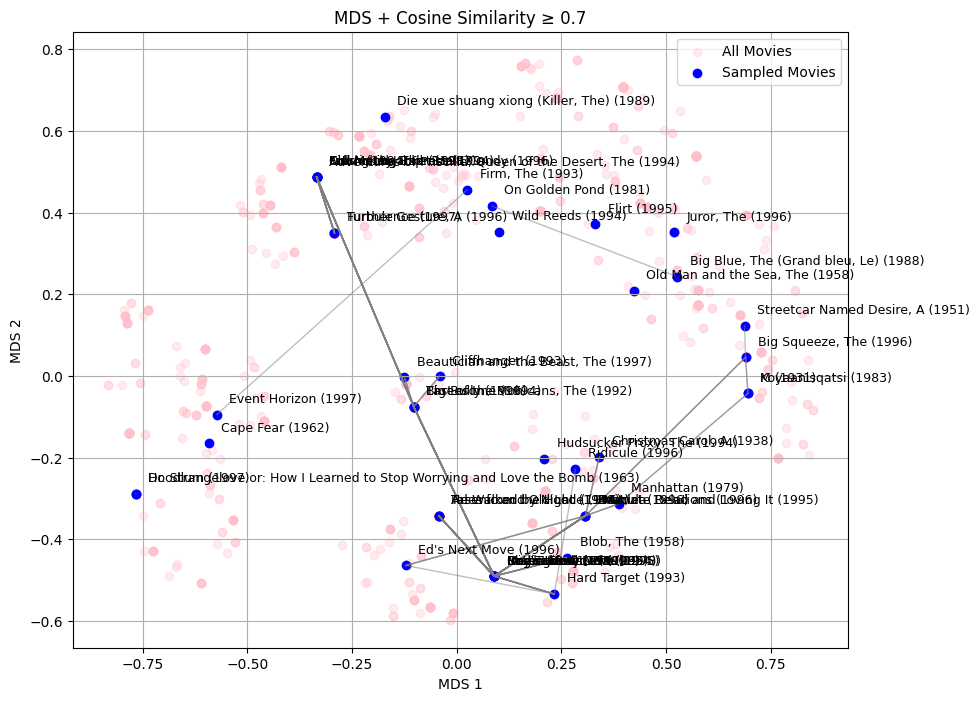

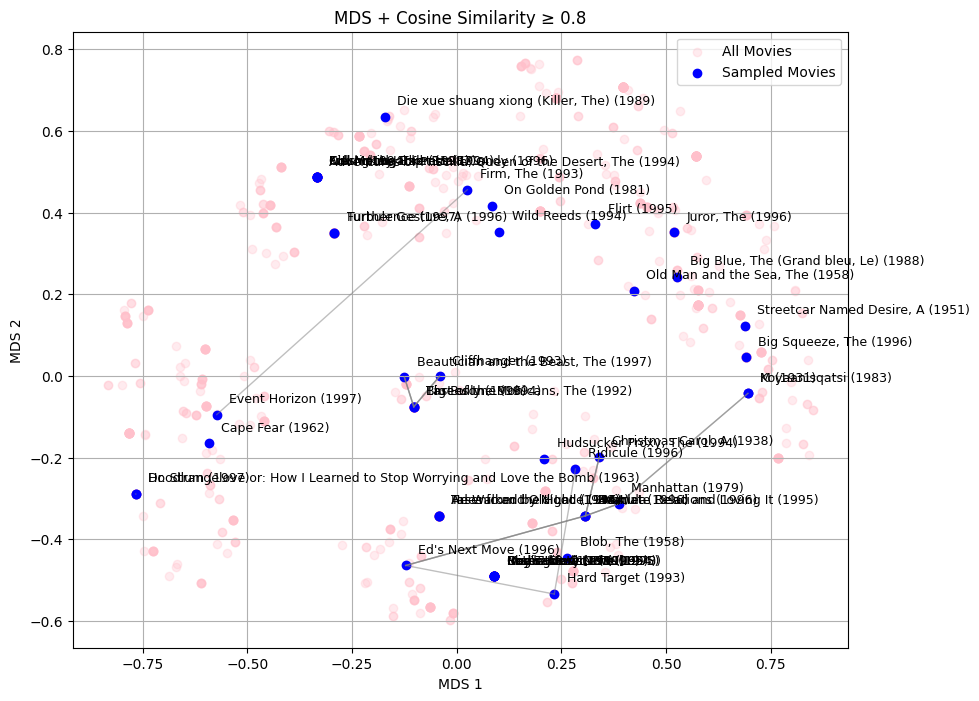

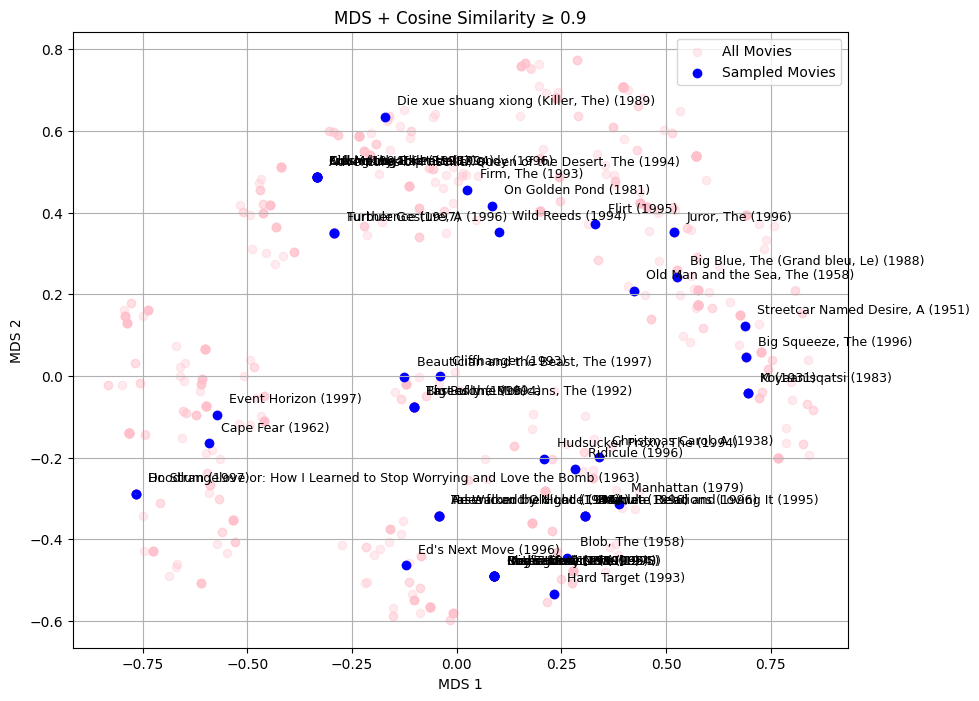

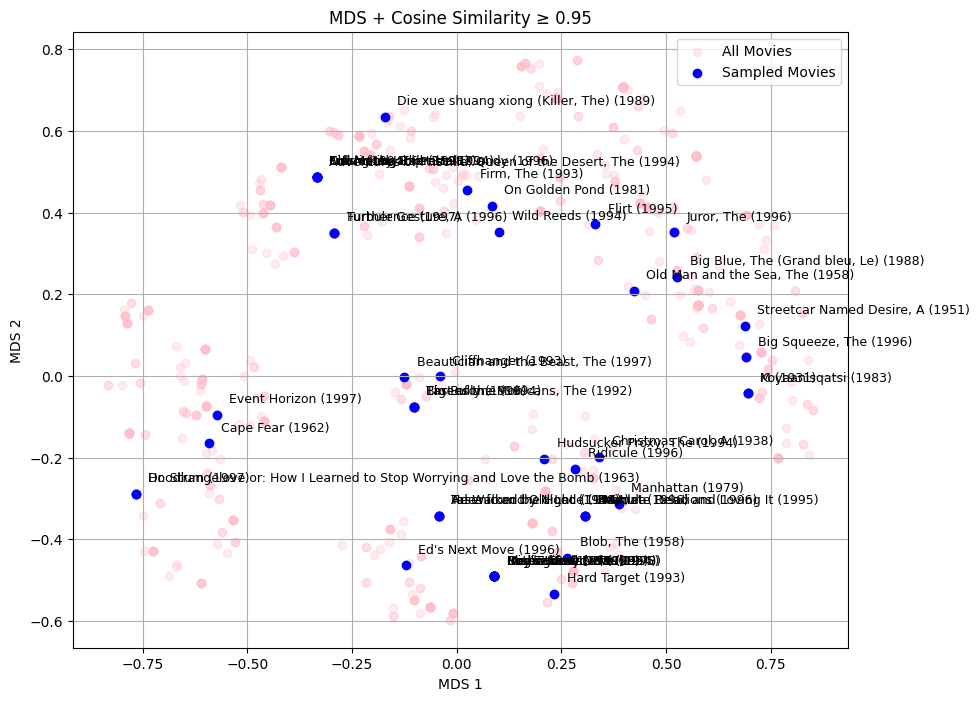

In [33]:
from sklearn.manifold import MDS

# 1. 元データの特徴量とコサイン類似度計算
X_all = df_item_X.values
cos_sim_all = cosine_similarity(X_all)
cos_dist_all = 1 - cos_sim_all  # MDSは距離ベースなので変換

# 2. MDSで2次元に変換
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=0)
X_all_2d = mds.fit_transform(cos_dist_all)

# 3. サンプル50件を抽出
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
titles = sampled_df["movie_title"].tolist()

# 4. サンプル座標とコサイン類似度（元空間で計算）
X_sample_2d = X_all_2d[sample_indices]
cos_sim_sample = cosine_similarity(df_item_X.iloc[sample_indices].values)

# 5. 複数のしきい値で可視化
thresholds = [0.7, 0.8, 0.9, 0.95]

for threshold in thresholds:
    plt.figure(figsize=(10, 8))

    # 全体（ピンク）
    plt.scatter(X_all_2d[:, 0], X_all_2d[:, 1], color='pink', alpha=0.3, label='All Movies')

    # サンプル（青）
    plt.scatter(X_sample_2d[:, 0], X_sample_2d[:, 1], color='blue', label='Sampled Movies')

    # 類似度に基づく線を引く
    for i in range(len(X_sample_2d)):
        for j in range(i + 1, len(X_sample_2d)):
            if cos_sim_sample[i, j] >= threshold:
                x1, y1 = X_sample_2d[i]
                x2, y2 = X_sample_2d[j]
                plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

    # タイトルの表示
    for i, (x, y) in enumerate(X_sample_2d):
        plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

    plt.title(f"MDS + Cosine Similarity ≥ {threshold}")
    plt.xlabel("MDS 1")
    plt.ylabel("MDS 2")
    plt.grid(True)
    plt.legend()
    plt.show()


In [34]:
pip install umap-learn


[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


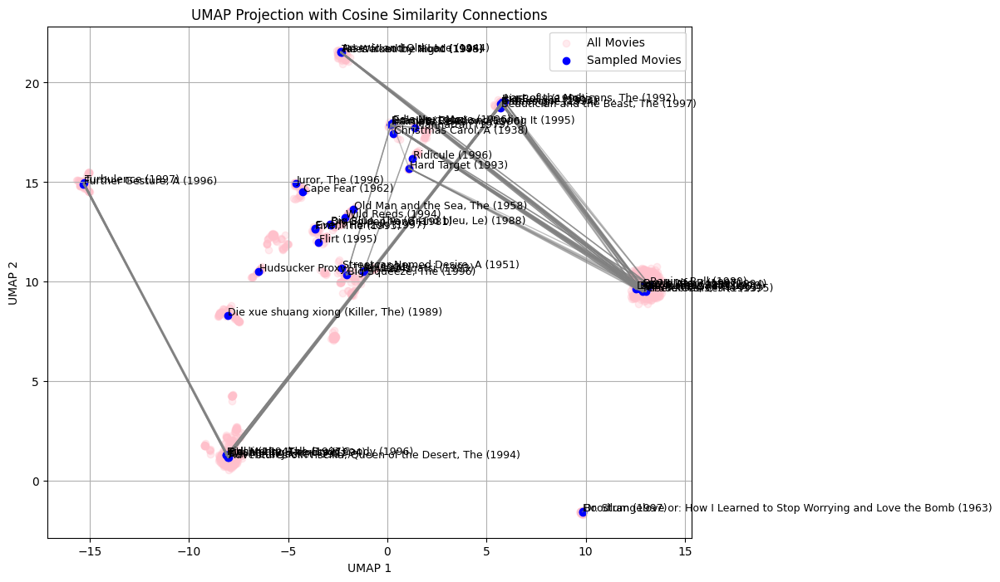

In [35]:
# UMAPで次元削減して線で繋ぐ

import umap.umap_ as umap

# 1. 特徴量（元データ）
X = df_item_X.values

# 2. サンプル抽出（例：50件）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
X_sample = df_item_X.iloc[sample_indices].values
titles = sampled_df["movie_title"].tolist()

# 3. UMAPで2次元に圧縮
reducer = umap.UMAP(n_components=2, random_state=42)
X_umap_all = reducer.fit_transform(X)  # 全体も可視化対象に含める
X_umap_sample = X_umap_all[sample_indices]

# 4. サンプル内のコサイン類似度を計算
cos_sim_sample = cosine_similarity(X_sample)

# 5. 散布図 + 類似度に基づく線描画
plt.figure(figsize=(10, 8))

# 全体をプロット（ピンク）
plt.scatter(X_umap_all[:, 0], X_umap_all[:, 1], color='pink', alpha=0.3, label='All Movies')

# サンプルをプロット（青）
plt.scatter(X_umap_sample[:, 0], X_umap_sample[:, 1], color='blue', label='Sampled Movies')

# 類似度が0.7以上のペアに線を引く
threshold = 0.7
for i in range(len(X_sample)):
    for j in range(i + 1, len(X_sample)):
        if cos_sim_sample[i, j] >= threshold:
            x1, y1 = X_umap_sample[i]
            x2, y2 = X_umap_sample[j]
            plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

# タイトル表示
for i, (x, y) in enumerate(X_umap_sample):
    plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

plt.title("UMAP Projection with Cosine Similarity Connections")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.legend()
plt.show()


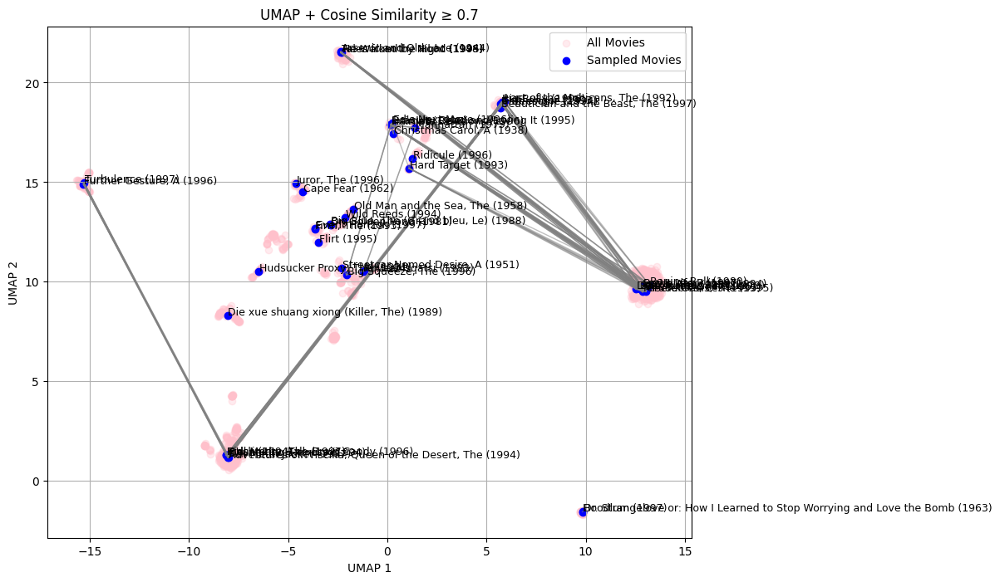

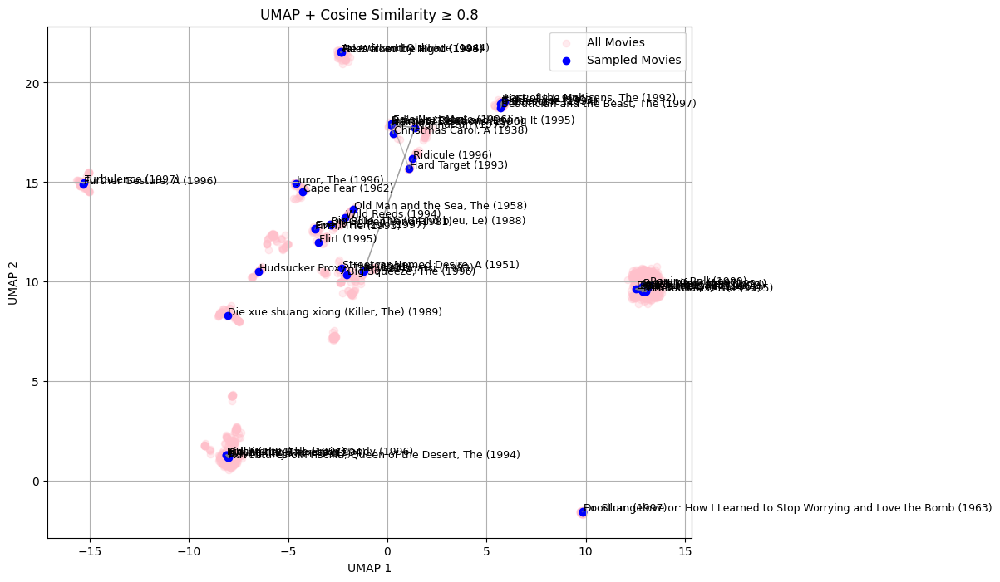

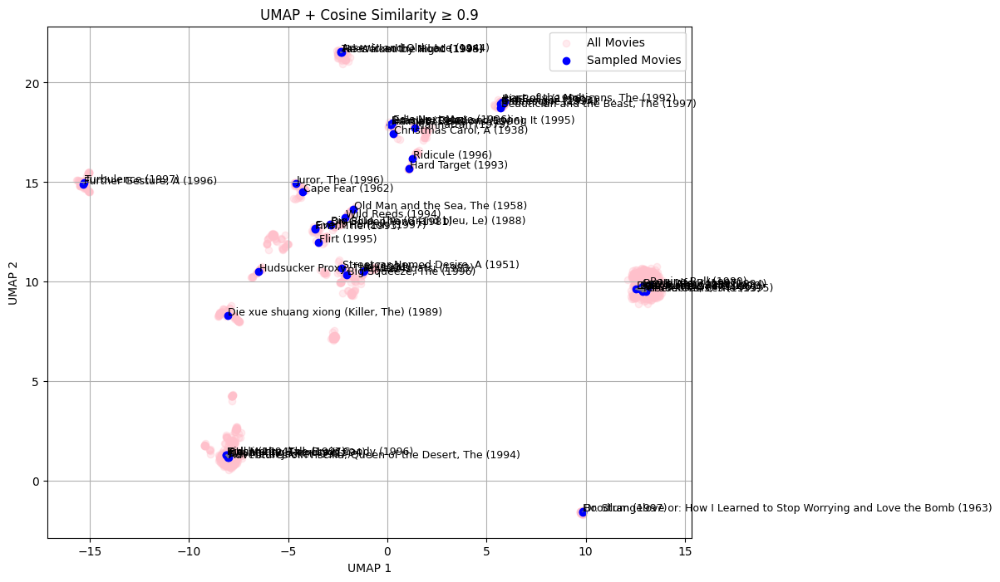

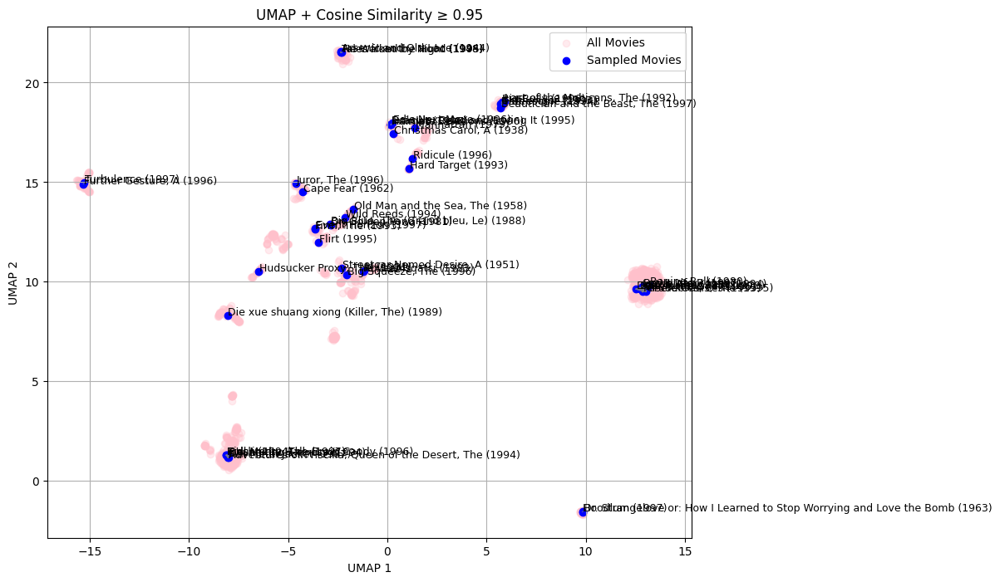

In [36]:
import umap.umap_ as umap

# 1. 特徴量（元データ）
X = df_item_X.values

# 2. サンプル抽出（例：50件）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
X_sample = df_item_X.iloc[sample_indices].values
titles = sampled_df["movie_title"].tolist()

# 3. UMAPで2次元に圧縮（全体も対象）
reducer = umap.UMAP(n_components=2, random_state=42)
X_umap_all = reducer.fit_transform(X)
X_umap_sample = X_umap_all[sample_indices]

# 4. サンプル間のcos類似度（元空間で計算）
cos_sim_sample = cosine_similarity(X_sample)

# 5. 各しきい値ごとに可視化
thresholds = [0.7, 0.8, 0.9, 0.95]

for threshold in thresholds:
    plt.figure(figsize=(10, 8))

    # 5.1 全体（ピンク）
    plt.scatter(X_umap_all[:, 0], X_umap_all[:, 1], color='pink', alpha=0.3, label='All Movies')

    # 5.2 サンプル（青）
    plt.scatter(X_umap_sample[:, 0], X_umap_sample[:, 1], color='blue', label='Sampled Movies')

    # 5.3 線を引く（元特徴量でのcos類似度に基づく）
    for i in range(len(X_sample)):
        for j in range(i + 1, len(X_sample)):
            if cos_sim_sample[i, j] >= threshold:
                x1, y1 = X_umap_sample[i]
                x2, y2 = X_umap_sample[j]
                plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

    # 5.4 タイトル表示
    for i, (x, y) in enumerate(X_umap_sample):
        plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

    plt.title(f"UMAP + Cosine Similarity ≥ {threshold}")
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")
    plt.grid(True)
    plt.legend()
    plt.show()


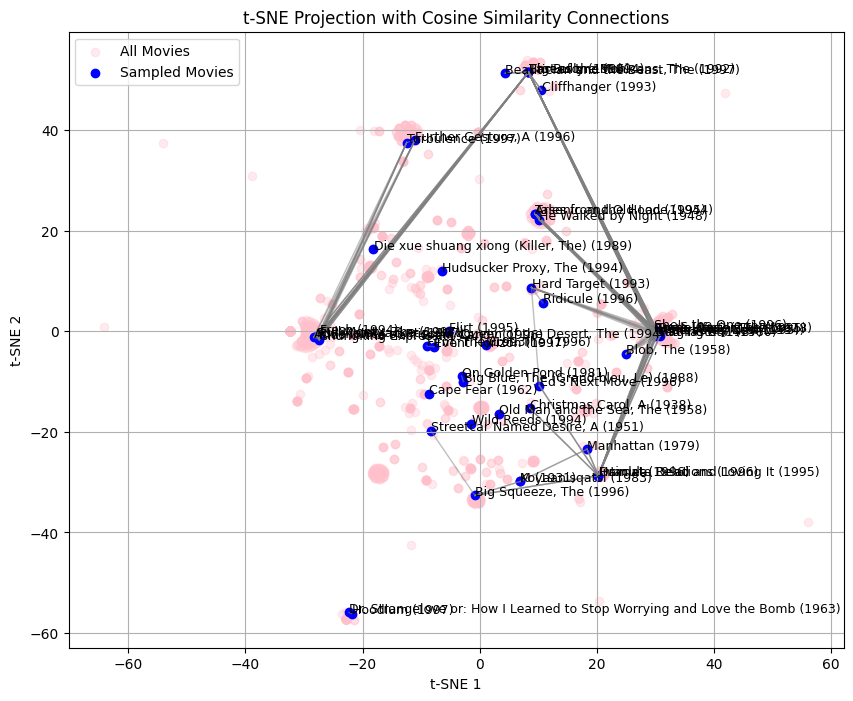

In [37]:
from sklearn.manifold import TSNE

# 1. 特徴量（元のデータ）
X = df_item_X.values

# 2. サンプル抽出（例：50件）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
X_sample = df_item_X.iloc[sample_indices].values
titles = sampled_df["movie_title"].tolist()

# 3. t-SNEで2次元に圧縮（全体を対象に）
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
X_tsne_all = tsne.fit_transform(X)

# 4. サンプルの座標と類似度
X_tsne_sample = X_tsne_all[sample_indices]
cos_sim_sample = cosine_similarity(X_sample)

# 5. 散布図 + 線描画
plt.figure(figsize=(10, 8))

# 全体（ピンク）
plt.scatter(X_tsne_all[:, 0], X_tsne_all[:, 1], color='pink', alpha=0.3, label='All Movies')

# サンプル（青）
plt.scatter(X_tsne_sample[:, 0], X_tsne_sample[:, 1], color='blue', label='Sampled Movies')

# コサイン類似度に基づく線（元の高次元空間で計算された値）
threshold = 0.7
for i in range(len(X_sample)):
    for j in range(i + 1, len(X_sample)):
        if cos_sim_sample[i, j] >= threshold:
            x1, y1 = X_tsne_sample[i]
            x2, y2 = X_tsne_sample[j]
            plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

# タイトル表示
for i, (x, y) in enumerate(X_tsne_sample):
    plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

plt.title("t-SNE Projection with Cosine Similarity Connections")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.grid(True)
plt.legend()
plt.show()


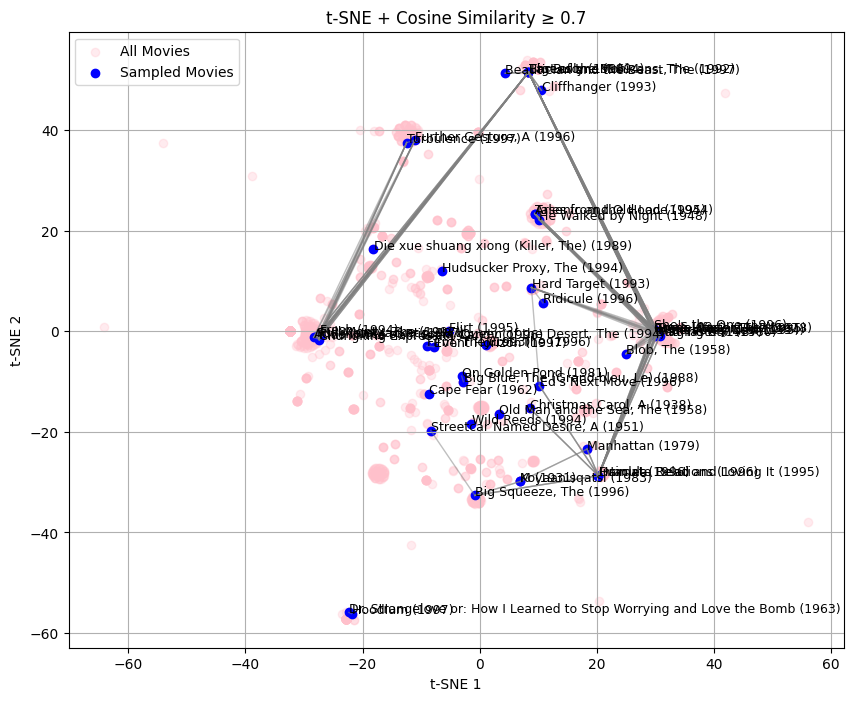

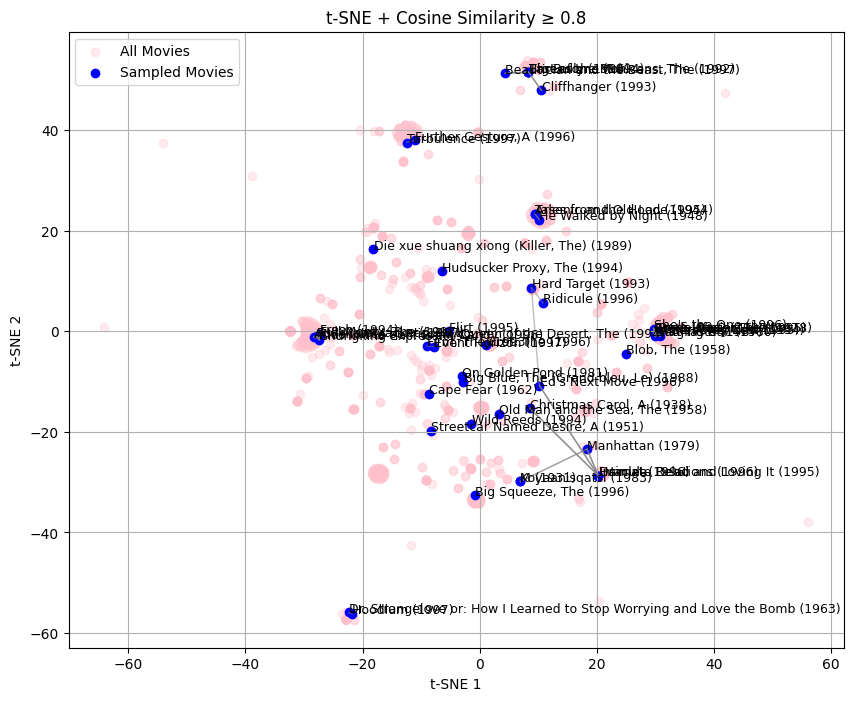

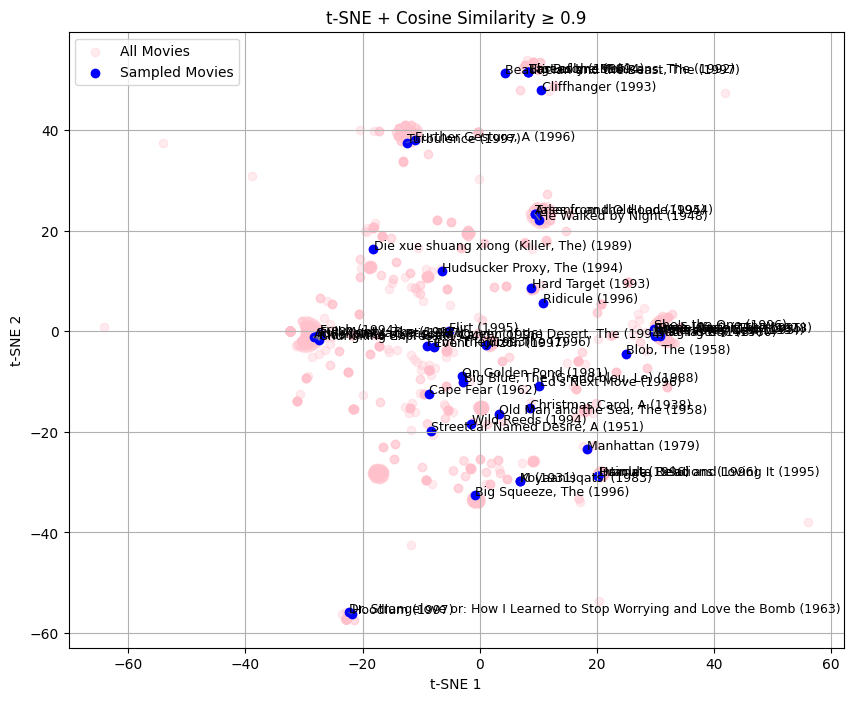

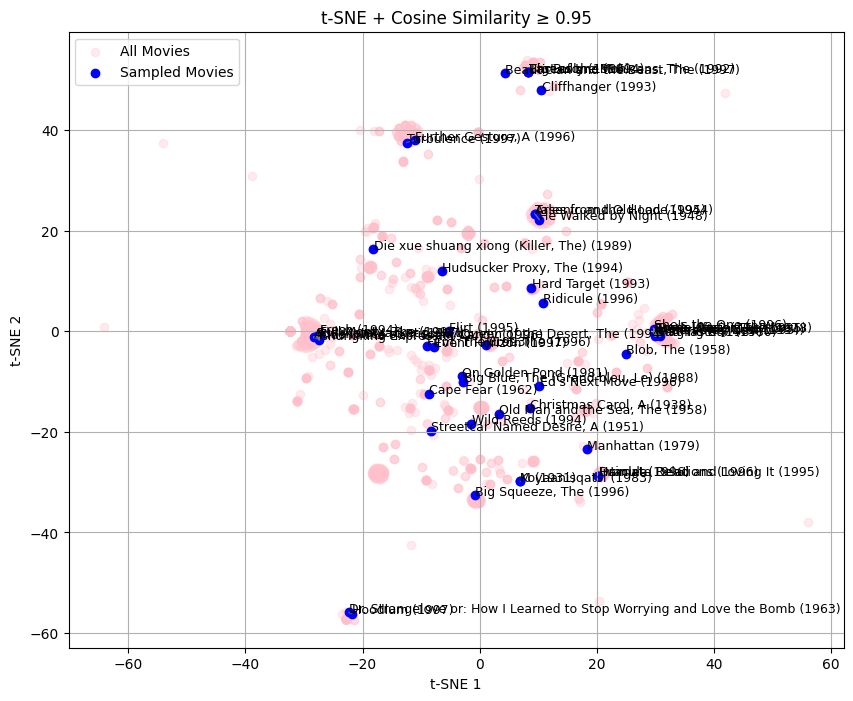

In [38]:
from sklearn.manifold import TSNE

# 1. 特徴量（元のデータ）
X = df_item_X.values

# 2. サンプル抽出（例：50件）
sampled_df = df_item.sample(50, random_state=0).reset_index(drop=True)
sample_indices = sampled_df.index.tolist()
X_sample = df_item_X.iloc[sample_indices].values
titles = sampled_df["movie_title"].tolist()

# 3. t-SNEで2次元に圧縮（全体）
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
X_tsne_all = tsne.fit_transform(X)
X_tsne_sample = X_tsne_all[sample_indices]

# 4. 類似度（元空間）を計算
cos_sim_sample = cosine_similarity(X_sample)

# 5. しきい値を変えて可視化
thresholds = [0.7, 0.8, 0.9, 0.95]

for threshold in thresholds:
    plt.figure(figsize=(10, 8))

    # 全体（ピンク）
    plt.scatter(X_tsne_all[:, 0], X_tsne_all[:, 1], color='pink', alpha=0.3, label='All Movies')

    # サンプル（青）
    plt.scatter(X_tsne_sample[:, 0], X_tsne_sample[:, 1], color='blue', label='Sampled Movies')

    # 類似度 ≥ threshold のペアに線を引く
    for i in range(len(X_sample)):
        for j in range(i + 1, len(X_sample)):
            if cos_sim_sample[i, j] >= threshold:
                x1, y1 = X_tsne_sample[i]
                x2, y2 = X_tsne_sample[j]
                plt.plot([x1, x2], [y1, y2], color='gray', linewidth=1, alpha=0.5)

    # タイトル表示
    for i, (x, y) in enumerate(X_tsne_sample):
        plt.text(x + 0.03, y + 0.03, titles[i], fontsize=9)

    plt.title(f"t-SNE + Cosine Similarity ≥ {threshold}")
    plt.xlabel("t-SNE 1")
    plt.ylabel("t-SNE 2")
    plt.grid(True)
    plt.legend()
    plt.show()


In [39]:
df_item_X.head()

,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


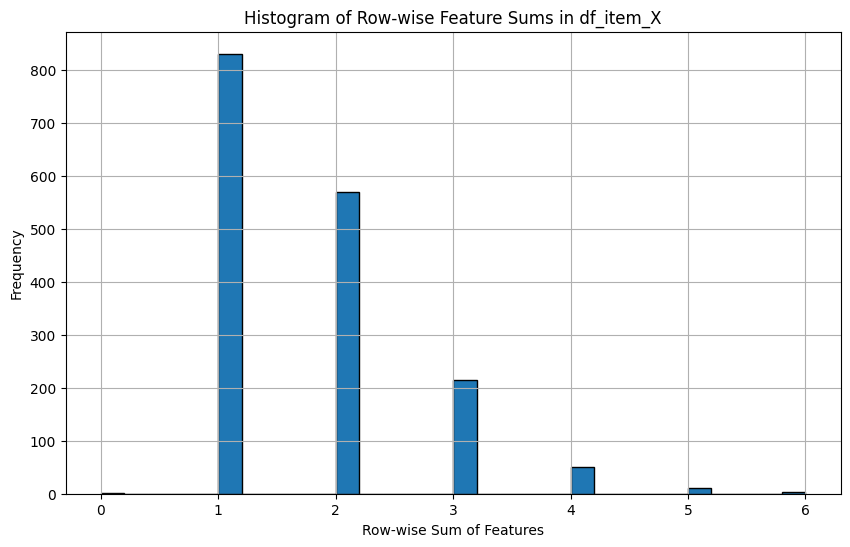

In [40]:
# 1. 行ごとの特徴量合計を計算
row_sums = df_item_X.sum(axis=1)

# 2. ヒストグラムを描画（x軸は合計の値）
plt.figure(figsize=(10, 6))
plt.hist(row_sums, bins=30, edgecolor='black')
plt.xlabel("Row-wise Sum of Features")
plt.ylabel("Frequency")
plt.title("Histogram of Row-wise Feature Sums in df_item_X")
plt.grid(True)
plt.show()


In [41]:
row_sums.head(10)

0    3
1    3
2    1
3    3
4    3
5    1
6    2
7    3
8    1
9    2
dtype: int64

In [42]:
cos_sim_matrix

array([[1.        , 0.        , 0.        , ..., 0.        , 0.57735027,
        0.        ],
       [0.        , 1.        , 0.57735027, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.57735027, 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.70710678],
       [0.57735027, 0.        , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.70710678, 0.        ,
        1.        ]])

In [43]:
# 元のデータのcos類似度を計算して降順に出力する

from sklearn.metrics.pairwise import cosine_similarity
import math

# 1. コサイン類似度の計算（全行ペア間）
cos_sim_matrix = cosine_similarity(df_item_X.values)

# 2. 類似度の上三角だけ抽出（自己比較や重複を除外）
n = cos_sim_matrix.shape[0]
similarities = []

for i in range(n):
    for j in range(i + 1, n):  # 上三角のみ
        similarities.append((i, j, cos_sim_matrix[i, j]))

# 3. 類似度を降順にソート
similarities_sorted = sorted(similarities, key=lambda x: x[2], reverse=True)

# 4. 上位をDataFrameとして表示（例：上位x件）
n = 1682
top_df = pd.DataFrame(similarities_sorted[:200000], columns=["Index 1", "Index 2", "Cosine Similarity"])
print("top_df shape: ", top_df.shape)
print("combination number is :", math.comb(n, 2))
top_df.tail(10)

top_df shape:  (200000, 3)
combination number is : 1413721


,Index 1,Index 2,Cosine Similarity
199990,636,1241,0.707107
199991,636,1242,0.707107
199992,636,1245,0.707107
199993,636,1248,0.707107
199994,636,1250,0.707107
199995,636,1253,0.707107
199996,636,1269,0.707107
199997,636,1270,0.707107
199998,636,1282,0.707107
199999,636,1286,0.707107


In [44]:
from sklearn.metrics.pairwise import cosine_similarity

# 類似度行列の計算（元の特徴量）
cos_sim_matrix = cosine_similarity(df_item_X.values)

# 映画タイトルリスト
titles = df_item["movie_title"].tolist()

# 結果格納用リスト
exact_matches = []

n = cos_sim_matrix.shape[0]

# 上三角のみ走査してcos=1.0のペアを抽出（自己比較除く）
for i in range(n):
    for j in range(i + 1, n):
        if np.isclose(cos_sim_matrix[i, j], 1.0):
            exact_matches.append((i, j, titles[i], titles[j]))

# データフレームに変換
df_exact = pd.DataFrame(exact_matches, columns=["Index 1", "Index 2", "Title 1", "Title 2"])
print("cos類似度が1.0のペアのみを出力する")
display(df_exact)


cos類似度が1.0のペアのみを出力する


,Index 1,Index 2,Title 1,Title 2
0,0,421,Toy Story (1995),Aladdin and the King of Thieves (1996)
1,1,116,GoldenEye (1995),"Rock, The (1996)"
2,1,117,GoldenEye (1995),Twister (1996)
3,1,565,GoldenEye (1995),Clear and Present Danger (1994)
4,1,826,GoldenEye (1995),Daylight (1996)
...,...,...,...,...
105400,1675,1677,"War at Home, The (1996)",Mat' i syn (1997)
105401,1675,1681,"War at Home, The (1996)",Scream of Stone (Schrei aus Stein) (1991)
105402,1676,1677,Sweet Nothing (1995),Mat' i syn (1997)
105403,1676,1681,Sweet Nothing (1995),Scream of Stone (Schrei aus Stein) (1991)


In [45]:
# cos類似度があっているかを確認するために，cos類似度が1.0だったペアのジャンルを目視で確認する

from sklearn.metrics.pairwise import cosine_similarity

# 1. 類似度行列の計算
cos_sim_matrix = cosine_similarity(df_item_X.values)

# 2. タイトルとジャンル列を取得
titles = df_item["movie_title"].tolist()
genre_columns = df_item.columns.difference(["movie_title"])  # ジャンル列を推定（例）

# 3. 結果格納
exact_matches = []

n = len(titles)
for i in range(n):
    for j in range(i + 1, n):
        if np.isclose(cos_sim_matrix[i, j], 1.0):
            genre_1 = df_item.loc[i, genre_columns]
            genre_2 = df_item.loc[j, genre_columns]
            genre_1_list = genre_1[genre_1 == 1].index.tolist()
            genre_2_list = genre_2[genre_2 == 1].index.tolist()
            exact_matches.append((i, j, titles[i], titles[j], genre_1_list, genre_2_list))

# 4. データフレームに変換
df_exact = pd.DataFrame(
    exact_matches,
    columns=["Index 1", "Index 2", "Title 1", "Title 2", "Genres 1", "Genres 2"]
)

# 5. 表示
print("cos類似度が1.0のペアとそのジャンル一覧：")
display(df_exact)


cos類似度が1.0のペアとそのジャンル一覧：


,Index 1,Index 2,Title 1,Title 2,Genres 1,Genres 2
0,0,421,Toy Story (1995),Aladdin and the King of Thieves (1996),"[Animation, Children's, Comedy, movie_id]","[Animation, Children's, Comedy]"
1,1,116,GoldenEye (1995),"Rock, The (1996)","[Action, Adventure, Thriller]","[Action, Adventure, Thriller]"
2,1,117,GoldenEye (1995),Twister (1996),"[Action, Adventure, Thriller]","[Action, Adventure, Thriller]"
3,1,565,GoldenEye (1995),Clear and Present Danger (1994),"[Action, Adventure, Thriller]","[Action, Adventure, Thriller]"
4,1,826,GoldenEye (1995),Daylight (1996),"[Action, Adventure, Thriller]","[Action, Adventure, Thriller]"
...,...,...,...,...,...,...
105400,1675,1677,"War at Home, The (1996)",Mat' i syn (1997),[Drama],[Drama]
105401,1675,1681,"War at Home, The (1996)",Scream of Stone (Schrei aus Stein) (1991),[Drama],[Drama]
105402,1676,1677,Sweet Nothing (1995),Mat' i syn (1997),[Drama],[Drama]
105403,1676,1681,Sweet Nothing (1995),Scream of Stone (Schrei aus Stein) (1991),[Drama],[Drama]


In [46]:
# 映画のジャンルとネット検索でジャケット画像を確認して合ってることを目視で確認した．

In [47]:
df_item.head()

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


In [48]:
"""
PCA -> 映画同士で似た構造を持っているため似た広がりを持っているデータがある(4グループ)
cos類似度の結果とPCA, MDS, UMAPの結果は異なるのでは？(cos類似度は数値的解釈, 次元削減は幾何的解釈)
k-means -> クラスタリングを行って適切なグループ数を求める

"""

'\nPCA -> 映画同士で似た構造を持っているため似た広がりを持っているデータがある(4グループ)\ncos類似度の結果とPCA, MDS, UMAPの結果は異なるのでは？(cos類似度は数値的解釈, 次元削減は幾何的解釈)\nk-means -> クラスタリングを行って適切なグループ数を求める\n\n'

# k-means

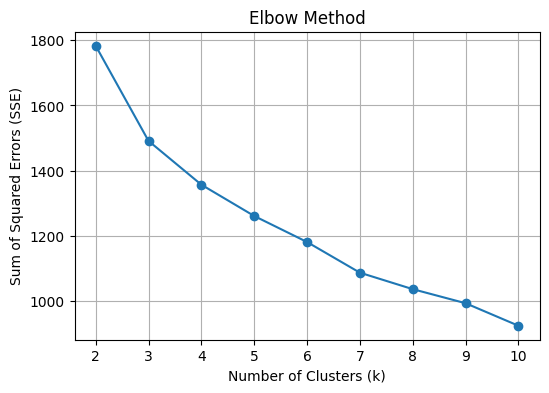

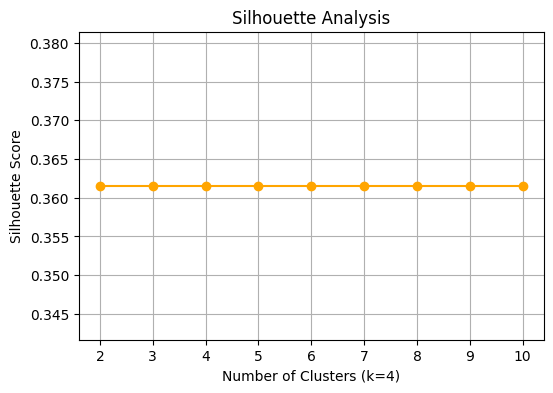

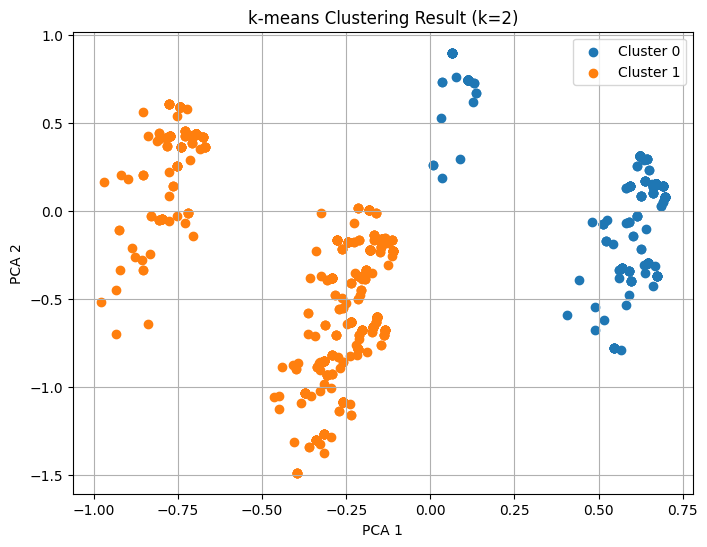

In [49]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# 特徴量
X = df_item_X.values

# -------------------------------
# 1. PCAで2次元に圧縮して可視化用
# -------------------------------
pca = PCA(n_components=2, random_state=0)
X_pca = pca.fit_transform(X)

# -------------------------------
# 2. Elbow法：SSE（inertia_）で評価
# -------------------------------
sse = []
k_range = range(2, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=0, n_init=10)
    kmeans.fit(X)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(6, 4))
plt.plot(k_range, sse, marker='o')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Sum of Squared Errors (SSE)")
plt.title("Elbow Method")
plt.grid(True)
plt.show()

# -------------------------------
# 3. シルエットスコア（k=2〜10）
# -------------------------------
silhouette_scores = []

for k in k_range:
    kmeans = KMeans(n_clusters=4, random_state=0, n_init=150)
    labels = kmeans.fit_predict(X)
    score = silhouette_score(X, labels)
    silhouette_scores.append(score)

plt.figure(figsize=(6, 4))
plt.plot(k_range, silhouette_scores, marker='o', color='orange')
plt.xlabel("Number of Clusters (k=4)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Analysis")
plt.grid(True)
plt.show()

# -------------------------------
# 4. k=推奨数でクラスタリング結果を2次元プロット
# （例として silhouette スコア最大の k を採用）
# -------------------------------
best_k = k_range[silhouette_scores.index(max(silhouette_scores))]
kmeans = KMeans(n_clusters=best_k, random_state=0, n_init=150)
cluster_labels = kmeans.fit_predict(X)

plt.figure(figsize=(8, 6))
for i in range(best_k):
    plt.scatter(X_pca[cluster_labels == i, 0],
                X_pca[cluster_labels == i, 1],
                label=f"Cluster {i}")
plt.title(f"k-means Clustering Result (k={best_k})")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.legend()
plt.grid(True)
plt.show()


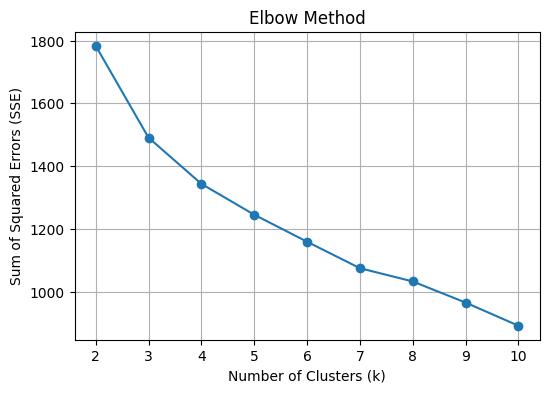

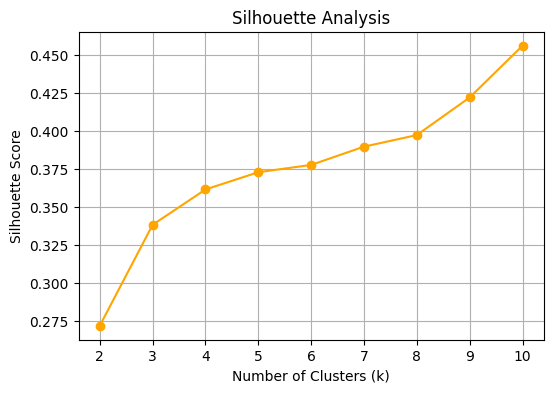

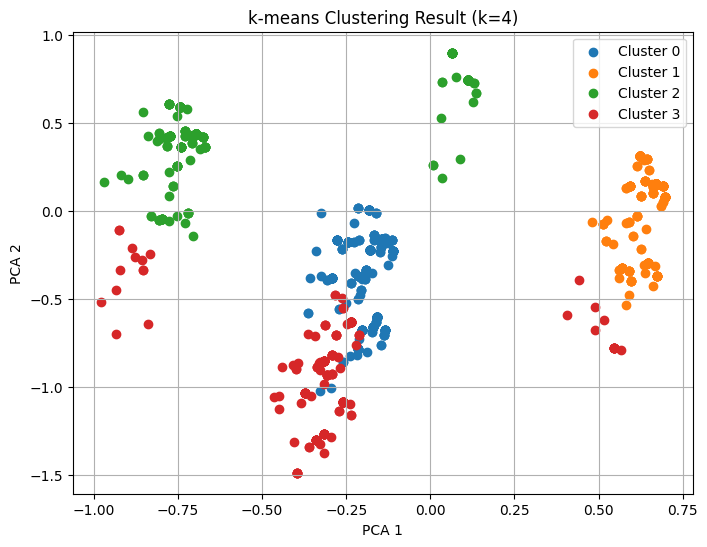

In [50]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

# 特徴量
X = df_item_X.values

# -------------------------------
# 1. PCAで2次元に圧縮して可視化用
# -------------------------------
pca = PCA(n_components=2, random_state=0)
X_pca = pca.fit_transform(X)

# -------------------------------
# 2. Elbow法：SSE（inertia_）で評価
# -------------------------------
sse = []
k_range = range(2, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=96, n_init=150)
    kmeans.fit(X)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(6, 4))
plt.plot(k_range, sse, marker='o')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Sum of Squared Errors (SSE)")
plt.title("Elbow Method")
plt.grid(True)
plt.show()

# -------------------------------
# 3. シルエットスコア（k=2〜10）
# -------------------------------
silhouette_scores = []

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=96, n_init=150)
    labels = kmeans.fit_predict(X)
    score = silhouette_score(X, labels)
    silhouette_scores.append(score)

plt.figure(figsize=(6, 4))
plt.plot(k_range, silhouette_scores, marker='o', color='orange')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Analysis")
plt.grid(True)
plt.show()

# -------------------------------
# 4. k=推奨数でクラスタリング結果を2次元プロット
# （k=4の時を採用）
# -------------------------------
k = 4
kmeans = KMeans(n_clusters=k, init='k-means++', random_state=96, n_init=300)
cluster_labels = kmeans.fit_predict(X)

plt.figure(figsize=(8, 6))
for i in range(k):
    plt.scatter(X_pca[cluster_labels == i, 0],
                X_pca[cluster_labels == i, 1],
                label=f"Cluster {i}")
plt.title("k-means Clustering Result (k=4)")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.legend()
plt.grid(True)
plt.show()


In [51]:
help(kmeans)

Help on KMeans in module sklearn.cluster._kmeans object:

class KMeans(_BaseKMeans)
 |  KMeans(n_clusters=8, *, init='k-means++', n_init='auto', max_iter=300, tol=0.0001, verbose=0, random_state=None, copy_x=True, algorithm='lloyd')
 |  
 |  K-Means clustering.
 |  
 |  Read more in the :ref:`User Guide <k_means>`.
 |  
 |  Parameters
 |  ----------
 |  
 |  n_clusters : int, default=8
 |      The number of clusters to form as well as the number of
 |      centroids to generate.
 |  
 |      For an example of how to choose an optimal value for `n_clusters` refer to
 |      :ref:`sphx_glr_auto_examples_cluster_plot_kmeans_silhouette_analysis.py`.
 |  
 |  init : {'k-means++', 'random'}, callable or array-like of shape             (n_clusters, n_features), default='k-means++'
 |      Method for initialization:
 |  
 |      * 'k-means++' : selects initial cluster centroids using sampling             based on an empirical probability distribution of the points'             contribution to 

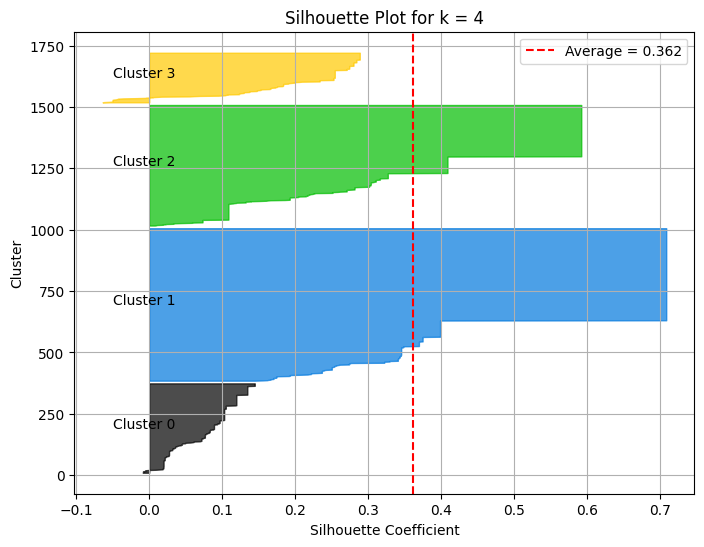

In [53]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# 特徴量
X = df_item_X.values
k = 4

# k-means クラスタリング
kmeans = KMeans(n_clusters=k, random_state=0, n_init=150)
cluster_labels = kmeans.fit_predict(X)

# 各サンプルのシルエットスコアを計算
silhouette_vals = silhouette_samples(X, cluster_labels)
avg_score = silhouette_score(X, cluster_labels)

# シルエット分析プロット
plt.figure(figsize=(8, 6))
y_lower = 10  # 棒の開始位置

for i in range(k):
    # クラスタiのシルエット値を抽出し、並び替え
    ith_cluster_sil_vals = silhouette_vals[cluster_labels == i]
    ith_cluster_sil_vals.sort()

    size_cluster_i = ith_cluster_sil_vals.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / k)
    plt.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_sil_vals,
                      facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, f'Cluster {i}')
    y_lower = y_upper + 10

# 平均スコアの線
plt.axvline(avg_score, color="red", linestyle="--", label=f"Average = {avg_score:.3f}")
plt.xlabel("Silhouette Coefficient")
plt.ylabel("Cluster")
plt.title(f"Silhouette Plot for k = {k}")
plt.legend()
plt.grid(True)
plt.show()


# u.dataのEDA

カラム名: 'user_id', 'item_id', 'rating', 'timestamp'

- 各特徴量の意味に関して(特にtimestampは何を示すか) -> 1970年1月1日 00:00:00（UTC）からの経過秒数を示す．
- 各user_idがどの程度作品を見ているかの確認(一人でめっちゃ観てるやつがいないかとか，一人当たりの視聴本数など) -> 943人が観ている, 最も多い人で737本観ている．累積棒グラフの作成(425人くらいで8割(8万行分)に達する)
- 作品のランキング -> 実施した
- 各Genreごとにratingの下限を下回っている割合の可視化 -> 実施した(Fantasyは最も地雷率が高く，Crimeは最も地雷率が低い)
- rating上位作品のジャンル -> Film-Noir(3.548351), War(3.489185), Musical(3.376423)などの順
- Genreごとの関係性 -> 実施した(共起行列(1, 0で共起していれば数値が上昇する)とcos類似度で高い関係性は見られなかった)
- user同士の関係性(cos類似度, クラスタリング) -> 共起行列とcos類似度を用いてヒートマップで可視化した．k-meansでクラスタリング(エルボ法とシルエット分析)したが適切な分類はできなかった．UMAP, t-SNE(+k-means)を行ったが傾向はなし．
- ratingに関して(各userはどのようなratingの付け方をしているか) -> 甘口(28.7%), 辛口(18.6%)だった．
- +α(timestampから年齢を推測してみる)

In [54]:
from datetime import datetime

# カラム名がない場合は追加（u.data 読み込み想定）
# df = pd.read_csv("u.data", sep="\t", names=["user_id", "movie_id", "rating", "timestamp"])

# timestamp を datetime に変換して、日本語形式の文字列に
df_data["timestamp_jap"] = df_data["timestamp"].apply(
    lambda ts: datetime.fromtimestamp(ts).strftime("%Y年%m月%d日 %H時%M分%S秒")
)

print("df_data shape: ", df_data.shape)
df_data.head()


df_data shape:  (100000, 5)


,user_id,item_id,rating,timestamp,timestamp_jap
0,196,242,3,881250949,1997年12月05日 00時55分49秒
1,186,302,3,891717742,1998年04月05日 04時22分22秒
2,22,377,1,878887116,1997年11月07日 16時18分36秒
3,244,51,2,880606923,1997年11月27日 14時02分03秒
4,166,346,1,886397596,1998年02月02日 14時33分16秒


In [55]:
# 各 user_id ごとの視聴件数（=行数）をカウント
user_view_counts = df_data.groupby("user_id")["item_id"].count().reset_index()

# カラム名変更（わかりやすく）
user_view_counts.columns = ["user_id", "view_count"]

# 降順に並び替え
user_view_counts = user_view_counts.sort_values(by="view_count", ascending=False)

print("user_view_counts shape: ", user_view_counts.shape)
print("映画を観ている人は", user_view_counts.shape[0], "人です")

# 上位を表示
display(user_view_counts.head())


user_view_counts shape:  (943, 2)
映画を観ている人は 943 人です


,user_id,view_count
404,405,737
654,655,685
12,13,636
449,450,540
275,276,518


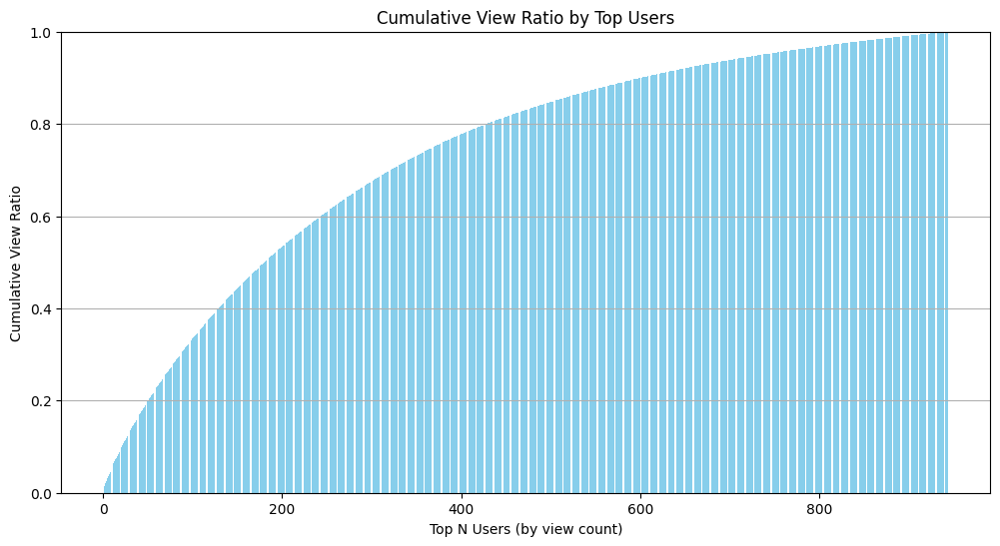

In [56]:
# 累積棒グラフの描画

# ユーザーごとの視聴件数（=評価数）を降順にソート
user_view_counts = df_data.groupby("user_id")["item_id"].count().sort_values(ascending=False).reset_index()
user_view_counts.columns = ["user_id", "view_count"]

# 累積視聴数と割合
user_view_counts["cumsum"] = user_view_counts["view_count"].cumsum()
total_views = user_view_counts["view_count"].sum()
user_view_counts["cumsum_ratio"] = user_view_counts["cumsum"] / total_views

# 可視化：上位nユーザーの累積割合（例：上位100人）
n = 943
plt.figure(figsize=(12, 6))
plt.bar(range(1, n + 1), user_view_counts["cumsum_ratio"].iloc[:n], color='skyblue')

plt.xlabel("Top N Users (by view count)")
plt.ylabel("Cumulative View Ratio")
plt.title("Cumulative View Ratio by Top Users")
plt.ylim(0, 1)
plt.grid(axis='y')
plt.show()


In [57]:
# 映画（item_id）ごとの視聴回数をカウント
movie_view_counts = df_data.groupby("item_id")["user_id"].count().reset_index()
movie_view_counts.columns = ["item_id", "view_count"]

# 降順にソート
movie_view_counts = movie_view_counts.sort_values(by="view_count", ascending=False)

# 上位表示
display(movie_view_counts.head())


,item_id,view_count
49,50,583
257,258,509
99,100,508
180,181,507
293,294,485


In [58]:
pd.set_option('display.max_rows', 300)
movie_view_counts_sorted = movie_view_counts.sort_values(by="view_count", ascending=False)
movie_view_counts_sorted.head(300)

,item_id,view_count
49,50,583
257,258,509
99,100,508
180,181,507
293,294,485
285,286,481
287,288,478
0,1,452
299,300,431
120,121,429


In [59]:
df_data.head()

,user_id,item_id,rating,timestamp,timestamp_jap
0,196,242,3,881250949,1997年12月05日 00時55分49秒
1,186,302,3,891717742,1998年04月05日 04時22分22秒
2,22,377,1,878887116,1997年11月07日 16時18分36秒
3,244,51,2,880606923,1997年11月27日 14時02分03秒
4,166,346,1,886397596,1998年02月02日 14時33分16秒


# u.dataとu.itemの結合データ

In [60]:
df_item.head()

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0


In [61]:
movie_info

NameError: name 'movie_info' is not defined

In [62]:
movie_view_counts

,item_id,view_count
49,50,583
257,258,509
99,100,508
180,181,507
293,294,485
...,...,...
1575,1576,1
1576,1577,1
1347,1348,1
1578,1579,1


In [63]:
movie_views_with_info

NameError: name 'movie_views_with_info' is not defined

In [64]:
# item_idだけだとわかりにくいので、映画タイトルを結合してジャンルも一緒に表示

# 1. 映画ごとの評価数を集計
movie_view_counts = df_data.groupby("item_id")["user_id"].count().reset_index()
movie_view_counts.columns = ["movie_id", "view_count"]

# 2. タイトル・ジャンル付きの映画データと結合
movie_info = df_item.copy()  # df_item は "movie_id", "movie_title", ジャンル列を含むとする
movie_views_with_info = pd.merge(movie_view_counts, movie_info, on="movie_id", how="left")

# 3. 降順に並び替え（視聴回数の多い順）
movie_views_with_info = movie_views_with_info.sort_values(by="view_count", ascending=False)

# 4. 表示（タイトル・ジャンル・視聴数）
# → ジャンル列の例：Action, Comedy, Drama ... が 1 or 0 で one-hot 形式
genre_cols = [col for col in df_item.columns if col not in ["item_id", "movie_title"]]

print("movie_views_with_info shape: ", movie_views_with_info.shape)
movie_views_with_info.head()
# 表示列を指定
# 下の2行を加えることで，unknown列が合計4列になる． -> 
# display_cols = ["movie_title", "view_count"] + genre_cols
# display(movie_views_with_info[display_cols].head(10))


movie_views_with_info shape:  (1682, 25)


,movie_id,view_count,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
49,50,583,Star Wars (1977),01-Jan-1977,NaN,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
257,258,509,Contact (1997),11-Jul-1997,NaN,http://us.imdb.com/Title?Contact+(1997/I),0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
99,100,508,Fargo (1996),14-Feb-1997,NaN,http://us.imdb.com/M/title-exact?Fargo%20(1996),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
180,181,507,Return of the Jedi (1983),14-Mar-1997,NaN,http://us.imdb.com/M/title-exact?Return%20of%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
293,294,485,Liar Liar (1997),21-Mar-1997,NaN,http://us.imdb.com/Title?Liar+Liar+(1997),0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [65]:
print(movie_views_with_info.columns)
print(re_movie_views_with_info.columns)

Index(['movie_id', 'view_count', 'movie_title', 'release_date', 'unknown',
       'url', 'unknown', 'Action', 'Adventure', 'Animation', 'Children's',
       'Comedy', 'Crime', 'Documentary', 'Drama', 'Fantasy', 'Film-Noir',
       'Horror', 'Musical', 'Mystery', 'Romance', 'Sci-Fi', 'Thriller', 'War',
       'Western'],
      dtype='object')


NameError: name 're_movie_views_with_info' is not defined

In [66]:
print("movie_views_with_info shape: ", movie_views_with_info.shape)
print("re_movie_views_with_info shape: ", re_movie_views_with_info.shape)

movie_views_with_info shape:  (1682, 25)


NameError: name 're_movie_views_with_info' is not defined

In [67]:
genre_cols

['movie_id',
 'release_date',
 'unknown',
 'url',
 'unknown',
 'Action',
 'Adventure',
 'Animation',
 "Children's",
 'Comedy',
 'Crime',
 'Documentary',
 'Drama',
 'Fantasy',
 'Film-Noir',
 'Horror',
 'Musical',
 'Mystery',
 'Romance',
 'Sci-Fi',
 'Thriller',
 'War',
 'Western']

In [68]:
# 削除しても良いカラムかの確認

# -----------------------------------------------
# unknown が 4 本あるうち「先頭 1 本」だけ欠損数を数える
# -----------------------------------------------
import numpy as np

# ① unknown 列だけを抽出（4 本ある）
unk_df = df_item.filter(regex=r'^unknown$')     # ラベルが完全一致する列を取得

# ② 先頭列（0 番目）を Series として取り出す
unk_first = unk_df.iloc[:, 0]                   # ここが「最初の unknown」
unk_second = unk_df.iloc[:, 1]                  # ここが「2 番目の unknown」
# unk_third = unk_df.iloc[:, 2]                   # ここが「3 番目の unknown」
# unk_fourth = unk_df.iloc[:, 3]                  # ここが「4 番目の unknown」

# ③ 文字列 "NAN" を本物の欠損値に変換
unk_first = unk_first.replace("NAN", np.nan)

# ③' 0の個数をカウント
zero_count = (unk_second == 0).sum()
# unk_unk_third = unk_third.replace("NAN", np.nan)

# ④ 欠損値 (np.nan) の個数をカウント
nan_first_count = unk_first.isna().sum()
nan_second_count = unk_second.isnull().sum()
# nan_third_count = unk_third.isna().sum()
# nan_fourth_count = unk_fourth.isna().sum()

print("1番目のunknownの欠損値数:", nan_first_count)
print("2番目のunknownの欠損値数:", zero_count)
# print("3番目のunknown（先頭列）の欠損値数:", nan_third_count)
# print("4番目のunknown（先頭列）の欠損値数:", nan_fourth_count)



1番目のunknownの欠損値数: 1682
2番目のunknownの欠損値数: 1680


In [69]:
# 1番目のunknownは全てNANで情報を持っていないから削除する
# 削除したい列以外を新しいデータフレームに追加する

# 除外したい列の番号（0始まり）
col_drop_number = 4

# 全列インデックスから、除外対象をのぞいたリストを作成
col_indices = [i for i in range(movie_views_with_info.shape[1]) if i != col_drop_number]

# iloc を使って、列番号ベースで必要な列だけ選んで新しいデータフレームを作成
re_movie_views_with_info = movie_views_with_info.iloc[:, col_indices]

# 結果確認
print(f"新しい DataFrame を作成（除外した列番号: {col_drop_number} → '{movie_views_with_info.columns[col_drop_number]}'）")
print("re_movie_views_with_info shape:", re_movie_views_with_info.shape)
re_movie_views_with_info.head()


新しい DataFrame を作成（除外した列番号: 4 → 'unknown'）
re_movie_views_with_info shape: (1682, 24)


,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
49,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
257,258,509,Contact (1997),11-Jul-1997,http://us.imdb.com/Title?Contact+(1997/I),0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
99,100,508,Fargo (1996),14-Feb-1997,http://us.imdb.com/M/title-exact?Fargo%20(1996),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
180,181,507,Return of the Jedi (1983),14-Mar-1997,http://us.imdb.com/M/title-exact?Return%20of%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
293,294,485,Liar Liar (1997),21-Mar-1997,http://us.imdb.com/Title?Liar+Liar+(1997),0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [70]:
col_indices

[0,
 1,
 2,
 3,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24]

In [71]:
re_movie_views_with_info.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1682 entries, 49 to 1681
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   movie_id      1682 non-null   int64 
 1   view_count    1682 non-null   int64 
 2   movie_title   1682 non-null   object
 3   release_date  1681 non-null   object
 4   url           1679 non-null   object
 5   unknown       1682 non-null   int64 
 6   Action        1682 non-null   int64 
 7   Adventure     1682 non-null   int64 
 8   Animation     1682 non-null   int64 
 9   Children's    1682 non-null   int64 
 10  Comedy        1682 non-null   int64 
 11  Crime         1682 non-null   int64 
 12  Documentary   1682 non-null   int64 
 13  Drama         1682 non-null   int64 
 14  Fantasy       1682 non-null   int64 
 15  Film-Noir     1682 non-null   int64 
 16  Horror        1682 non-null   int64 
 17  Musical       1682 non-null   int64 
 18  Mystery       1682 non-null   int64 
 19  Romance   

In [72]:
# 1 でも "1" でもない行の件数を数える
count_not_1 = ((re_movie_views_with_info["unknown"] != 1) & (re_movie_views_with_info["unknown"] != "1")).sum()

print(f"unknown 列が 1 でない行数: {count_not_1}")


unknown 列が 1 でない行数: 1680


In [73]:
# unknown列が1の行をフィルタ（数値の1または文字列"1"に対応）
mask = (re_movie_views_with_info["unknown"] == 1)

# 条件を満たす行だけ抽出
unknown_movies = re_movie_views_with_info.loc[mask, "movie_title"]

# 結果を表示（インデックス非表示、すっきり見せる）
print("unknownジャンル (==1) の映画タイトル一覧：")
print(unknown_movies.to_string(index=False))

# -> 映画のタイトルがわからない作品がある

unknownジャンル (==1) の映画タイトル一覧：
            unknown
Good Morning (1971)


In [74]:
# unknown列のユニークな値とその件数を表示
print("《unknown列のユニークな値と件数》")
print(re_movie_views_with_info["unknown"].value_counts(dropna=False))

《unknown列のユニークな値と件数》
unknown
0    1680
1       2
Name: count, dtype: int64


In [75]:
print("df_data shape: ", df_data.shape)
df_data.head()

df_data shape:  (100000, 5)


,user_id,item_id,rating,timestamp,timestamp_jap
0,196,242,3,881250949,1997年12月05日 00時55分49秒
1,186,302,3,891717742,1998年04月05日 04時22分22秒
2,22,377,1,878887116,1997年11月07日 16時18分36秒
3,244,51,2,880606923,1997年11月27日 14時02分03秒
4,166,346,1,886397596,1998年02月02日 14時33分16秒


In [76]:
print(re_movie_views_with_info.columns)
re_movie_views_with_info.head()

# 方針: re_movie_views_with_infoにはraingがないので，ratingを追加する
# 1. df_dataの"item_id"とre_movie_views_with_infoの"movie_id"が同じかを確認する

Index(['movie_id', 'view_count', 'movie_title', 'release_date', 'url',
       'unknown', 'Action', 'Adventure', 'Animation', 'Children's', 'Comedy',
       'Crime', 'Documentary', 'Drama', 'Fantasy', 'Film-Noir', 'Horror',
       'Musical', 'Mystery', 'Romance', 'Sci-Fi', 'Thriller', 'War',
       'Western'],
      dtype='object')


,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
49,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
257,258,509,Contact (1997),11-Jul-1997,http://us.imdb.com/Title?Contact+(1997/I),0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
99,100,508,Fargo (1996),14-Feb-1997,http://us.imdb.com/M/title-exact?Fargo%20(1996),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
180,181,507,Return of the Jedi (1983),14-Mar-1997,http://us.imdb.com/M/title-exact?Return%20of%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0
293,294,485,Liar Liar (1997),21-Mar-1997,http://us.imdb.com/Title?Liar+Liar+(1997),0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [77]:
# ① re_movie_views_with_info の movie_id の重複を確認
dup_movie_ids = re_movie_views_with_info["movie_id"].duplicated().sum()
print(f"re_movie_views_with_info で重複する movie_id の数: {dup_movie_ids}")

# ② df_data の item_id の重複を確認
dup_item_ids = df_data["item_id"].duplicated().sum()
print(f"df_data で重複する item_id の数: {dup_item_ids}")

# -> df_dataのitem_idは重複しているから，平均raitingを求めてre_movie_views_with_infoに結合する

re_movie_views_with_info で重複する movie_id の数: 0
df_data で重複する item_id の数: 98318


In [78]:
# movie_id に存在するが、item_id には存在しないID
only_in_movie = set(re_movie_views_with_info["movie_id"]) - set(df_data["item_id"])
print(f"movie_id にあって item_id にない ID の数: {len(only_in_movie)}")

# item_id に存在するが、movie_id には存在しないID
only_in_item = set(df_data["item_id"]) - set(re_movie_views_with_info["movie_id"])
print(f"item_id にあって movie_id にない ID の数: {len(only_in_item)}")

# -> item_id にあって movie_id にない ID の数は 0 だったので，結合しても問題ない

movie_id にあって item_id にない ID の数: 0
item_id にあって movie_id にない ID の数: 0


In [79]:
# df_itemは一つの映画に対して複数の評価を行っているため，平均ratingを求めて，re_movie_views_with_infoに結合する

movie_avg_rating = (
    df_data.groupby("item_id")["rating"]
    .mean()
    .reset_index()
    .rename(columns={"item_id": "movie_id", "rating": "avg_rating"})
)

# movie_id をキーに結合（左側は映画情報、右側は平均評価）
re_movie_views_with_info = pd.merge(
    re_movie_views_with_info,
    movie_avg_rating,
    on="movie_id",
    how="left"  # 映画情報はすべて保持
)

print("re_movie_views_with_info shape: ", re_movie_views_with_info.shape)
re_movie_views_with_info.head()

re_movie_views_with_info shape:  (1682, 25)


,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491
1,258,509,Contact (1997),11-Jul-1997,http://us.imdb.com/Title?Contact+(1997/I),0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,3.803536
2,100,508,Fargo (1996),14-Feb-1997,http://us.imdb.com/M/title-exact?Fargo%20(1996),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,4.155512
3,181,507,Return of the Jedi (1983),14-Mar-1997,http://us.imdb.com/M/title-exact?Return%20of%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.007890
4,294,485,Liar Liar (1997),21-Mar-1997,http://us.imdb.com/Title?Liar+Liar+(1997),0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,3.156701


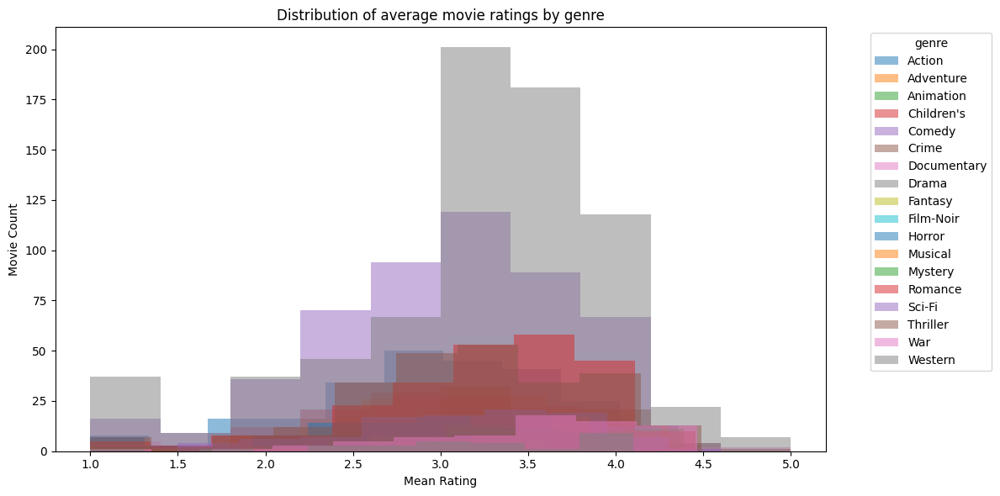

In [80]:
# genreごとのヒストグラムを作成して，genreごとに分布形状に違いがないかを確認する
# ジャンル列だけ抽出（movie_id, title, view_count などを除外）
genre_cols = [col for col in re_movie_views_with_info.columns
              if col not in ["movie_id", "movie_title", "view_count", "release_date", "url", "avg_rating", "unknown"]]

# プロットの設定
plt.figure(figsize=(12, 6))

# 各ジャンルについて平均ratingのヒストグラムを重ねて描画
for genre in genre_cols:
    # ジャンルフラグが1の映画に限定して、その平均ratingを取得
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, "avg_rating"]
    plt.hist(ratings, bins=10, alpha=0.5, label=genre)

# グラフの装飾
plt.title("Distribution of average movie ratings by genre")
plt.xlabel("Mean Rating")
plt.ylabel("Movie Count")
plt.legend(title="genre", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()


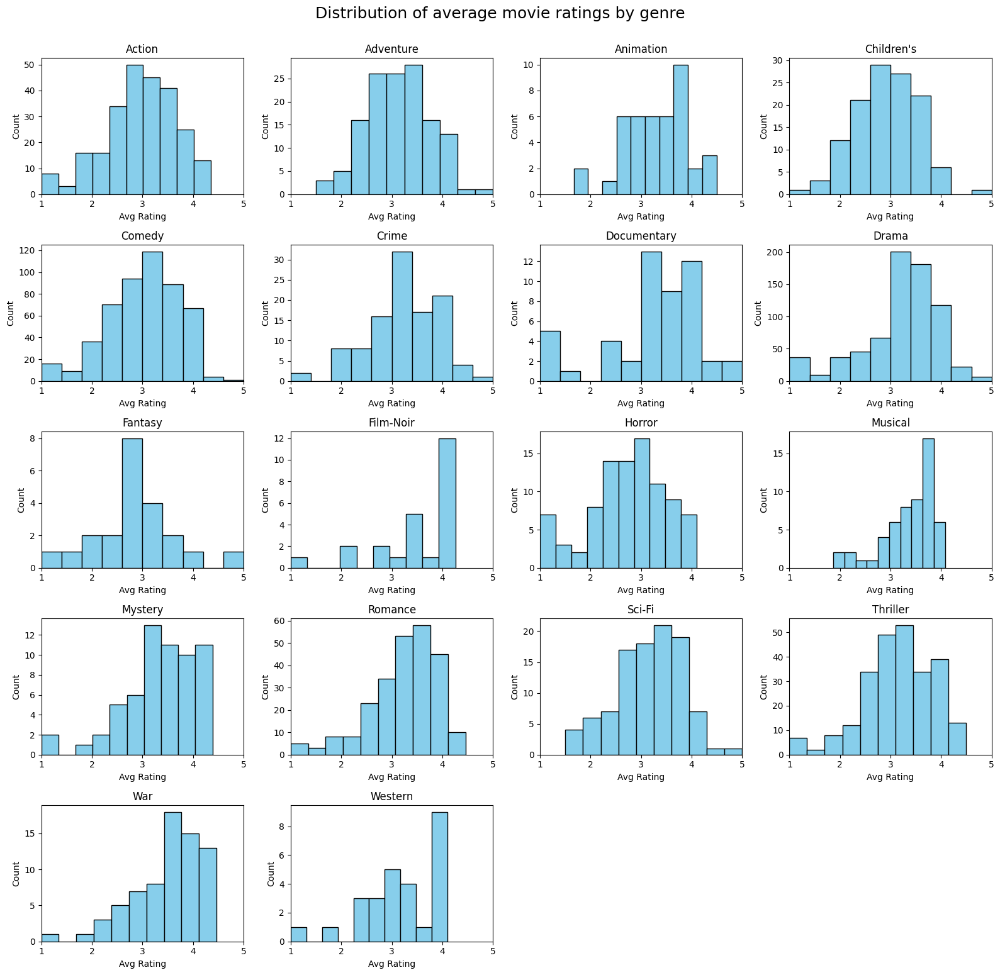

In [81]:
# ジャンルごとに小さいグラフを並べる（最大6列 × N行）
n_cols = 4
n_rows = -(-len(genre_cols) // n_cols)  # 天井関数で行数決定

plt.figure(figsize=(4 * n_cols, 3 * n_rows))

for i, genre in enumerate(genre_cols):
    plt.subplot(n_rows, n_cols, i + 1)
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, "avg_rating"]
    plt.hist(ratings, bins=10, color='skyblue', edgecolor='black')
    plt.title(genre)
    plt.xlabel("Avg Rating")
    plt.ylabel("Count")
    plt.xlim(1, 5)  # 評価スケールに合わせて固定

plt.tight_layout()
plt.suptitle("Distribution of average movie ratings by genre", fontsize=18, y=1.03)
plt.show()


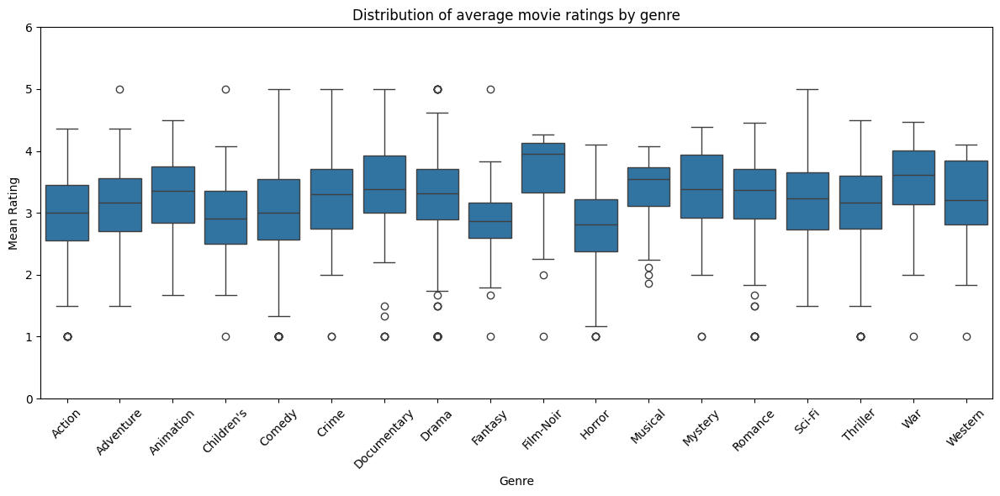

In [82]:
# 1. データを genre × avg_rating 形式に変換（long形式）
records = []
for genre in genre_cols:
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, ["avg_rating"]]
    ratings["genre"] = genre
    records.append(ratings)

long_df = pd.concat(records)

# 2. 箱ひげ図をプロット
plt.figure(figsize=(12, 6))
sns.boxplot(data=long_df, x="genre", y="avg_rating")
plt.xticks(rotation=45)
plt.title("Distribution of average movie ratings by genre")
plt.xlabel("Genre")
plt.ylabel("Mean Rating")
plt.ylim(0, 6)
plt.tight_layout()
plt.show()


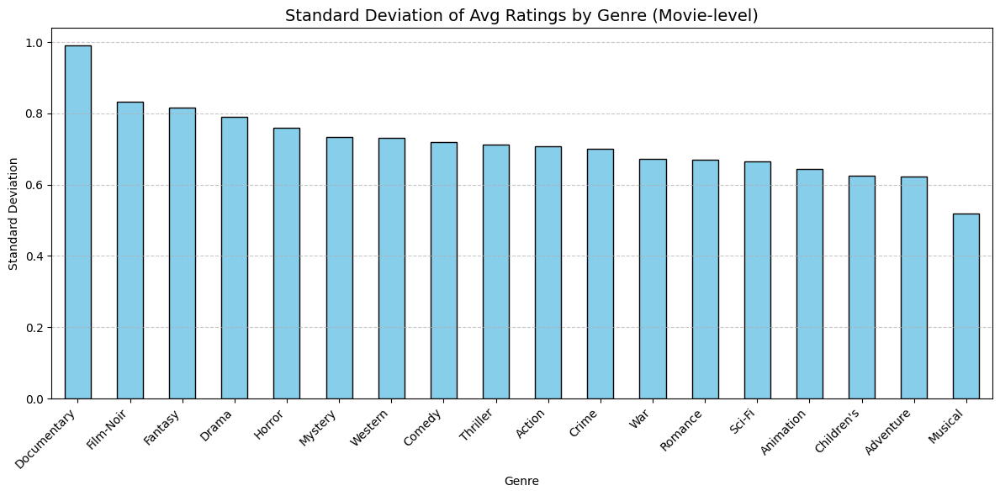

In [83]:
# 各ジャンルごとの avg_rating の標準偏差を計算
genre_std_dict = {}

for genre in genre_cols:
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, "avg_rating"]
    genre_std_dict[genre] = ratings.std()

# Series にして降順で並べる
genre_std_series = pd.Series(genre_std_dict).sort_values(ascending=False)

# 標準偏差を棒グラフで可視化
plt.figure(figsize=(12, 6))
genre_std_series.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title("Standard Deviation of Avg Ratings by Genre (Movie-level)", fontsize=14)
plt.ylabel("Standard Deviation")
plt.xlabel("Genre")
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [84]:
# Film-Noir(白黒映画)の中央値が1番高い
# 各genreの

In [85]:
# genreごとの累積和を計算する

# One-hot形式のジャンル列を抽出
genre_cols = [col for col in re_movie_views_with_info.columns
              if col not in ["movie_id", "movie_title", "view_count", "release_date", "url", "avg_rating", "unknown"]]

# 各ジャンルの累積和（=そのジャンルに属する映画の本数）
genre_counts = re_movie_views_with_info[genre_cols].sum().sort_values(ascending=False)

print("各ジャンルの映画本数（累積和）:")
print(genre_counts)


各ジャンルの映画本数（累積和）:
Drama          725
Comedy         505
Action         251
Thriller       251
Romance        247
Adventure      135
Children's     122
Crime          109
Sci-Fi         101
Horror          92
War             71
Mystery         61
Musical         56
Documentary     50
Animation       42
Western         27
Film-Noir       24
Fantasy         22
dtype: int64


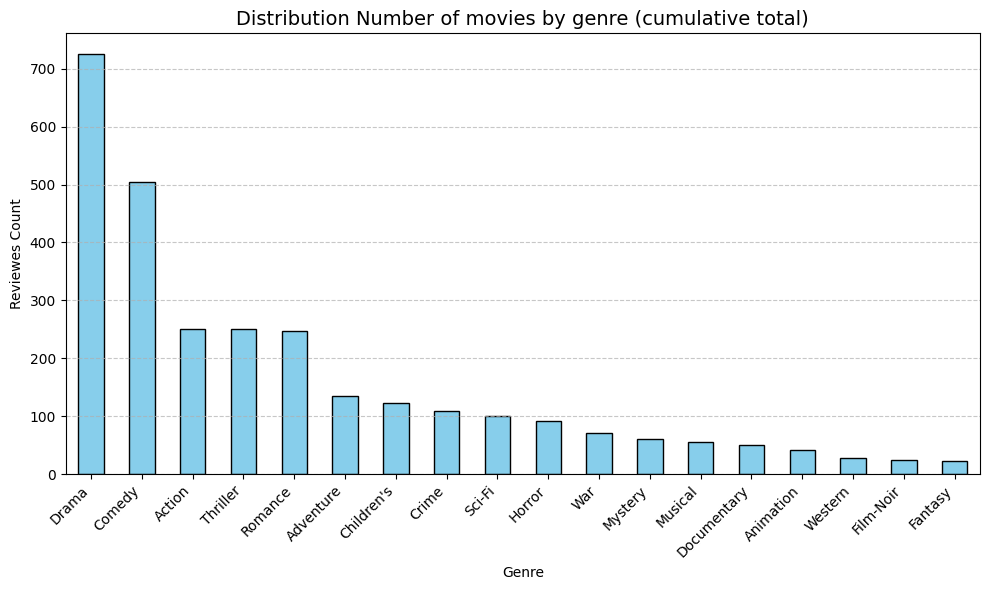

In [86]:
plt.figure(figsize=(10, 6))
genre_counts.plot(kind="bar", color="skyblue", edgecolor="black")
plt.title("Distribution Number of movies by genre (cumulative total)", fontsize=14)
plt.xlabel("Genre")
plt.ylabel("Reviewes Count")
plt.xticks(rotation=45, ha='right')
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


In [87]:
# 各ジャンルで「ratingが下限未満」の映画本数を累積和で降順に表示
# ジャンル別に下限を下回る映画を数えるための辞書
below_q1_counts = {}

for genre in genre_cols:
    # 該当ジャンルの平均ratingを抽出
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, "avg_rating"]

    # 四分位数（Q1）を計算
    q1 = ratings.quantile(0.25)

    # Q1を下回る映画の数をカウント
    count_below_q1 = (ratings < q1).sum()
    below_q1_counts[genre] = count_below_q1

# 辞書をSeries化して降順にソート
below_q1_series = pd.Series(below_q1_counts).sort_values(ascending=False)

print("ジャンルごとの下限（Q1）未満の評価数（降順）:")
print(below_q1_series)


ジャンルごとの下限（Q1）未満の評価数（降順）:
Drama          181
Comedy         126
Action          63
Thriller        63
Romance         62
Adventure       33
Children's      30
Crime           26
Sci-Fi          25
Horror          23
War             18
Mystery         15
Musical         14
Documentary     12
Animation       11
Western          7
Fantasy          6
Film-Noir        6
dtype: int64


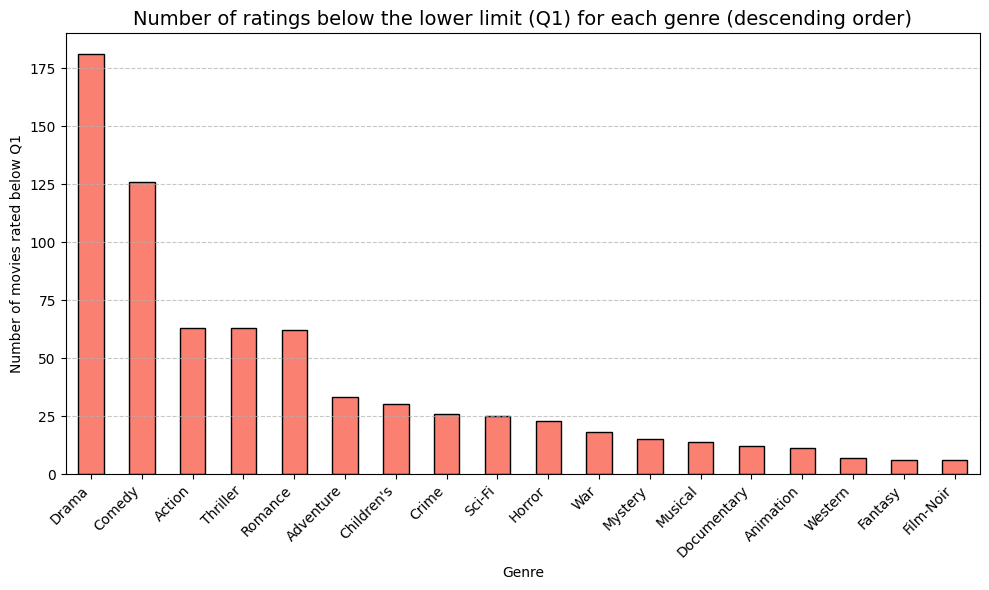

In [88]:
plt.figure(figsize=(10, 6))
below_q1_series.plot(kind="bar", color="salmon", edgecolor="black")
plt.title("Number of ratings below the lower limit (Q1) for each genre (descending order)", fontsize=14)
plt.xlabel("Genre")
plt.ylabel("Number of movies rated below Q1")
plt.xticks(rotation=45, ha='right')
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


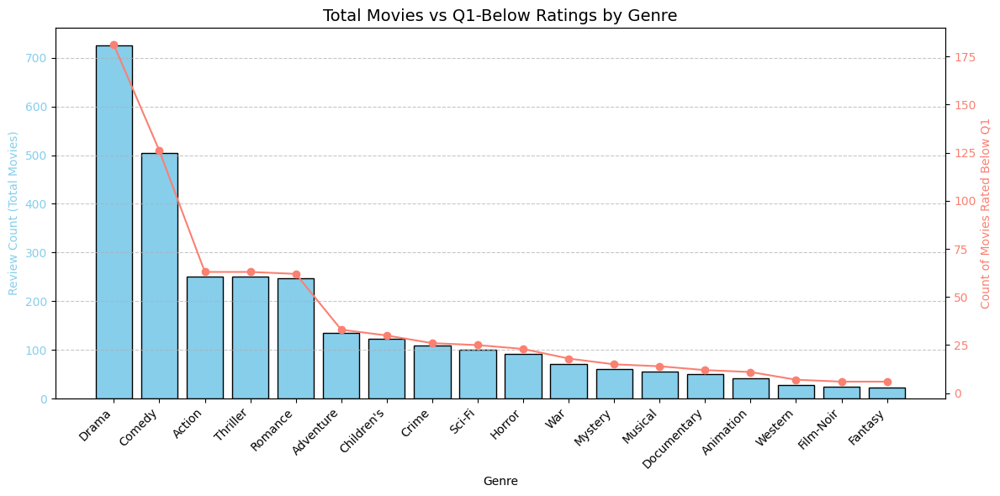

In [89]:
# 上の二つのコードを一つのグラフにまとめた

# ジャンル一覧（両Seriesに共通する順序で統一）
genres = genre_counts.index

fig, ax1 = plt.subplots(figsize=(12, 6))

# 左軸: 総レビュー数（ジャンルごとの累積映画本数）
ax1.bar(genres, genre_counts[genres], color='skyblue', edgecolor='black', label='Total Movies')
ax1.set_ylabel('Review Count (Total Movies)', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.set_xlabel('Genre')
ax1.set_xticklabels(genres, rotation=45, ha='right')

# タイトル設定
plt.title("Total Movies vs Q1-Below Ratings by Genre", fontsize=14)

# 右軸: Q1未満の映画数
ax2 = ax1.twinx()
ax2.plot(genres, below_q1_series[genres], color='salmon', marker='o', label='Movies Below Q1')
ax2.set_ylabel('Count of Movies Rated Below Q1', color='salmon')
ax2.tick_params(axis='y', labelcolor='salmon')

# グリッドと凡例
ax1.grid(axis='y', linestyle='--', alpha=0.7)
fig.tight_layout()
plt.show()


In [90]:
# 評価数の多いgenreほど，下限も多い傾向にある． -> 割合で考える必要あり

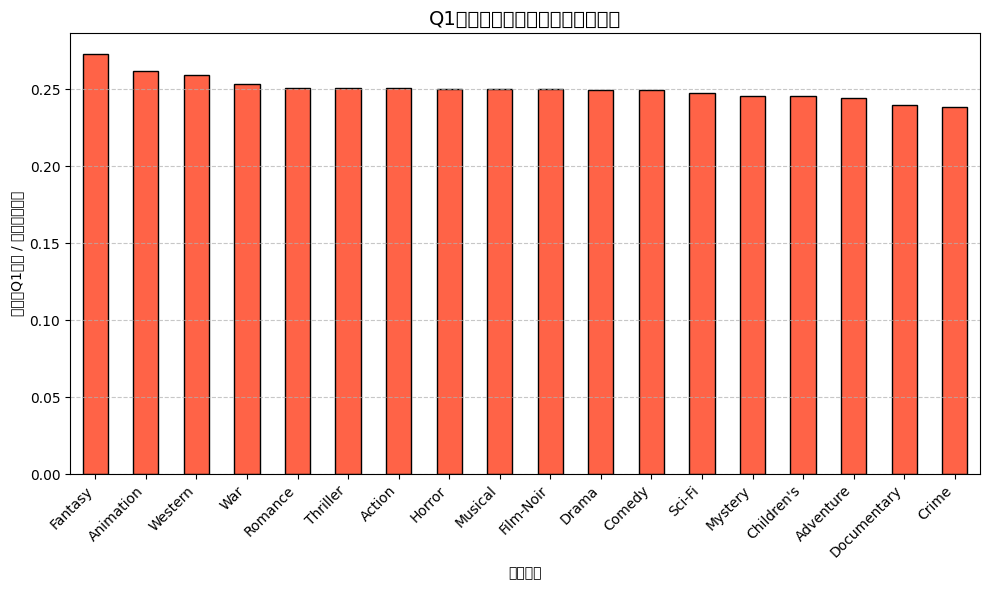

In [91]:
# 地雷率 = Q1未満本数 / 総本数
q1_rate = (below_q1_series / genre_counts).sort_values(ascending=False)

# 棒グラフで表示
plt.figure(figsize=(10, 6))
q1_rate.plot(kind="bar", color="tomato", edgecolor="black")
plt.title("Q1未満評価の割合（ジャンル別）", fontsize=14)
plt.xlabel("ジャンル")
plt.ylabel("割合（Q1未満 / 総映画本数）")
plt.xticks(rotation=45, ha='right')
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


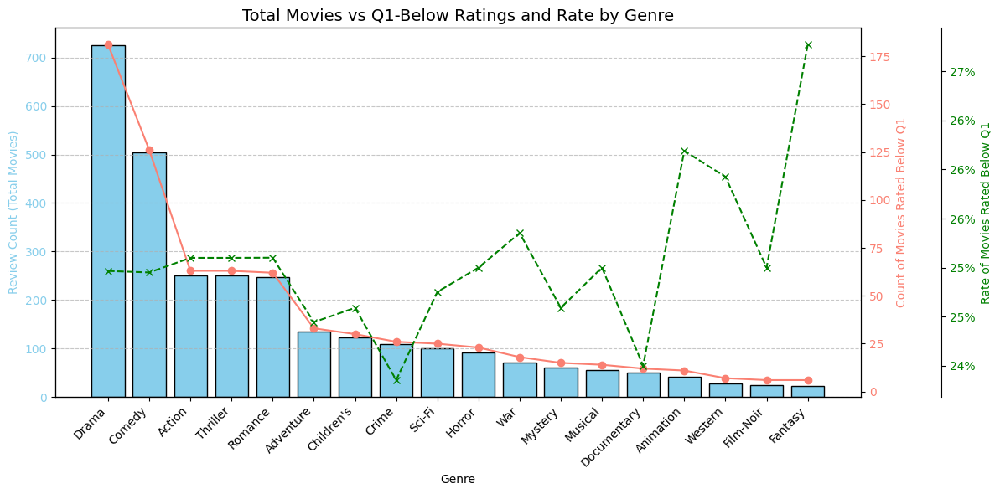

In [92]:
# 下限の割合を上のグラフに追加する

# ① 地雷率（割合）の計算
q1_rate = (below_q1_series / genre_counts).sort_index()  # index を genre_counts に合わせる

# ② ジャンル順（共通の順序を保持）
genres = genre_counts.index

# ③ グラフ作成
fig, ax1 = plt.subplots(figsize=(12, 6))

# 左軸: 総レビュー数（ジャンルごとの累積映画本数）
ax1.bar(genres, genre_counts[genres], color='skyblue', edgecolor='black', label='Total Movies')
ax1.set_ylabel('Review Count (Total Movies)', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.set_xlabel('Genre')
ax1.set_xticklabels(genres, rotation=45, ha='right')

# タイトル設定
plt.title("Total Movies vs Q1-Below Ratings and Rate by Genre", fontsize=14)

# 右軸1: Q1未満の本数（赤折れ線）
ax2 = ax1.twinx()
ax2.plot(genres, below_q1_series[genres], color='salmon', marker='o', label='Movies Below Q1')
ax2.set_ylabel('Count of Movies Rated Below Q1', color='salmon')
ax2.tick_params(axis='y', labelcolor='salmon')

# 右軸2: 地雷率（割合）をさらに別軸で追加
ax3 = ax1.twinx()
ax3.spines.right.set_position(("axes", 1.1))  # 第3軸を右にずらす
ax3.plot(genres, q1_rate[genres], color='green', marker='x', linestyle='--', label='Rate Below Q1')
ax3.set_ylabel('Rate of Movies Rated Below Q1', color='green')
ax3.tick_params(axis='y', labelcolor='green')
ax3.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y:.0%}'))  # %表示

# グリッドとレイアウト
ax1.grid(axis='y', linestyle='--', alpha=0.7)
fig.tight_layout()
plt.show()


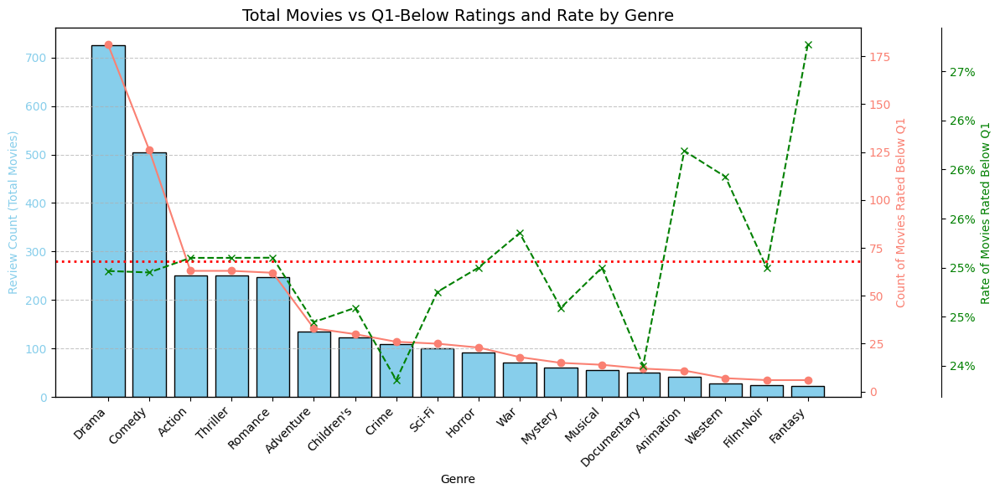

In [93]:
# 地雷率（Q1未満割合）
q1_rate = (below_q1_series / genre_counts).sort_index()
genres = genre_counts.index

# 地雷率の平均
mean_q1_rate = q1_rate.mean()

# グラフ描画
fig, ax1 = plt.subplots(figsize=(12, 6))

# 左Y軸：映画本数（棒グラフ）
ax1.bar(genres, genre_counts[genres], color='skyblue', edgecolor='black')
ax1.set_ylabel('Review Count (Total Movies)', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.set_xlabel('Genre')
ax1.set_xticklabels(genres, rotation=45, ha='right')

# タイトル
plt.title("Total Movies vs Q1-Below Ratings and Rate by Genre", fontsize=14)

# 右Y軸①：Q1未満本数（赤折れ線）
ax2 = ax1.twinx()
ax2.plot(genres, below_q1_series[genres], color='salmon', marker='o', label='Movies Below Q1')
ax2.set_ylabel('Count of Movies Rated Below Q1', color='salmon')
ax2.tick_params(axis='y', labelcolor='salmon')

# 右Y軸②：地雷率（緑破線）
ax3 = ax1.twinx()
ax3.spines.right.set_position(("axes", 1.1))
ax3.plot(genres, q1_rate[genres], color='green', marker='x', linestyle='--', label='Rate Below Q1')
ax3.set_ylabel('Rate of Movies Rated Below Q1', color='green')
ax3.tick_params(axis='y', labelcolor='green')
ax3.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y:.0%}'))

# 地雷率の平均を赤線で追加（ax3のy軸に合わせる）
ax3.axhline(mean_q1_rate, color='red', linestyle=':', linewidth=2, label=f'Mean Rate ({mean_q1_rate:.1%})')

# グリッドとレイアウト
ax1.grid(axis='y', linestyle='--', alpha=0.7)
fig.tight_layout()
plt.show()


In [94]:
# Fantasyは地雷率が高い
# Crime, Documentary, Adventure, Children's, Sci-Fiは地雷率が低い
# 

In [95]:
print("re_movie_views_with_info shape: ", re_movie_views_with_info.shape)
re_movie_views_with_info.head()

re_movie_views_with_info shape:  (1682, 25)


,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491
1,258,509,Contact (1997),11-Jul-1997,http://us.imdb.com/Title?Contact+(1997/I),0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,3.803536
2,100,508,Fargo (1996),14-Feb-1997,http://us.imdb.com/M/title-exact?Fargo%20(1996),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,4.155512
3,181,507,Return of the Jedi (1983),14-Mar-1997,http://us.imdb.com/M/title-exact?Return%20of%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.007890
4,294,485,Liar Liar (1997),21-Mar-1997,http://us.imdb.com/Title?Liar+Liar+(1997),0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,3.156701


In [96]:
# ジャンル列の抽出（One-hot形式）
genre_cols = [col for col in re_movie_views_with_info.columns
              if col not in ["movie_id", "movie_title", "view_count", "release_date", "url", "avg_rating", "unknown"]]

# 各ジャンルごとの avg_rating の平均を格納する辞書
genre_avg_rating = {}

for genre in genre_cols:
    # 該当ジャンルの映画だけ抽出
    ratings = re_movie_views_with_info.loc[re_movie_views_with_info[genre] == 1, "avg_rating"]
    # 欠損値を除いて平均を計算
    genre_avg_rating[genre] = ratings.mean()

# Seriesにして降順で表示
genre_avg_rating_series = pd.Series(genre_avg_rating).sort_values(ascending=False)

# 結果表示
print("ジャンルごとの平均rating（降順）:")
print(genre_avg_rating_series)


ジャンルごとの平均rating（降順）:
Film-Noir      3.548351
War            3.489185
Musical        3.376423
Mystery        3.336814
Animation      3.298813
Romance        3.244049
Documentary    3.229273
Crime          3.211015
Drama          3.187353
Western        3.185617
Sci-Fi         3.165446
Adventure      3.143967
Thriller       3.136692
Comedy         3.000565
Action         2.966332
Children's     2.916885
Fantasy        2.849830
Horror         2.730157
dtype: float64


In [97]:
# 結合して，1万行になったデータ

# ③ df_data から必要な列だけ抽出（item_id, rating）
rating_info = df_data[["item_id", "rating"]]

# ④ movie_id ≡ item_id で結合（many-to-many の可能性があるので確認後実行）
merged_item_data = pd.merge(
    re_movie_views_with_info,
    rating_info,
    left_on="movie_id",
    right_on="item_id",
    how="left"  # 全映画を保持（失われる映画がないように）
)

# ⑤ 結果確認
print("merged_item_data shape: ", merged_item_data.shape)
merged_item_data.head()

# -> 行数が増加したデータフレームではヒストグラムを作成して，映画ごとのratingの分布を確認する
# -> 平均ratingを結合したデータフレームは，ジャンルで高評価になりやすい映画があるかを確認する

merged_item_data shape:  (100000, 27)


,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating,item_id,rating
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
1,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,4
2,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
3,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
4,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5


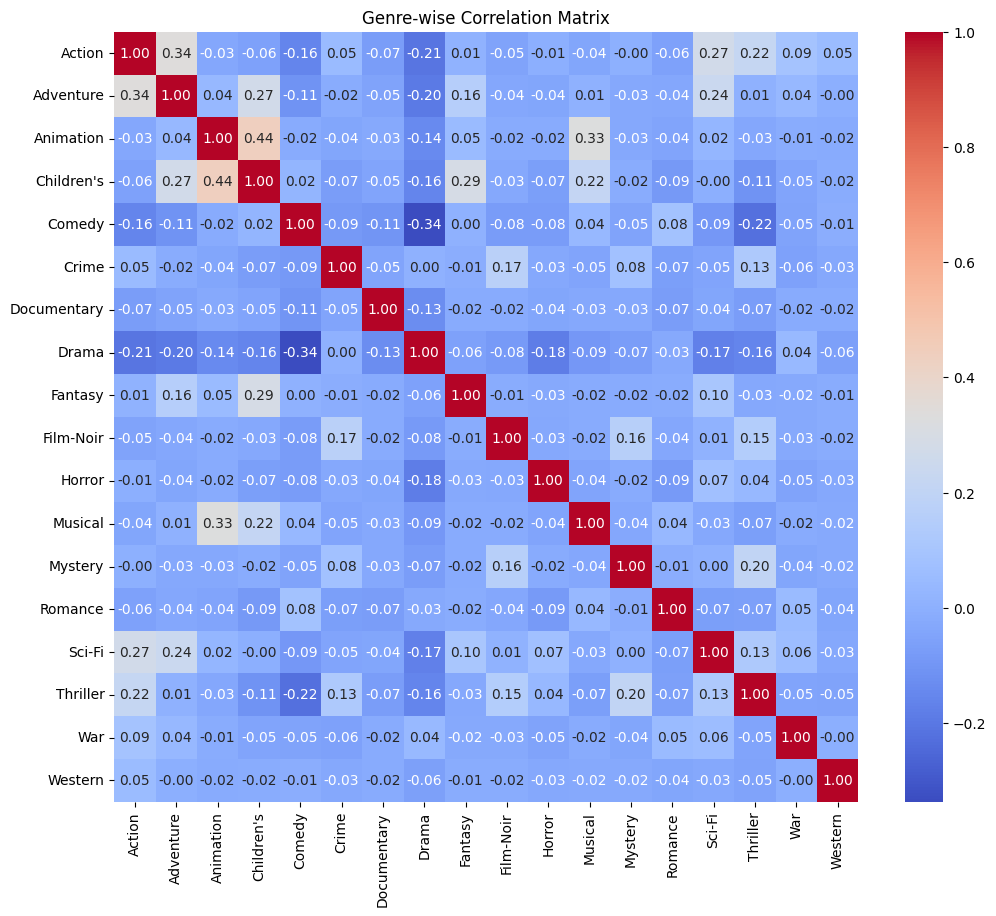

In [98]:
# Genre同士の相関係数の確認

# 共起頻度（ジャンルのペアごとの同時出現数）
co_occurrence = re_movie_views_with_info[genre_cols].T.dot(re_movie_views_with_info[genre_cols])

# または、相関係数（0~1）で関係性を可視化
genre_corr = re_movie_views_with_info[genre_cols].corr()

# ヒートマップで可視化（Seaborn）
plt.figure(figsize=(12, 10))
sns.heatmap(genre_corr, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Genre-wise Correlation Matrix")
plt.show()


In [99]:
# 計算に使用した行列の確認
# 共起行列は各Genreごとに同時に"1"だったらcountする

co_occurrence

,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
Action,251,75,3,9,32,23,0,46,4,0,13,4,9,25,54,84,21,8
Adventure,75,135,6,42,18,7,0,14,10,0,3,5,2,14,34,21,9,2
Animation,3,6,42,33,10,0,0,0,2,0,1,17,0,2,4,3,1,0
Children's,9,42,33,122,41,0,0,19,16,0,0,21,3,4,7,1,1,1
Comedy,32,18,10,41,505,16,1,89,7,0,14,22,11,97,13,14,13,7
Crime,23,7,0,0,16,109,0,48,1,10,3,0,10,6,2,35,0,0
Documentary,0,0,0,0,1,0,50,3,0,0,0,0,0,0,0,0,1,0
Drama,46,14,0,19,89,48,3,725,4,2,5,10,15,99,9,61,38,5
Fantasy,4,10,2,16,7,1,0,4,22,0,0,0,0,2,6,1,0,0
Film-Noir,0,0,0,0,0,10,0,2,0,24,0,0,7,1,2,14,0,0


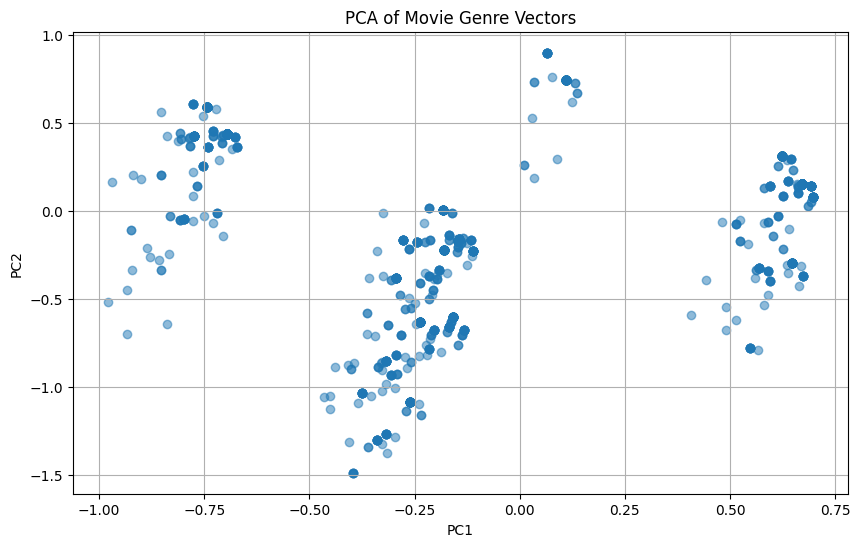

In [100]:
from sklearn.decomposition import PCA

# 映画ごとのジャンルベクトル → PCA
pca = PCA(n_components=2)
genre_pca = pca.fit_transform(re_movie_views_with_info[genre_cols])

# 可視化
plt.figure(figsize=(10, 6))
plt.scatter(genre_pca[:, 0], genre_pca[:, 1], alpha=0.5)
plt.title("PCA of Movie Genre Vectors")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
plt.show()


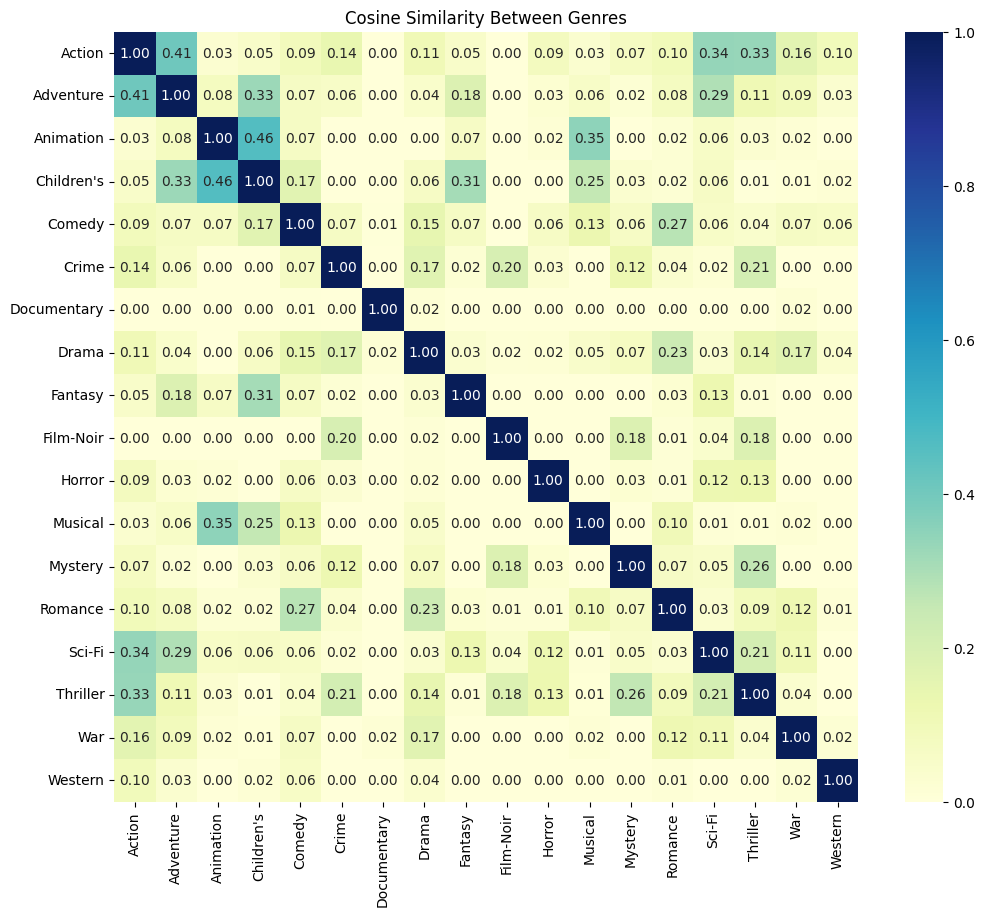

In [101]:
# Genre同士のcos類似度の計算

# ジャンルのコサイン類似度行列
similarity_matrix = cosine_similarity(re_movie_views_with_info[genre_cols].T)
similarity_df = pd.DataFrame(similarity_matrix, index=genre_cols, columns=genre_cols)

# 可視化
plt.figure(figsize=(12, 10))
sns.heatmap(similarity_df, annot=True, cmap="YlGnBu", fmt=".2f")
plt.title("Cosine Similarity Between Genres")
plt.show()



| 類似度         | 解釈                       | 例                           |
| ----------- | ------------------------ | --------------------------- |
| **1**       | 完全に同じ方向のベクトル（＝完全に同じ特徴）   | まったく同じジャンル構成                |
| **0.8〜1.0** | 非常に類似している                | Action ↔ Adventure          |
| **0.5〜0.8** | 中程度に類似                   | Comedy ↔ Romance            |
| **0.2〜0.5** | 弱い類似                     | Comedy ↔ Sci-Fi             |
| **0〜0.2**   | ほぼ無関係                    | Documentary ↔ Horror        |
| **< 0**     | 逆向き（反対傾向）※通常One-hotでは出ない | 特定ジャンルを持っていると他は絶対にない（極端な排他） |


In [102]:
merged_item_data.head()

,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating,item_id,rating
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
1,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,4
2,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
3,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5
4,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,50,5


In [103]:
# user_idの追加とitem_idの削除

re_merged_item_data = merged_item_data.copy().drop(columns=["item_id"], axis=1)

# ① item_id と user_id のペアを取得（重複除去）
movie_user_map = df_data[["item_id", "user_id"]].drop_duplicates()
movie_user_map = movie_user_map.rename(columns={"item_id": "movie_id"})

# ② movie_id をキーに re_merged_item_data に user_id を結合
re_merged_item_data = re_merged_item_data.merge(movie_user_map, on="movie_id", how="left")

# ③ 結果確認
re_merged_item_data.head()

,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating,rating,user_id
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,290
1,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,79
2,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,2
3,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,8
4,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,274


In [104]:
re_merged_item_data.head()

,movie_id,view_count,movie_title,release_date,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western,avg_rating,rating,user_id
0,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,290
1,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,79
2,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,2
3,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,8
4,50,583,Star Wars (1977),01-Jan-1977,http://us.imdb.com/M/title-exact?Star%20Wars%2...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,4.358491,5,274


In [105]:
# 各userにおいて，評価した映画にそのジャンルが含まれているならば計算に寄与する
# -> 複数ジャンルを許容しないと，おそらくほとんどの映画は計算されないため
user_genre_matrix.head()

NameError: name 'user_genre_matrix' is not defined

In [106]:
# 1. user × genre の平均rating行列を作成(userごとの平均ratingを算出)
user_genre_matrix = re_merged_item_data.groupby(["user_id"])[genre_cols].mean().fillna(0)

# 2. コサイン類似度の計算
from sklearn.metrics.pairwise import cosine_similarity
similarity_matrix = cosine_similarity(user_genre_matrix)

# 3. DataFrameに変換
sim_df = pd.DataFrame(similarity_matrix, index=user_genre_matrix.index, columns=user_genre_matrix.index)

print("merged_item_data shape: ", merged_item_data.shape)


merged_item_data shape:  (100000, 27)


In [107]:
print("sim_df shape: ", sim_df.shape)
sim_df.head()
# user_idが943までだから

sim_df shape:  (943, 943)


user_id,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943
user_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,1.000000,0.937476,0.892463,0.904597,0.922891,0.939750,0.987814,0.887712,0.885094,0.951629,0.963977,0.978212,0.991695,0.991162,0.977654,0.967712,0.921684,0.920842,0.905516,0.941795,0.920145,0.900750,0.985397,0.909722,0.978841,0.985048,0.884189,0.913631,0.859869,0.950979,0.845654,0.973266,0.803563,0.802626,0.844387,0.750374,0.799768,0.938978,0.856087,0.938538,0.971036,0.984012,0.984336,0.988961,0.976687,0.920257,0.798070,0.971177,0.976974,0.681264,...,0.925763,0.922344,0.988393,0.981282,0.899852,0.984541,0.919597,0.952057,0.961436,0.960519,0.809904,0.876034,0.856010,0.963623,0.962683,0.792217,0.930550,0.954568,0.930869,0.990554,0.635849,0.835544,0.993105,0.946063,0.873661,0.965161,0.805672,0.956700,0.966252,0.967039,0.963023,0.631038,0.854202,0.944054,0.936613,0.949025,0.982400,0.943462,0.990884,0.988738,0.982020,0.950298,0.983405,0.911471,0.982934,0.966685,0.984672,0.923434,0.958902,0.983330
2,0.937476,1.000000,0.884744,0.801170,0.770398,0.973375,0.947364,0.734046,0.899095,0.984928,0.981021,0.940930,0.956271,0.953292,0.955398,0.979618,0.963828,0.963519,0.910464,0.801067,0.890946,0.727251,0.903445,0.975303,0.866393,0.938195,0.849533,0.818431,0.888017,0.851776,0.900561,0.879479,0.771156,0.901110,0.813292,0.808388,0.635279,0.868268,0.894847,0.953186,0.962404,0.921395,0.955572,0.903067,0.895501,0.918328,0.908958,0.943233,0.935371,0.869946,...,0.977617,0.830300,0.925949,0.880879,0.919136,0.903930,0.943170,0.822955,0.878770,0.954106,0.867424,0.937388,0.940266,0.975005,0.943313,0.912103,0.876802,0.904566,0.945129,0.934664,0.755432,0.916213,0.940164,0.979884,0.906761,0.979958,0.892869,0.864732,0.850987,0.898260,0.945586,0.716419,0.942600,0.826044,0.966184,0.936763,0.902965,0.945870,0.935317,0.888986,0.923977,0.920731,0.975496,0.961846,0.921948,0.913110,0.963150,0.759620,0.915697,0.913653
3,0.892463,0.884744,1.000000,0.938076,0.745670,0.834347,0.926267,0.825469,0.796330,0.910249,0.890843,0.902036,0.914710,0.887096,0.927989,0.926505,0.812106,0.788705,0.735567,0.839658,0.956696,0.760668,0.847369,0.868562,0.849655,0.932287,0.925271,0.926724,0.945314,0.811911,0.937420,0.895811,0.945572,0.830361,0.953026,0.868054,0.795237,0.823775,0.935056,0.950399,0.881491,0.857276,0.867109,0.888482,0.825071,0.947857,0.900668,0.910940,0.852749,0.744946,...,0.927873,0.819698,0.932137,0.882377,0.975113,0.876778,0.952238,0.794929,0.920238,0.944750,0.722701,0.948679,0.896419,0.903754,0.964575,0.738502,0.934011,0.796983,0.801066,0.907469,0.476225,0.959526,0.903345,0.882593,0.695890,0.919242,0.951903,0.812930,0.811318,0.934525,0.912485,0.848623,0.910855,0.782643,0.948784,0.929283,0.865107,0.910830,0.907800,0.880380,0.835482,0.901810,0.904968,0.828438,0.921173,0.897662,0.882344,0.819060,0.922167,0.885904
4,0.904597,0.801170,0.938076,1.000000,0.851209,0.752891,0.908412,0.936060,0.789599,0.823055,0.831916,0.905928,0.899538,0.887977,0.917766,0.856748,0.730309,0.712192,0.695929,0.930539,0.922549,0.895124,0.892853,0.758352,0.915782,0.941400,0.910461,0.972388,0.844806,0.901193,0.856466,0.958285,0.917578,0.652550,0.918813,0.783234,0.923312,0.839018,0.841950,0.864126,0.855529,0.892254,0.861073,0.926779,0.877136,0.926313,0.732725,0.890539,0.850705,0.548485,...,0.840983,0.911112,0.939691,0.927287,0.920696,0.920920,0.860041,0.892321,0.949238,0.877400,0.719838,0.837290,0.773833,0.866439,0.940503,0.593270,0.944150,0.795414,0.746670,0.910162,0.440906,0.839349,0.918199,0.823008,0.643683,0.861039,0.820182,0.887985,0.898471,0.961304,0.899888,0.699378,0.768522,0.858404,0.882771,0.878612,0.899932,0.878955,0.907343,0.923878,0.86

In [108]:
sim_df.columns

Index([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,
       ...
       934, 935, 936, 937, 938, 939, 940, 941, 942, 943],
      dtype='int64', name='user_id', length=943)

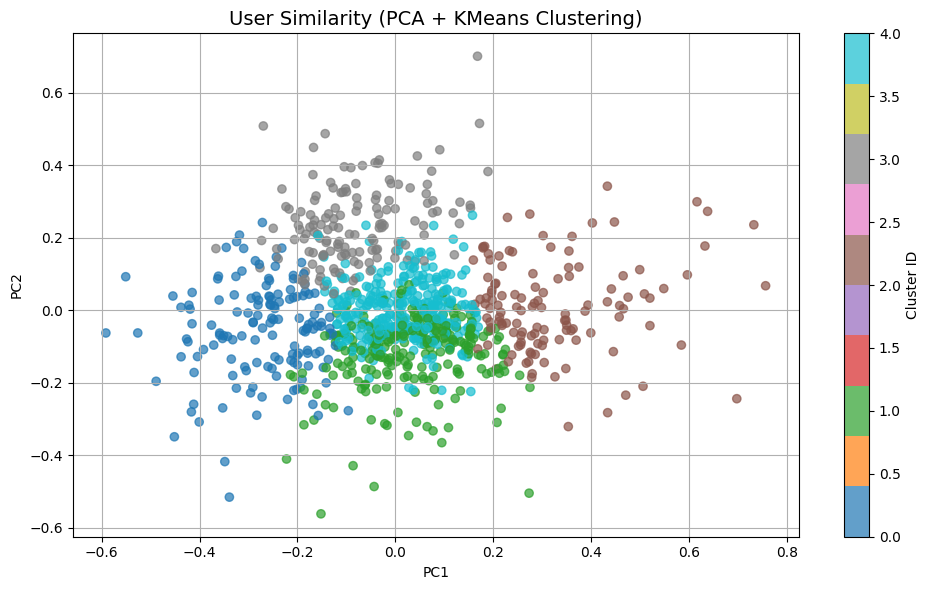

In [109]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# ① PCAで次元圧縮（user × genre → user × 2次元）
pca = PCA(n_components=2)
user_pca = pca.fit_transform(user_genre_matrix)

# ② クラスタリング（例: 5クラスタ）
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(user_genre_matrix)

# ③ 可視化（PCA + クラスタ色分け）
plt.figure(figsize=(10, 6))
plt.scatter(user_pca[:, 0], user_pca[:, 1], c=clusters, cmap='tab10', alpha=0.7)
plt.title("User Similarity (PCA + KMeans Clustering)", fontsize=14)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
plt.colorbar(label="Cluster ID")
plt.tight_layout()
plt.show()


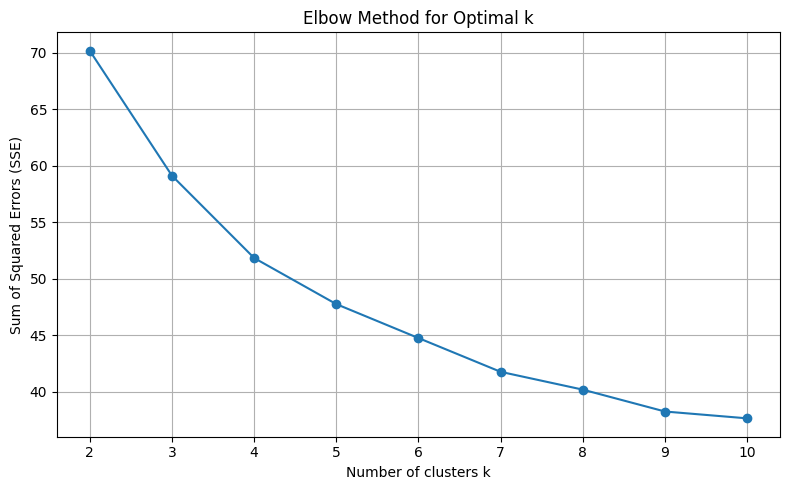

In [110]:
# user × genre の平均rating行列（すでに用意済み）
X = user_genre_matrix

sse = []
K_range = range(2, 11)  # k = 2〜10 で試す

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    sse.append(kmeans.inertia_)  # inertia_ = クラスタ内誤差の合計

# 可視化
plt.figure(figsize=(8, 5))
plt.plot(K_range, sse, marker='o')
plt.title("Elbow Method for Optimal k")
plt.xlabel("Number of clusters k")
plt.ylabel("Sum of Squared Errors (SSE)")
plt.grid(True)
plt.tight_layout()
plt.show()

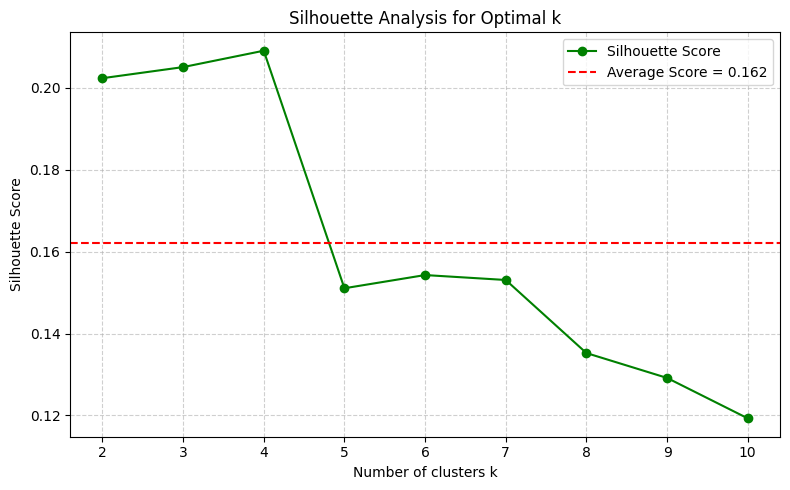

In [111]:
from sklearn.metrics import silhouette_score

silhouette_scores = []

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X)
    score = silhouette_score(X, labels)
    silhouette_scores.append(score)

# 可視化
# ② 平均スコア（全体平均）
avg_sil_score = sum(silhouette_scores) / len(silhouette_scores)

# ③ グラフ可視化（赤線＝平均）
plt.figure(figsize=(8, 5))
plt.plot(K_range, silhouette_scores, marker='o', color='green', label='Silhouette Score')
plt.axhline(avg_sil_score, color='red', linestyle='--', label=f'Average Score = {avg_sil_score:.3f}')
plt.title("Silhouette Analysis for Optimal k")
plt.xlabel("Number of clusters k")
plt.ylabel("Silhouette Score")
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()

In [112]:
# k=4を境に大きく低下している．
# シルエットスコアの数式(a(凝集度), b(乖離度)より)，k=4の時はデータ点はある程度凝集していてクラスタ間は乖離しているが，それ以降は逆転する

| スコア範囲       | 解釈                       |
| ----------- | ------------------------ |
| **0.7〜1.0** | 非常に良い：クラスタがはっきり分かれている    |
| **0.5〜0.7** | 良好：十分に分かれており実用レベル        |
| **0.3〜0.5** | 微妙：クラスタが曖昧で一部重なっている      |
| **〜0.3以下**  | 悪い：クラスタリングがうまく機能していない可能性 |


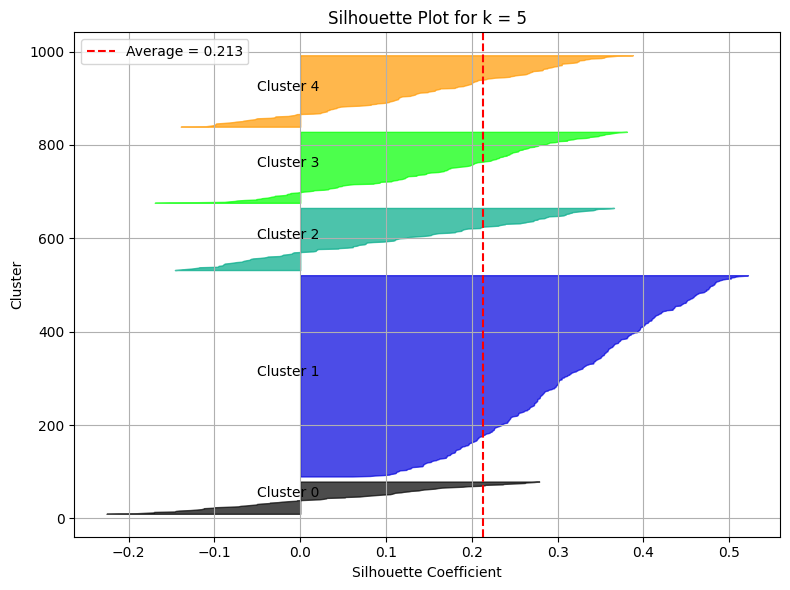

In [113]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# 特徴量：user × genre の行列（すでに作成済み）
X = user_genre_matrix.values

# 任意のクラスタ数（例：k=4）
k = 5

# ① KMeansクラスタリングの実行
kmeans = KMeans(n_clusters=k, random_state=42, n_init=150)
cluster_labels = kmeans.fit_predict(X)

# ② 各サンプル（ユーザー）のシルエットスコアを計算
silhouette_vals = silhouette_samples(X, cluster_labels)
avg_score = silhouette_score(X, cluster_labels)

# ③ シルエットプロットの描画
plt.figure(figsize=(8, 6))
y_lower = 10  # 各クラスタの棒の開始位置

for i in range(k):
    # i番目のクラスタのシルエット値を抽出して昇順に並べる
    ith_cluster_sil_vals = silhouette_vals[cluster_labels == i]
    ith_cluster_sil_vals.sort()

    size_cluster_i = ith_cluster_sil_vals.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / k)
    plt.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_sil_vals,
                      facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, f'Cluster {i}')
    y_lower = y_upper + 10  # 次のクラスタの開始位置

# 平均シルエットスコアの縦線
plt.axvline(avg_score, color="red", linestyle="--", label=f"Average = {avg_score:.3f}")

# グラフの装飾
plt.xlabel("Silhouette Coefficient")
plt.ylabel("Cluster")
plt.title(f"Silhouette Plot for k = {k}")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


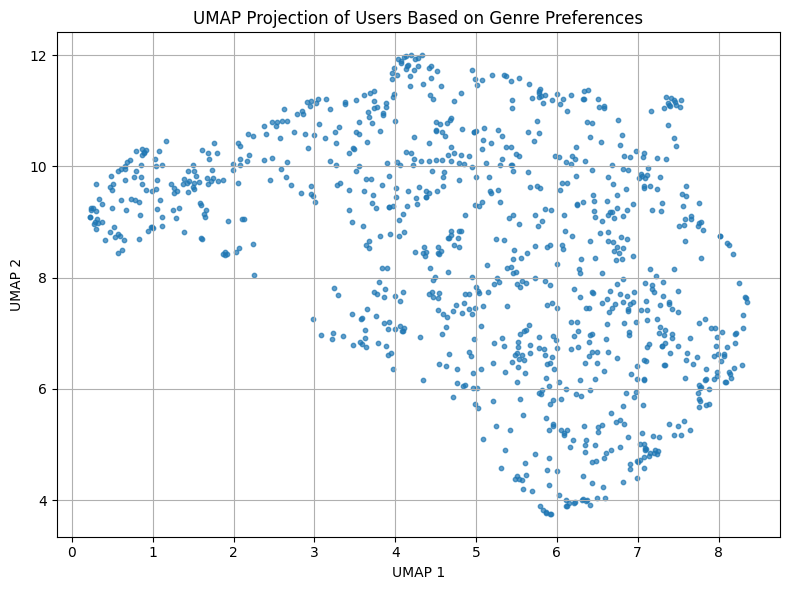

In [114]:
# PCAでは適切なクラスタリングができなかったから，UMAPとt-SNEも用いてみる．

import umap
import matplotlib.pyplot as plt

# 特徴行列（ジャンルごとの評価平均ベクトル）
X = user_genre_matrix.values

# UMAPによる次元圧縮
reducer = umap.UMAP(random_state=42, n_neighbors=15, min_dist=0.1)
embedding = reducer.fit_transform(X)  # shape = (943, 2)

# 可視化
plt.figure(figsize=(8, 6))
plt.scatter(embedding[:, 0], embedding[:, 1], s=10, alpha=0.7)
plt.title("UMAP Projection of Users Based on Genre Preferences")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.tight_layout()
plt.show()


In [115]:
# 左上だけ塊があり，その他の塊と滑らかに接続するuserがいる．
# しかし，近しいクラスタはないと言って良い．

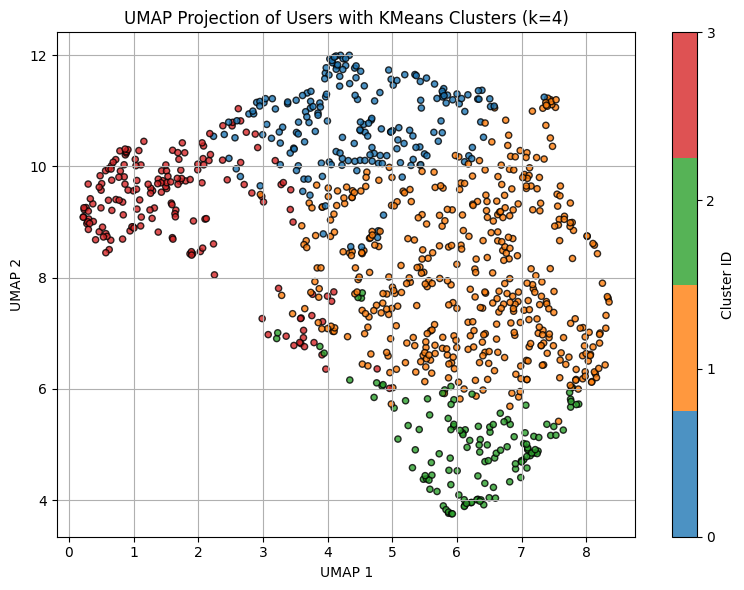

In [116]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.cluster import KMeans
import umap

# 特徴量
X = user_genre_matrix.values

# UMAPで2次元に圧縮
reducer = umap.UMAP(random_state=42, n_neighbors=15, min_dist=0.1)
embedding_umap = reducer.fit_transform(X)

# KMeansクラスタリング（4クラスタ）
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
cluster_labels = kmeans.fit_predict(X)

# カラーマップを4色に限定（tab10の最初の4色）
colors = plt.cm.tab10.colors[:4]
cmap4 = ListedColormap(colors)

# プロット（カラーマップ明示）
plt.figure(figsize=(8, 6))
sc = plt.scatter(
    embedding_umap[:, 0], embedding_umap[:, 1],
    c=cluster_labels, cmap=cmap4, s=20, alpha=0.8, edgecolors='k'
)
plt.colorbar(sc, ticks=range(4), label="Cluster ID")
plt.title("UMAP Projection of Users with KMeans Clusters (k=4)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.tight_layout()
plt.show()


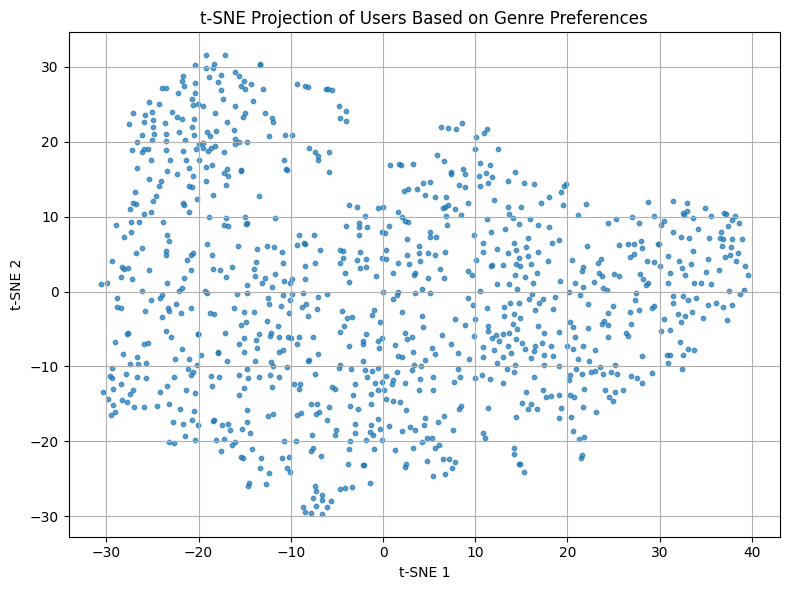

In [117]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embedding_tsne = tsne.fit_transform(X)

plt.figure(figsize=(8, 6))
plt.scatter(embedding_tsne[:, 0], embedding_tsne[:, 1], s=10, alpha=0.7)
plt.title("t-SNE Projection of Users Based on Genre Preferences")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.grid(True)
plt.tight_layout()
plt.show()


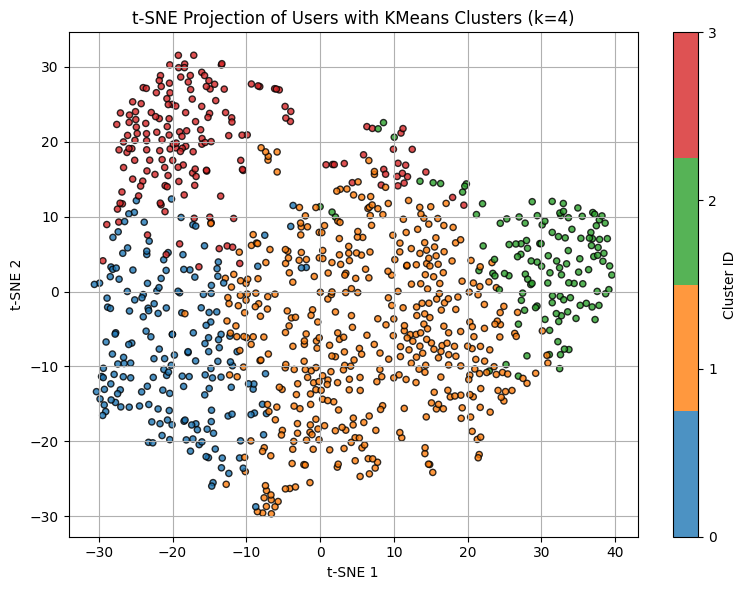

In [118]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# 特徴量（ジャンルごとの平均評価ベクトル）
X = user_genre_matrix.values

# ① t-SNE による次元削減（2次元）
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embedding_tsne = tsne.fit_transform(X)

# ② KMeansクラスタリング（元のXに対して）
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
cluster_labels = kmeans.fit_predict(X)

# ③ カラーマップを4色に限定
colors = plt.cm.tab10.colors[:4]
cmap4 = ListedColormap(colors)

# ④ t-SNE 結果をクラスタラベルで色分け＋カラーバー付き
plt.figure(figsize=(8, 6))
sc = plt.scatter(
    embedding_tsne[:, 0], embedding_tsne[:, 1],
    c=cluster_labels, cmap=cmap4, s=20, alpha=0.8, edgecolors="k"
)
plt.colorbar(sc, ticks=range(4), label="Cluster ID")
plt.title("t-SNE Projection of Users with KMeans Clusters (k=4)")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.grid(True)
plt.tight_layout()
plt.show()


In [119]:
# 1. 評価件数を集計
movie_view_counts = df_data.groupby("item_id")["user_id"].count().reset_index()
movie_view_counts.columns = ["movie_id", "view_count"]

# 2. 映画情報と結合
movie_views_with_info = pd.merge(movie_view_counts, df_item.copy(), on="movie_id", how="left")

# 3. 降順にソート
movie_views_with_info = movie_views_with_info.sort_values(by="view_count", ascending=False)

# 4. ジャンル列（明示）
genre_cols = [
    "unknown", "Action", "Adventure", "Animation", "Children's", "Comedy", "Crime", "Documentary",
    "Drama", "Fantasy", "Film-Noir", "Horror", "Musical", "Mystery", "Romance", "Sci-Fi",
    "Thriller", "War", "Western"
]

# 5. NaN や型の不一致にも対応した genre 結合処理
def extract_genres(row):
    return " | ".join([
        genre for genre in genre_cols
        if isinstance(row[genre], (int, float)) and row[genre] == 1.0
    ])

movie_views_with_info["genre"] = movie_views_with_info.apply(extract_genres, axis=1)

# 6. 表示
display_cols = ["movie_title", "view_count", "genre"]
display(movie_views_with_info[display_cols].head(10))

,movie_title,view_count,genre
49,Star Wars (1977),583,Action | Adventure | Romance | Sci-Fi | War
257,Contact (1997),509,Drama | Sci-Fi
99,Fargo (1996),508,Crime | Drama | Thriller
180,Return of the Jedi (1983),507,Action | Adventure | Romance | Sci-Fi | War
293,Liar Liar (1997),485,Comedy
285,"English Patient, The (1996)",481,Drama | Romance | War
287,Scream (1996),478,Horror | Thriller
0,Toy Story (1995),452,Animation | Children's | Comedy
299,Air Force One (1997),431,Action | Thriller
120,Independence Day (ID4) (1996),429,Action | Sci-Fi | War


In [120]:
# userごとに辛口or甘口評価かを調べる

# ① ユーザーごとの平均 rating を計算
user_rating_stats = df_data.groupby("user_id")["rating"].agg(["mean", "count"])

# ② 全体平均を計算して比較
global_avg = df_data["rating"].mean()
user_rating_stats["global_avg"] = global_avg
user_rating_stats["tendency"] = user_rating_stats["mean"] - global_avg  # 0より上→甘口、下→辛口

# ③ 辛口〜甘口のランキングを表示
user_rating_stats = user_rating_stats.sort_values(by="tendency")

# 結果の一部表示（上位5人＝最も辛口）
print("【辛口ユーザー Top 5】")
print(user_rating_stats.head())

print("\n【甘口ユーザー Top 5】")
print(user_rating_stats.tail())


【辛口ユーザー Top 5】
             mean  count  global_avg  tendency
user_id                                       
181      1.491954    435     3.52986 -2.037906
405      1.834464    737     3.52986 -1.695396
445      1.985185    135     3.52986 -1.544675
685      2.050000     20     3.52986 -1.479860
774      2.058036    224     3.52986 -1.471824

【甘口ユーザー Top 5】
             mean  count  global_avg  tendency
user_id                                       
928      4.687500     32     3.52986  1.157640
628      4.703704     27     3.52986  1.173844
507      4.724138     58     3.52986  1.194278
688      4.833333     24     3.52986  1.303473
849      4.869565     23     3.52986  1.339705


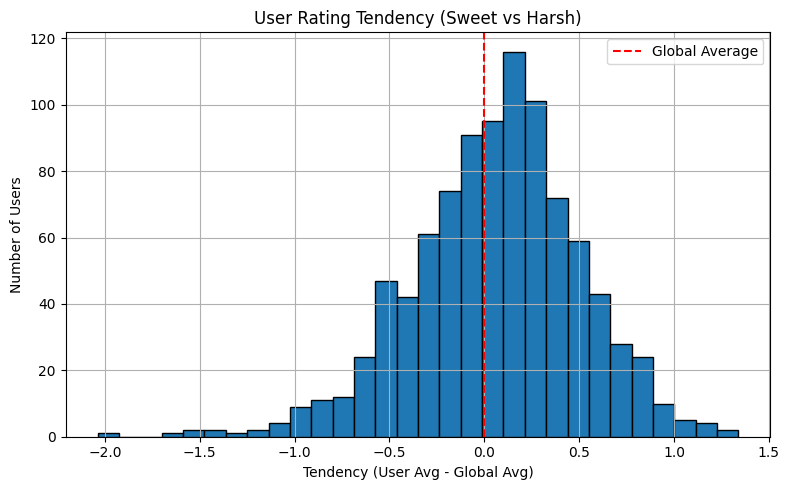

In [121]:
plt.figure(figsize=(8, 5))
user_rating_stats["tendency"].hist(bins=30, edgecolor="black")
plt.axvline(0, color='red', linestyle='--', label='Global Average')
plt.title("User Rating Tendency (Sweet vs Harsh)")
plt.xlabel("Tendency (User Avg - Global Avg)")
plt.ylabel("Number of Users")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [122]:
user_rating_stats

,mean,count,global_avg,tendency
user_id,,,,
181,1.491954,435,3.52986,-2.037906
405,1.834464,737,3.52986,-1.695396
445,1.985185,135,3.52986,-1.544675
685,2.050000,20,3.52986,-1.479860
774,2.058036,224,3.52986,-1.471824
...,...,...,...,...
928,4.687500,32,3.52986,1.157640
628,4.703704,27,3.52986,1.173844
507,4.724138,58,3.52986,1.194278


             Sweet (avg)  Harsh (avg)  Difference (Sweet - Harsh)
Drama           0.437787     0.395796                    0.041991
War             0.164000     0.138806                    0.025194
Adventure       0.159920     0.142681                    0.017239
Romance         0.247220     0.230784                    0.016436
Sci-Fi          0.183824     0.172428                    0.011396
Crime           0.097588     0.086558                    0.011031
Western         0.011370     0.007859                    0.003511
Documentary     0.002750     0.001386                    0.001363
Film-Noir       0.019577     0.018893                    0.000684
Animation       0.029753     0.029987                   -0.000233
Fantasy         0.007856     0.008660                   -0.000804
Musical         0.037129     0.038981                   -0.001852
Children's      0.053858     0.059038                   -0.005180
Comedy          0.237702     0.244973                   -0.007271
Horror    

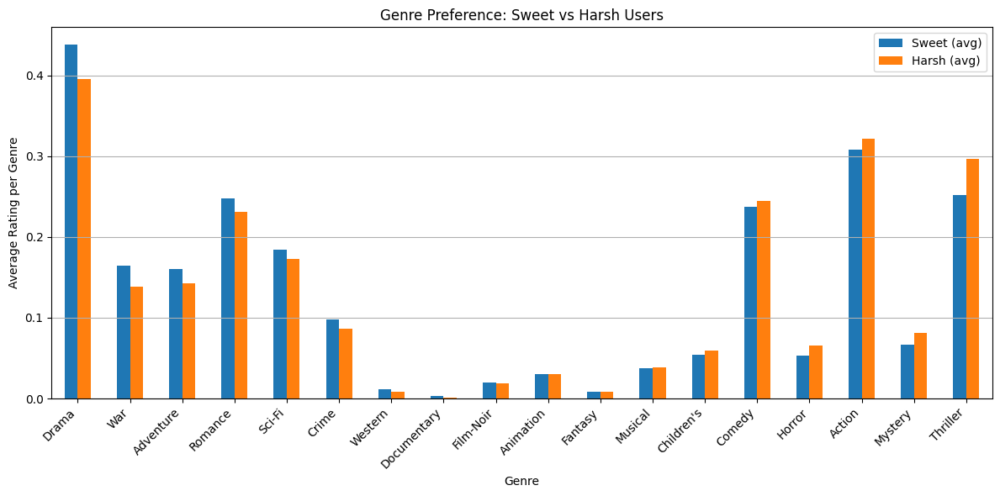

In [123]:
# ① ユーザーごとの平均ratingと傾向を算出
user_rating_stats = df_data.groupby("user_id")["rating"].agg(["mean", "count"])
global_avg = df_data["rating"].mean()
user_rating_stats["tendency"] = user_rating_stats["mean"] - global_avg

# ② 閾値を決めて辛口／甘口を分類(thresholdを0で区切ると，+0.01や-0.01の人も辛口or甘口で分類されるため，明確に辛口or甘口で分類できるように±0.3にする)
# ※ 中立ユーザーを除外したい場合は threshold を ±0.2〜0.5 に設定するとよい
sweet_threshold = 0.3
harsh_threshold = -0.3

sweet_users = user_rating_stats[user_rating_stats["tendency"] > sweet_threshold].index
harsh_users = user_rating_stats[user_rating_stats["tendency"] < harsh_threshold].index

# ③ ジャンルベクトルから各グループの平均を抽出
# user_genre_matrixは，各userのジャンルにおける平均値
sweet_genre_profile = user_genre_matrix.loc[sweet_users].mean()
harsh_genre_profile = user_genre_matrix.loc[harsh_users].mean()

# ④ 結果を DataFrame にまとめて比較
genre_compare_df = pd.DataFrame({
    "Sweet (avg)": sweet_genre_profile,
    "Harsh (avg)": harsh_genre_profile,
    "Difference (Sweet - Harsh)": sweet_genre_profile - harsh_genre_profile
}).sort_values("Difference (Sweet - Harsh)", ascending=False)

# 表示（上位ジャンル差）
print(genre_compare_df.head(18))
print("\n甘口ユーザーと辛口ユーザーのジャンル評価傾向の差（上位）")

# ⑤ 可視化（棒グラフで比較）
genre_compare_df[["Sweet (avg)", "Harsh (avg)"]].plot(kind='bar', figsize=(12, 6))
plt.title("Genre Preference: Sweet vs Harsh Users")
plt.ylabel("Average Rating per Genre")
plt.xlabel("Genre")
plt.xticks(rotation=45, ha='right')
plt.grid(axis="y")
plt.tight_layout()
plt.show()


In [124]:
# 画像の結果から辛口も甘口も大して変わらない．
# 理由: ①thresholdは±0.3で区切っていて，それよりも大きい/小さいtendencyがあれば辛口と甘口に分類される

In [125]:
# 辛口と甘口の人の割合を全体から算出する

# 全ユーザー数
total_users = user_rating_stats.shape[0]

# 甘口・辛口ユーザー数
n_sweet = len(sweet_users)
n_harsh = len(harsh_users)

# 割合の計算
sweet_ratio = n_sweet / total_users * 100
harsh_ratio = n_harsh / total_users * 100
neutral_ratio = 100 - sweet_ratio - harsh_ratio  # 中立ユーザーの割合

# 結果を出力
print(f"全ユーザー数: {total_users}")
print(f"甘口ユーザー数: {n_sweet}（{sweet_ratio:.1f}%）")
print(f"辛口ユーザー数: {n_harsh}（{harsh_ratio:.1f}%）")
print(f"中立ユーザー数: {total_users - n_sweet - n_harsh}（{neutral_ratio:.1f}%）")


全ユーザー数: 943
甘口ユーザー数: 271（28.7%）
辛口ユーザー数: 175（18.6%）
中立ユーザー数: 497（52.7%）


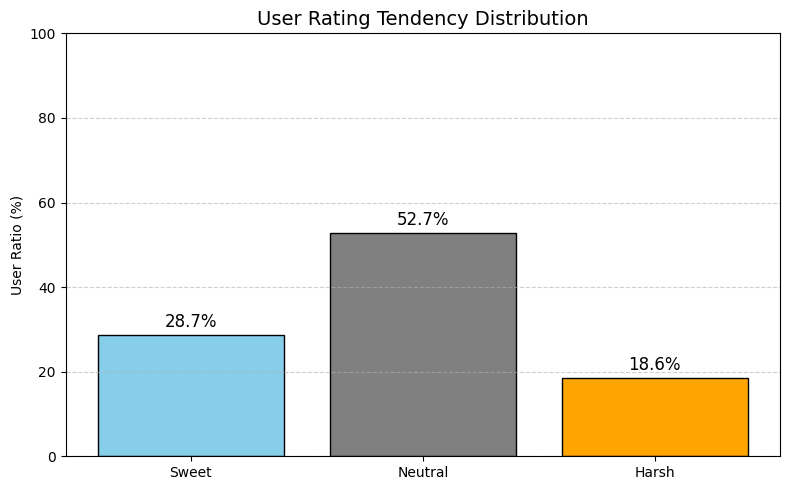

In [126]:
# ① 数値計算
total_users = user_rating_stats.shape[0]
n_sweet = len(sweet_users)
n_harsh = len(harsh_users)
n_neutral = total_users - n_sweet - n_harsh

# 棒グラフ用のデータ
labels = ["Sweet", "Neutral", "Harsh"]
counts = [n_sweet, n_neutral, n_harsh]
ratios = [n_sweet / total_users * 100, n_neutral / total_users * 100, n_harsh / total_users * 100]

# ② 可視化
plt.figure(figsize=(8, 5))
bars = plt.bar(labels, ratios, color=["skyblue", "gray", "orange"], edgecolor="black")

# 値を上に表示
for bar, ratio in zip(bars, ratios):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 1, f"{ratio:.1f}%", ha="center", va="bottom", fontsize=12)

plt.title("User Rating Tendency Distribution", fontsize=14)
plt.ylabel("User Ratio (%)")
plt.ylim(0, 100)
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


In [127]:
user_genre_matrix

,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
user_id,,,,,,,,,,,,,,,,,,
1,0.343261,0.188124,0.039728,0.073122,0.313310,0.104317,0.005307,0.380695,0.004805,0.006574,0.046613,0.048573,0.022709,0.190061,0.225367,0.217861,0.130062,0.021155
2,0.218262,0.082899,0.036203,0.050941,0.283540,0.156748,0.000000,0.497477,0.002403,0.029636,0.053344,0.020745,0.055427,0.309732,0.127273,0.232599,0.092351,0.000000
3,0.308540,0.105633,0.000000,0.000000,0.159297,0.143065,0.002423,0.385221,0.000000,0.044821,0.099818,0.023501,0.222047,0.157117,0.197941,0.423501,0.173349,0.000000
4,0.418256,0.246789,0.000000,0.000000,0.158622,0.090697,0.001946,0.238225,0.000000,0.000000,0.093032,0.005450,0.159401,0.184897,0.325808,0.385559,0.154535,0.000000
5,0.414063,0.271170,0.074472,0.133012,0.451031,0.068997,0.000000,0.157548,0.019061,0.011321,0.099831,0.081718,0.025318,0.175497,0.280474,0.147586,0.139146,0.009921
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,0.426828,0.209962,0.008137,0.008137,0.196893,0.060905,0.000000,0.485390,0.020096,0.000000,0.002342,0.008137,0.042412,0.205153,0.268524,0.233633,0.101714,0.000000
940,0.275935,0.160059,0.013484,0.045262,0.345469,0.090076,0.000000,0.447591,0.000000,0.031598,0.032362,0.046566,0.028722,0.246314,0.231212,0.202535,0.176061,0.000000
941,0.486130,0.314276,0.106563,0.087618,0.273004,0.037720,0.000000,0.275880,0.000000,0.000000,0.000000,0.011164,0.031631,0.085758,0.424391,0.281800,0.085758,0.000000


In [128]:
user_genre_matrix.describe()

,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
count,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000,943.000000
mean,0.326180,0.162356,0.030548,0.056561,0.245941,0.095479,0.001916,0.413597,0.008596,0.017795,0.054531,0.037813,0.068033,0.240438,0.184200,0.271049,0.150827,0.010410
std,0.126375,0.096003,0.035782,0.048980,0.101553,0.050377,0.003666,0.119744,0.010291,0.020815,0.057064,0.032626,0.052388,0.080828,0.090843,0.114563,0.061898,0.012693
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.051536,0.000000,0.000000,0.000000,0.000000,0.000000,0.039646,0.000000,0.000000,0.000000,0.000000
25%,0.248855,0.091458,0.000000,0.023258,0.183504,0.063272,0.000000,0.333597,0.000000,0.000000,0.020172,0.011045,0.033281,0.192965,0.126191,0.199549,0.115605,0.000000
50%,0.324317,0.165258,0.024836,0.052030,0.242928,0.093862,0.000000,0.406811,0.004704,0.012166,0.045574,0.034589,0.053007,0.228965,0.179220,0.255774,0.143392,0.002937
75%,0.391383,0.216662,0.049253,0.080833,0.298026,0.120832,0.002654,0.480895,0.015334,0.026257,0.070075,0.057229,0.086945,0.276873,0.235457,0.331082,0.182996,0.019494
max,0.932320,0.597235,0.459043,0.696572,0.879605,0.341208,0.027229,0.883828,0.059701,0.114319,0.623274,0.297064,0.293286,0.975526,0.733088,0.830611,0.469960,0.078732


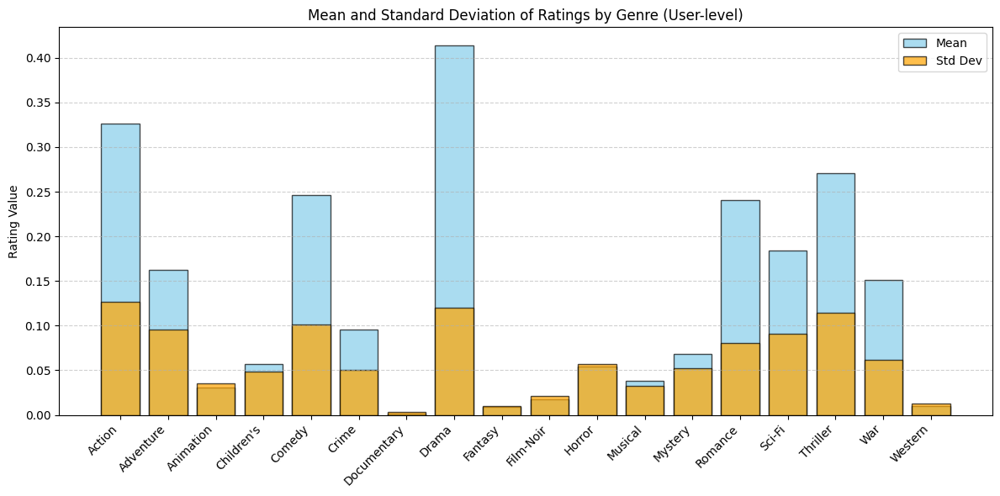

In [129]:
# 統計情報の取得
desc_df = user_genre_matrix.describe().T  # ジャンル別に行表示

# 平均と標準偏差を棒グラフで表示
plt.figure(figsize=(12, 6))
plt.bar(desc_df.index, desc_df["mean"], label="Mean", alpha=0.7, color='skyblue', edgecolor='black')
plt.bar(desc_df.index, desc_df["std"], label="Std Dev", alpha=0.7, color='orange', edgecolor='black')
plt.title("Mean and Standard Deviation of Ratings by Genre (User-level)")
plt.ylabel("Rating Value")
plt.xticks(rotation=45, ha='right')
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

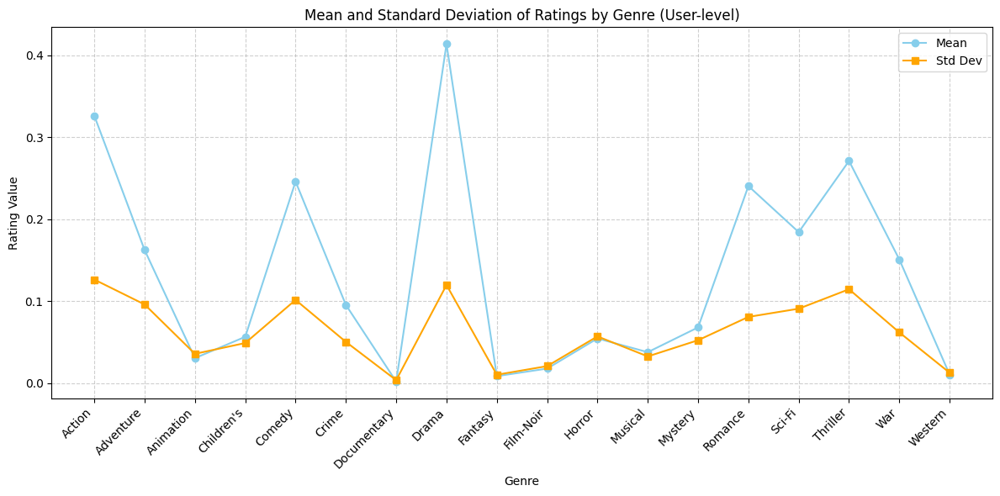

In [130]:
plt.figure(figsize=(12, 6))

# 平均と標準偏差を折れ線で描画
plt.plot(desc_df.index, desc_df["mean"], marker='o', label="Mean", color='skyblue')
plt.plot(desc_df.index, desc_df["std"], marker='s', label="Std Dev", color='orange')

plt.title("Mean and Standard Deviation of Ratings by Genre (User-level)")
plt.xlabel("Genre")
plt.ylabel("Rating Value")
plt.xticks(rotation=45, ha='right')
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()


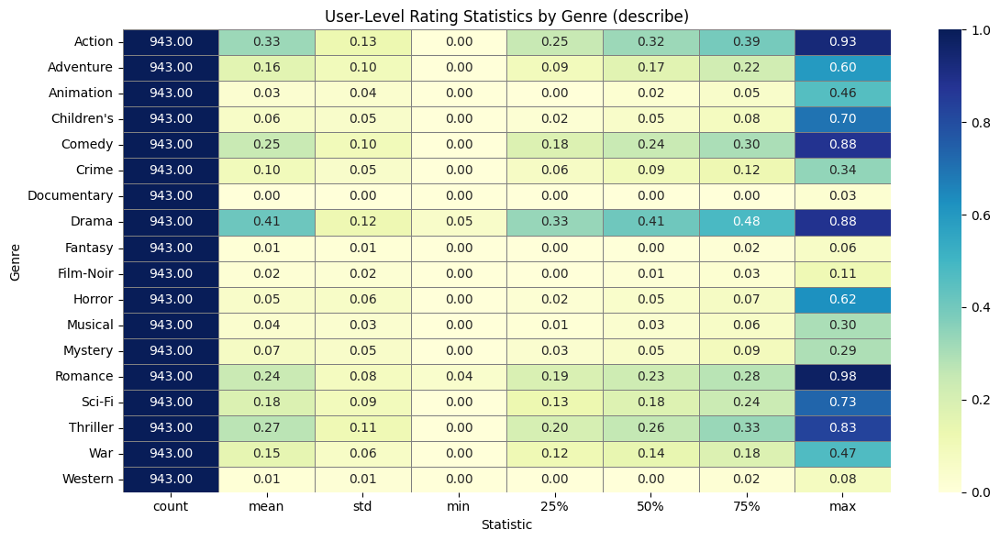

In [131]:
plt.figure(figsize=(12, 6))

# seaborn の heatmap を使ってジャンル別の統計量を表示
sns.heatmap(
    desc_df,
    annot=True,
    fmt=".2f",
    cmap="YlGnBu",
    linewidths=0.5,
    linecolor='gray',
    vmin=0,  # カラーバーの最小値
    vmax=1   # カラーバーの最大値
)

plt.title("User-Level Rating Statistics by Genre (describe)")
plt.ylabel("Genre")
plt.xlabel("Statistic")
plt.tight_layout()
plt.show()


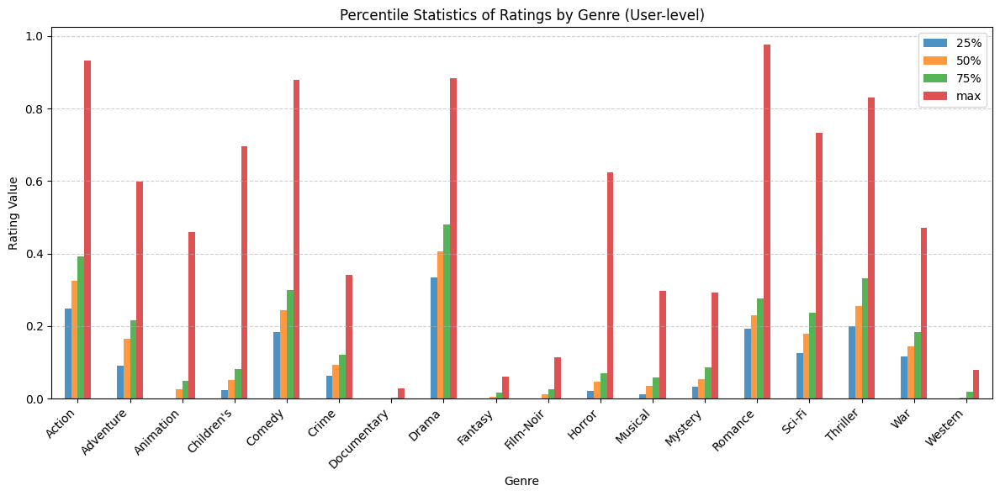

In [132]:
# 描画する列を選択（必要に応じて増減）
cols_to_plot = ["25%", "50%", "75%", "max"]

# 複数指標を1枚に表示
desc_df[cols_to_plot].plot(kind="bar", figsize=(12, 6), alpha=0.8)
plt.title("Percentile Statistics of Ratings by Genre (User-level)")
plt.ylabel("Rating Value")
plt.xlabel("Genre")
plt.xticks(rotation=45, ha='right')
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


In [133]:
df_data

,user_id,item_id,rating,timestamp,timestamp_jap
0,196,242,3,881250949,1997年12月05日 00時55分49秒
1,186,302,3,891717742,1998年04月05日 04時22分22秒
2,22,377,1,878887116,1997年11月07日 16時18分36秒
3,244,51,2,880606923,1997年11月27日 14時02分03秒
4,166,346,1,886397596,1998年02月02日 14時33分16秒
...,...,...,...,...,...
99995,880,476,3,880175444,1997年11月22日 14時10分44秒
99996,716,204,5,879795543,1997年11月18日 04時39分03秒
99997,276,1090,1,874795795,1997年09月21日 07時49分55秒
99998,13,225,2,882399156,1997年12月18日 07時52分36秒


In [134]:
df_item

,movie_id,movie_title,release_date,unknown,url,unknown,Action,Adventure,Animation,Children's,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
0,1,Toy Story (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Toy%20Story%2...,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,GoldenEye (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?GoldenEye%20(...,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,3,Four Rooms (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Four%20Rooms%...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,4,Get Shorty (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Get%20Shorty%...,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
4,5,Copycat (1995),01-Jan-1995,NaN,http://us.imdb.com/M/title-exact?Copycat%20(1995),0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1677,1678,Mat' i syn (1997),06-Feb-1998,NaN,http://us.imdb.com/M/title-exact?Mat%27+i+syn+...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1678,1679,B. Monkey (1998),06-Feb-1998,NaN,http://us.imdb.com/M/title-exact?B%2E+Monkey+(...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0
1679,1680,Sliding Doors (1998),01-Jan-1998,NaN,http://us.imdb.com/Title?Sliding+Doors+(1998),0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
1680,1681,You So Crazy (1994),01-Jan-1994,NaN,http://us.imdb.com/M/title-exact?You%20So%20Cr...,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


# 行列分解

用いる行列: user * itemの行列(user_item_matrix, shape: 943, 1682) -> NaNが発生するため注意する．

- 'SVD', 'NMF', 'MF'は，user * itemデータセットに対して用いる(値はrating)． -> '' を用いる
- 'SVD', 'NMF', 'MF'は，教師なし行列分解である(教師あり行列分解もある(Label = 'rating')．目的変数を予測するために最適化するための行列分解がある)．
教師あり行列分解 -> ①SVD in surprise②FM③Deep Matrix Factrization(AutoEncoder, NN)④LightFM(Lib)

1. SVD(Singular Value Decomposition): 特異値分解．次元削減手法．
前提: user * item行列を0で埋める(NaNは用いることができない)，用いる行列は，user * item
メリット: 高速．類似度分析・クラスタリングを用いられる．PCAを適用可能である．
デメリット: マイナスになることがある(可視化しにくい, マイナスは対極性を示すため直感的に理解しにくい)．
用途: 潜在的なジャンル嗜好分析・UMAP, t-SNEを行うための行列作成・簡易的なレコメンドアルゴリズムを行うためのベース行列

2. NMF(Non-negative Matrix Factrization): 非負値行列因子分解．A ≒ W * H(W: user * 潜在因子, H: 潜在因子 * item, Wが基底行列となる, 潜在因子はジャンルを示す)，実行後は，行列の値が大きいitemをuserにレコメンドする．
前提: user * item行列を非負行列で埋める．
メリット: 柔軟な特徴表現が可能である(topic modelingにも使える, 例えばCrime: 100%, SF: 100%ではなく，Crime: 70%, SF: 30%みたいな感じ)． -> グラデーション的に考えられる．
デメリット: 貪欲法のように計算するから時間がかかる．
用途: 分析寄りも計算寄り．意味解釈のために用いられる．

3. MF(Matrix Factrization): 行列分解．強調フィルタリングにおいて次元削減を行う．
前提: 
メリット: 欠損値の予測ができる(用いる行列の欠損値予測)．評価値(RMSE, MAP)の予測精度が高い．
デメリット: ブラックボックス性が高い．学習と評価が必要．
用途:レコメンド(CFの定番, CF: Collaborative Filtering, 強調フィルタリングのこと．類似userに対して仲間内で推薦し合う)．上位X件推薦．

- SVDは，A = UΣV^Tで表される(非正方行列に適用できる)．
U: 列ベクトル行列(左特異ベクトル) → 
Σ: 対角行列(特異値, 重み) → 
V^T: 行ベクトル行列(右特異ベクトル) → 

- SVDによりマイナスの値になる場合がある
-> マイナス: 潜在因子に対して逆向きの傾向を持つ
-> プラス: 潜在因子を強く持つ


実施すること
- SVD, NMF, MF
- スペクトラルクラスタリング
- 

In [135]:
df_data

,user_id,item_id,rating,timestamp,timestamp_jap
0,196,242,3,881250949,1997年12月05日 00時55分49秒
1,186,302,3,891717742,1998年04月05日 04時22分22秒
2,22,377,1,878887116,1997年11月07日 16時18分36秒
3,244,51,2,880606923,1997年11月27日 14時02分03秒
4,166,346,1,886397596,1998年02月02日 14時33分16秒
...,...,...,...,...,...
99995,880,476,3,880175444,1997年11月22日 14時10分44秒
99996,716,204,5,879795543,1997年11月18日 04時39分03秒
99997,276,1090,1,874795795,1997年09月21日 07時49分55秒
99998,13,225,2,882399156,1997年12月18日 07時52分36秒


In [19]:
# SVD, NMF, MFで用いる'user_item_matrix'行列の作成する

# user_id × item_id の行列（値は rating、未評価はNaN）
user_item_matrix = df_data.pivot_table(index="user_id", columns="item_id", values="rating")

# 結果確認
print(user_item_matrix.shape)  # → (943, 1682)
user_item_matrix.head()


(943, 1682)


item_id,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
user_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,5.0,3.0,4.0,3.0,3.0,5.0,4.0,1.0,5.0,3.0,2.0,5.0,5.0,5.0,5.0,5.0,3.0,4.0,5.0,4.0,1.0,4.0,4.0,3.0,4.0,3.0,2.0,4.0,1.0,3.0,3.0,5.0,4.0,2.0,1.0,2.0,2.0,3.0,4.0,3.0,2.0,5.0,4.0,5.0,5.0,4.0,4.0,5.0,3.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,4.0,4.0,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,4.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,3.0,NaN,NaN,4.0,3.0,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
"""

# SurpriseがPython 3.13に未対応

# 1. Python 3.10 環境を新規で作成（pyenvを使う例）
pyenv install 3.10.13
pyenv virtualenv 3.10.13 py310-surprise
pyenv activate py310-surprise

# 2. 必要なライブラリをインストール
pip install scikit-surprise pandas

"""

'\n\n# SurpriseがPython 3.13に未対応\n\n# 1. Python 3.10 環境を新規で作成（pyenvを使う例）\npyenv install 3.10.13\npyenv virtualenv 3.10.13 py310-surprise\npyenv activate py310-surprise\n\n# 2. 必要なライブラリをインストール\npip install scikit-surprise pandas\n\n'

In [21]:
# 用いるライブラリが使用できるかの確認

from surprise import SVD, Dataset, Reader
import pandas as pd

# テストデータ（小さいデータで動作確認）
df_train = pd.DataFrame({
    "user_id": [1, 1, 2, 2, 3, 3],
    "item_id": [10, 20, 10, 30, 20, 30],
    "rating":  [4, 5, 3, 2, 4, 5]
})

# Surprise形式に変換
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df_train[["user_id", "item_id", "rating"]], reader)
trainset = data.build_full_trainset()

# SVDモデルで学習
model = SVD()
model.fit(trainset)

# ユーザー1に対して item 30 の評価を予測
pred = model.predict(1, 30)
print("予測スコア:", pred.est)



予測スコア: 4.200238295820246


In [22]:
# MFの実行

from surprise import SVD, Dataset, Reader
from surprise.model_selection import train_test_split
from surprise import accuracy
import pandas as pd

# ① MovieLensの評価データを用意（df_data に user_id, item_id, rating がある前提）
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df_data[["user_id", "item_id", "rating"]], reader)

# ② 学習・テストに分割
trainset, testset = train_test_split(data, test_size=0.2, random_state=42)

# ③ MF（SVD）モデルで学習
model = SVD(n_factors=20, random_state=42)
model.fit(trainset)

# ④ テストセットで精度を確認
predictions = model.test(testset)
print("RMSE:", accuracy.rmse(predictions))


RMSE: 0.9350
RMSE: 0.9349581398847258


In [23]:
reader

In [24]:
data

In [25]:
trainset

In [26]:
# 現在用いているデータフレームは欠損値が存在するため，欠損値を予測する．

# ① user_id=1 がまだ評価していない映画を抽出
user_id = 1
rated_items = df_data[df_data["user_id"] == user_id]["item_id"].unique()
all_items = df_data["item_id"].unique()
unrated_items = [item for item in all_items if item not in rated_items]

# ② 未評価アイテムに対して予測スコアを算出
predictions = [model.predict(user_id, item_id) for item_id in unrated_items]

# ③ スコア順にソート
top_n = sorted(predictions, key=lambda x: x.est, reverse=True)[:10]

# ④ 上位10件を表示（タイトル付き）
print("User", user_id, "へのおすすめ映画（予測スコア順）:")
for pred in top_n:
    movie_title = df_item[df_item["movie_id"] == pred.iid]["movie_title"].values[0]
    print(f"  {movie_title:<50} 推定スコア: {pred.est:.2f}")


User 1 へのおすすめ映画（予測スコア順）:
  Close Shave, A (1995)                              推定スコア: 4.73
  Schindler's List (1993)                            推定スコア: 4.65
  L.A. Confidential (1997)                           推定スコア: 4.60
  It's a Wonderful Life (1946)                       推定スコア: 4.59
  One Flew Over the Cuckoo's Nest (1975)             推定スコア: 4.59
  To Kill a Mockingbird (1962)                       推定スコア: 4.57
  Rear Window (1954)                                 推定スコア: 4.46
  Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963) 推定スコア: 4.45
  North by Northwest (1959)                          推定スコア: 4.41
  Casablanca (1942)                                  推定スコア: 4.39


In [27]:
# MFにより欠損値を埋めた行列の確認

# ① ユーザーIDとアイテムIDの一覧を取得（ユニークなID順でソート）
user_ids = sorted(df_data["user_id"].unique())
item_ids = sorted(df_data["item_id"].unique())

# ② 空の DataFrame を作成（行: user_id、列: item_id）
pred_matrix = pd.DataFrame(index=user_ids, columns=item_ids)

# ③ 各セルに model.predict() で埋めていく
for user in user_ids:
    for item in item_ids:
        pred = model.predict(user, item).est
        pred_matrix.loc[user, item] = round(pred, 3)  # 小数3桁に丸める

# ④ 数値型に変換
pred_matrix = pred_matrix.astype(float)

# 結果確認（先頭5×5を表示）
# カラムの10, 20, 30,などは映画のid番号
pred_matrix.iloc[:, :]


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,

In [33]:
import pandas as pd
import numpy as np

# ① ユニークな user_id と item_id を取得
user_ids = sorted(df_data["user_id"].unique())
item_ids = sorted(df_data["item_id"].unique())

# ② 空の DataFrame を作成（行：ユーザー、列：映画）
mf_matrix = pd.DataFrame(index=user_ids, columns=item_ids)

# ③ 各ユーザー×アイテムの予測スコアをSVDで埋める
for user in user_ids:
    for item in item_ids:
        pred = model.predict(user, item).est
        mf_matrix.at[user, item] = round(pred, 3)

# ④ データ型を float に変換
mf_matrix = mf_matrix.astype(float)

# ⑤ 確認（行数・列数）
print("行列サイズ:", mf_matrix.shape)
mf_matrix.head()


行列サイズ: (943, 1682)


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052


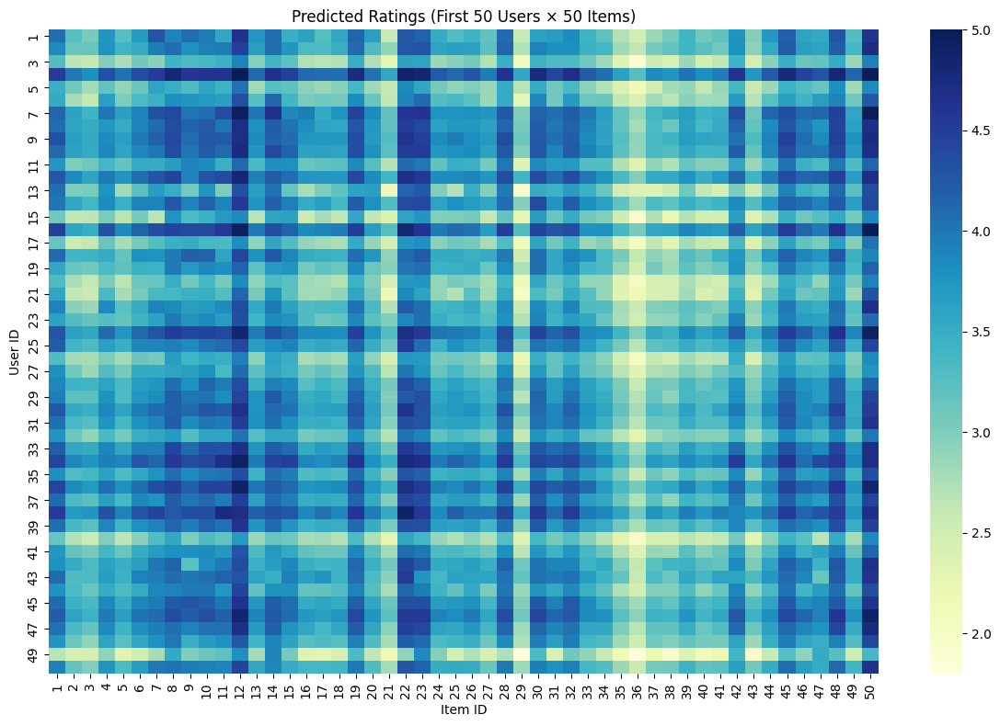

In [29]:
# userとitemを50個ずつHMで可視化する

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 8))
sns.heatmap(mf_matrix.iloc[:50, :50], cmap="YlGnBu", cbar=True)
plt.title("Predicted Ratings (First 50 Users × 50 Items)")
plt.xlabel("Item ID")
plt.ylabel("User ID")
plt.tight_layout()
plt.show()


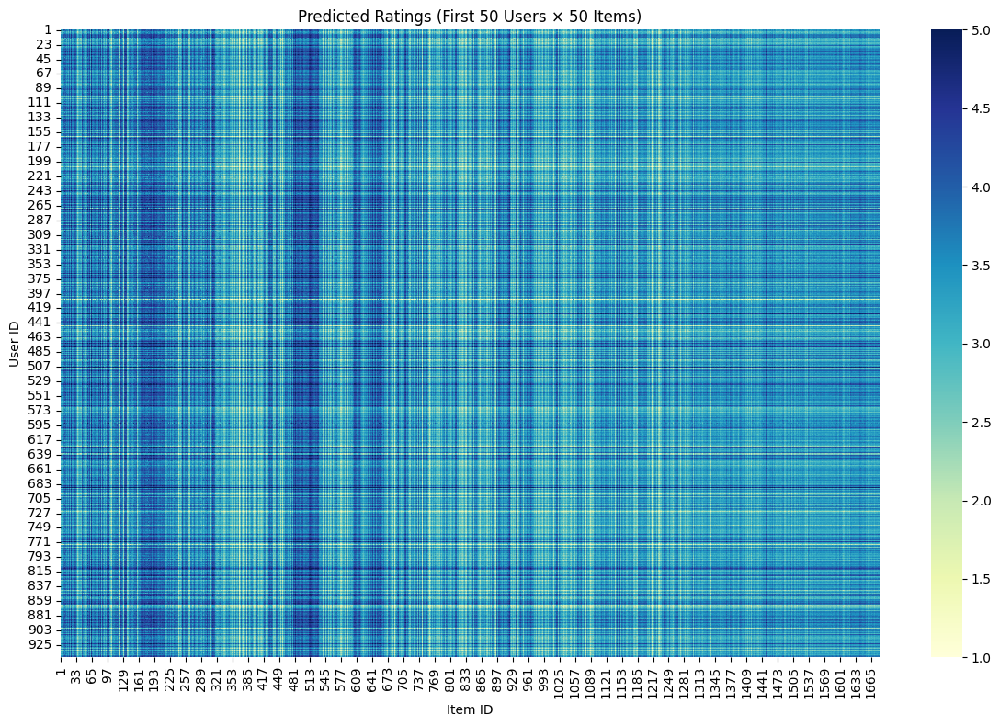

In [30]:
# userとitemを全てHMで可視化する

plt.figure(figsize=(12, 8))
sns.heatmap(mf_matrix.iloc[:943, :1682], cmap="YlGnBu", cbar=True)
plt.title("Predicted Ratings (First 50 Users × 50 Items)")
plt.xlabel("Item ID")
plt.ylabel("User ID")
plt.tight_layout()
plt.show()


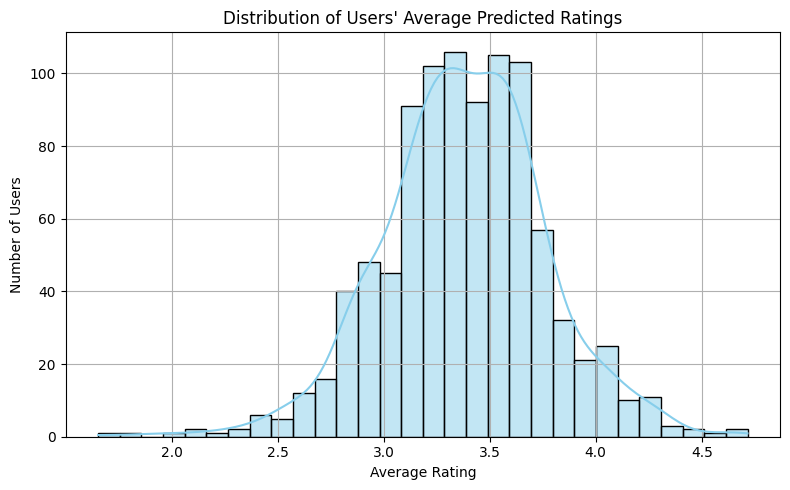

In [34]:
# 甘口と辛口評価の可視化

user_means = mf_matrix.mean(axis=1)

plt.figure(figsize=(8, 5))
sns.histplot(user_means, bins=30, kde=True, color='skyblue')
plt.title("Distribution of Users' Average Predicted Ratings")
plt.xlabel("Average Rating")
plt.ylabel("Number of Users")
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
pip install umap-learn

In [35]:
mf_matrix

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,

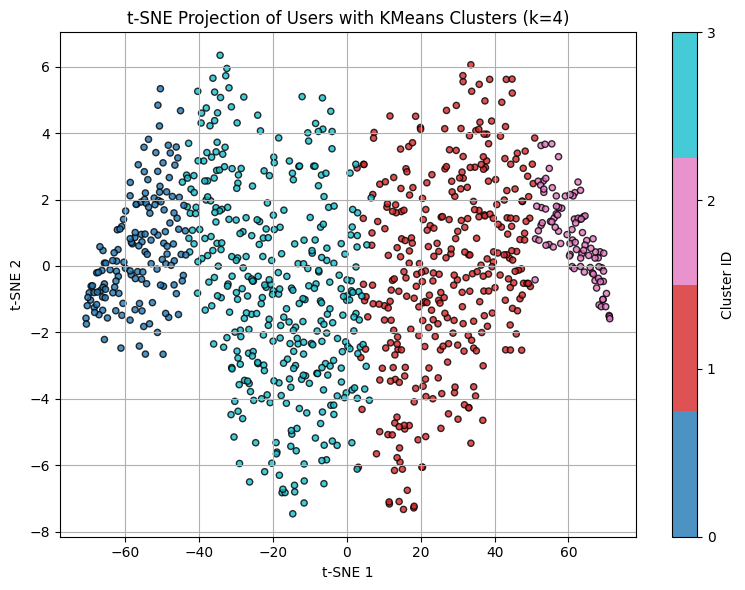

In [36]:
# 'mf_matrix'に対して，t-SNEを行って次元削減を行って，k-meansでクラスタリングを行う(まだmf_matrixにカラムは追加していない)．

import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# 特徴量（ユーザー × アイテム MF行列）
X = mf_matrix.values

# t-SNE による次元圧縮
embedding_tsne = TSNE(n_components=2, random_state=42, perplexity=30).fit_transform(X)

# クラスタリング
n_clusters = 4
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=150)
cluster_labels = kmeans.fit_predict(X)

# プロット
plt.figure(figsize=(8, 6))
scatter = plt.scatter(
    embedding_tsne[:, 0], embedding_tsne[:, 1],
    c=cluster_labels, cmap=plt.cm.get_cmap('tab10', n_clusters),
    s=20, alpha=0.8, edgecolors='k'
)

# カラーバーの追加（0〜3 に限定）
cbar = plt.colorbar(scatter, ticks=np.arange(n_clusters))
cbar.set_label("Cluster ID")
cbar.set_ticks([0, 1, 2, 3])

# 軸やタイトル
plt.title("t-SNE Projection of Users with KMeans Clusters (k=4)")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.grid(True)
plt.tight_layout()
plt.show()


In [32]:
mf_matrix

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,

In [188]:
mf_matrix_tsne

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,cluster_tsne
0,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589,3
1,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329,1
2,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862,0
3,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211,2
4,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
938,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,5.000,3.845,

In [196]:
cluster_profile_tsne

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
cluster_tsne,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,3.249773,2.615707,2.534107,2.994220,2.680947,3.018700,3.150167,3.425893,3.284520,3.372753,3.250493,3.793460,2.878633,3.360073,3.160107,2.702247,2.740580,2.732327,3.400547,2.751013,2.283260,3.608873,3.554300,2.874327,2.911047,2.915593,2.613960,3.339767,2.142873,3.383913,3.034053,3.296267,2.894093,2.736513,2.297780,1.965920,2.450927,2.347187,2.704813,2.504493,2.604000,3.185153,2.374853,2.880707,3.443667,3.054067,3.006960,3.531880,2.771920,3.763227,...,2.882233,2.853647,2.896013,2.853647,2.865660,2.870487,3.123187,2.868913,2.869207,3.116747,3.051800,2.762493,2.979307,2.862060,2.874240,2.782760,2.864247,2.970667,2.965113,2.448887,2.997107,2.626713,2.717947,2.867507,2.853947,2.755960,2.587440,2.687707,2.626860,2.768040,2.777400,2.843000,2.767433,2.771820,2.848440,2.856093,2.758947,2.853647,2.853647,2.685600,2.853647,2.880247,2.783373,2.853647,2.849073,2.643973,2.815527,2.733247,2.852987,2.824767
1,4.070372,3.471065,3.376935,3.789333,3.495842,3.847000,3.981366,4.220786,4.046815,4.165848,4.054039,4.584875,3.692905,4.123107,3.968488,3.532268,3.558330,3.532795,4.203083,3.589560,3.120533,4.434667,4.347780,3.658917,3.716312,3.720810,3.462926,4.160298,2.989679,4.191815,3.878464,4.117637,3.728256,3.544759,3.114122,2.768315,3.269798,3.190577,3.532577,3.321283,3.422185,3.962327,3.202039,3.684771,4.250506,3.886563,3.801777,4.327601,3.587905,4.561482,...,3.685369,3.669702,3.695824,3.669702,3.692518,3.693646,3.942893,3.679887,3.688807,3.922637,3.859372,3.579601,3.787533,3.685452,3.684815,3.599842,3.688125,3.786500,3.775283,3.279060,3.812315,3.447527,3.544238,3.697417,3.668646,3.587259,3.399321,3.501122,3.448938,3.579042,3.599179,3.670152,3.581917,3.581738,3.672679,3.681833,3.588824,3.669702,3.669702,3.513592,3.669702,3.692214,3.621679,3.669702,3.651173,3.459298,3.651149,3.548369,3.679857,3.646479
2,4.535379,3.955989,3.833316,4.200800,3.971632,4.320358,4.420032,4.653768,4.454600,4.599863,4.530147,4.932347,4.125663,4.513968,4.436074,3.990716,4.017263,3.995400,4.648579,4.025547,3.603242,4.856032,4.747968,4.112263,4.204674,4.170221,3.934642,4.638074,3.475537,4.627979,4.349305,4.553463,4.174316,3.991621,3.575337,3.221421,3.736179,3.695705,3.981768,3.798432,3.907874,4.411242,3.672179,4.163116,4.694347,4.343789,4.253579,4.747116,4.037232,4.894526,...,4.144253,4.128000,4.147768,4.128000,4.151642,4.147621,4.415579,4.140695,4.142011,4.382337,4.309537,4.043411,4.231895,4.138505,4.144737,4.045579,4.141516,4.247600,4.230832,3.740642,4.266200,3.915389,4.003232,4.167895,4.115726,4.045305,3.864000,3.956516,3.902979,4.041537,4.038937,4.132779,4.051947,4.038726,4.152800,4.143105,4.039621,4.128000,4.128000,3.969411,4.128000,4.133611,4.071842,4.128000,4.104989,3.944295,4.116200,4.023221,4.130811,4.092695
3,3.713807,3.105812,3.015262,3.439099,3.146475,3.479119,3.630304,3.865663,3.702157,3.816936,3.701028,4.238436,3.330605,3.778191,3.612942,3.170238,3.199903,3.183859,3.847715,3.220533,2.756815,4.079859,3.988356,3.306773,3.361144,3.364285,3.097293,3.809854,2.624146,3.823075,3.502083,3.748994,3.361157,3.183193,2.752519,2.415660,2.906470,2.833047,3.169370,2.965696,3.065760,3.615923,2.835483,3.338831,3.895881,3.517362,3.452185,3.978829,3.218829,4.208215,...,3.329594,3.309428,3.338370,3.309428,3.327157,3.323558,3.578478,3.319373,3.324351,3.566022,3.503834,3.222276,3.425290,3.323948,3.326992,3.234243,3.327050,3.426760,3.425608,2.911124,3.456301,3.088061,3.184470,3.333768,3.307293,3.213677,3.044704,3.143041,3.087301,3.216276,3.230047,3.306119,3.223290,3.223445,3.310483,3

In [193]:
mf_matrix_tsne.shape

(943, 1683)

In [194]:
cluster_labels.shape

(943,)

In [197]:
mf_matrix.info()

<class 'pandas.core.frame.DataFrame'>
Index: 943 entries, 1 to 943
Columns: 1682 entries, 1 to 1682
dtypes: float64(1682)
memory usage: 12.1 MB


In [72]:
"""

# t-SNEで次元削減をして，k-means(k=4)でクラスタリングして，clusterを追加してclusterごとにヒートマップでraitingを可視化する

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# ① MF後の user × item 行列
mf_matrix_tsne = mf_matrix.copy()
X = mf_matrix_tsne.values  # (943, 1682)

# ② t-SNE による次元削減
embedding_tsne = TSNE(n_components=2, random_state=42, perplexity=30).fit_transform(X)

# ③ k-means によるクラスタリング（4クラスタ）
labels = KMeans(n_clusters=4, random_state=42, n_init=150).fit_predict(X)

# ④ クラスタ列を追加（t-SNEベース）
mf_matrix_tsne["cluster_tsne"] = labels

# ⑤ クラスタごとの平均ratingを算出（t-SNEクラスタでgroupby）
cluster_profile = mf_matrix_tsne.groupby("cluster_tsne").mean()
cluster_profile = cluster_profile.drop(columns=["cluster_tsne"], errors="ignore")

# ⑥ ヒートマップで可視化
plt.figure(figsize=(14, 6))
sns.heatmap(cluster_profile, fmt=".2f", cmap="coolwarm", linewidths=0.5, linecolor='gray')
plt.title("Genre Preference by Cluster (t-SNE + MF + KMeans)", fontsize=14)
plt.xlabel("Item (Movie ID)")
plt.ylabel("Cluster (t-SNE-based)")
plt.tight_layout()
plt.show()

"""
【UMAPの時】
X = mf_matrix.values
# 次元圧縮（UMAP）
embedding = umap.UMAP(random_state=42).fit_transform(X)
# クラスタリング（任意：4クラスタ）
labels = KMeans(n_clusters=4, random_state=42).fit_predict(X)

【HMによる可視化】
mf_matrix['cluster'] = labels
# clusterごとのジャンル評価傾向の平均を集計
cluster_profile = mf_matrix.groupby('cluster').mean()
# 可視化
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 6))
sns.heatmap(cluster_profile, fmt=".2f", cmap="coolwarm")
plt.title("Genre Preference by Cluster (after MF)")
plt.xlabel("Genre")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()
"""

"""

SyntaxError: invalid character '【' (U+3010) (2809942186.py, line 39)

In [64]:
# ヒートマップの可視化は灰色になって失敗してるけど，t-SNEは行われていることに注意すること．

In [50]:
# t-SNEで次元削減をして，HMで可視化すると灰色になる原因の特定

cluster_profile_tsne.describe()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mean,3.892333,3.287143,3.189905,3.605863,3.323724,3.666294,3.795467,4.041528,3.872023,3.988850,3.883927,4.387280,3.506952,3.943835,3.794403,3.348867,3.379019,3.361095,4.024981,3.396663,2.940962,4.244858,4.159601,3.488070,3.548294,3.542727,3.277205,3.986998,2.808059,4.006696,3.690976,3.929090,3.539456,3.364022,2.934940,2.592829,3.090843,3.016629,3.347132,3.147476,3.249954,3.793661,3.021139,3.516856,4.071100,3.700445,3.628625,4.146356,3.403971,4.356863,...,3.510362,3.490194,3.519494,3.490194,3.509244,3.508828,3.765034,3.502217,3.506094,3.746936,3.681136,3.401945,3.606006,3.502491,3.507696,3.415606,3.505234,3.607882,3.599209,3.094928,3.632981,3.269423,3.362471,3.516647,3.486403,3.400550,3.223866,3.322096,3.266519,3.401224,3.411391,3.488012,3.406147,3.403932,3.496100,3.500476,3.402132,3.490194,3.490194,3.329967,3.490194,3.508798,3.432106,3.490194,3.475896,3.287476,3.466421,3.374525,3.496315,3.462189
std,0.544659,0.567125,0.550614,0.513007,0.545890,0.552228,0.538000,0.521826,0.497983,0.520831,0.541981,0.486799,0.530178,0.491734,0.540773,0.546392,0.541355,0.534972,0.529760,0.541784,0.558970,0.529547,0.509019,0.525470,0.547775,0.532479,0.559457,0.549005,0.564154,0.529728,0.558503,0.534881,0.543745,0.533233,0.542053,0.532393,0.545274,0.569578,0.542010,0.547851,0.551877,0.520169,0.550373,0.542287,0.530722,0.547679,0.528566,0.516207,0.538088,0.484923,...,0.535309,0.540644,0.531462,0.540644,0.545778,0.542838,0.548213,0.539668,0.540503,0.536803,0.533590,0.542899,0.532322,0.541608,0.538861,0.536717,0.541885,0.541600,0.536086,0.548332,0.538108,0.546187,0.544888,0.551250,0.535830,0.548023,0.540892,0.538222,0.541492,0.540601,0.536628,0.547121,0.544471,0.537500,0.552676,0.545695,0.543965,0.540644,0.540644,0.544594,0.540644,0.532727,0.547315,0.540644,0.532576,0.550547,0.551880,0.546236,0.541808,0.538290
min,3.249773,2.615707,2.534107,2.994220,2.680947,3.018700,3.150167,3.425893,3.284520,3.372753,3.250493,3.793460,2.878633,3.360073,3.160107,2.702247,2.740580,2.732327,3.400547,2.751013,2.283260,3.608873,3.554300,2.874327,2.911047,2.915593,2.613960,3.339767,2.142873,3.383913,3.034053,3.296267,2.894093,2.736513,2.297780,1.965920,2.450927,2.347187,2.704813,2.504493,2.604000,3.185153,2.374853,2.880707,3.443667,3.054067,3.006960,3.531880,2.771920,3.763227,...,2.882233,2.853647,2.896013,2.853647,2.865660,2.870487,3.123187,2.868913,2.869207,3.116747,3.051800,2.762493,2.979307,2.862060,2.874240,2.782760,2.864247,2.970667,2.965113,2.448887,2.997107,2.626713,2.717947,2.867507,2.853947,2.755960,2.587440,2.687707,2.626860,2.768040,2.777400,2.843000,2.767433,2.771820,2.848440,2.856093,2.758947,2.853647,2.853647,2.685600,2.853647,2.880247,2.783373,2.853647,2.849073,2.643973,2.815

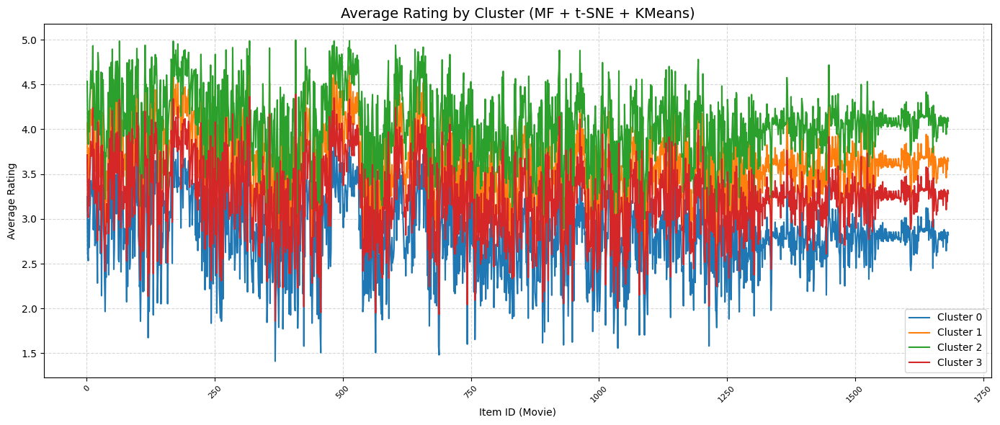

In [51]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_tsne.index:
    plt.plot(
        cluster_profile_tsne.columns,  # 横軸 = ジャンル（アイテムID）
        cluster_profile_tsne.loc[cluster_id],  # 縦軸 = 各ジャンルの平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + t-SNE + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


In [62]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# ① MF後の user × item 行列
mf_matrix_tsne = mf_matrix.copy()
X = mf_matrix_tsne.values  # (943, 1682)

# ② t-SNE による次元削減
embedding_tsne = TSNE(n_components=2, random_state=42, perplexity=30).fit_transform(X)

# ③ k-means によるクラスタリング（3クラスタ）
labels = KMeans(n_clusters=3, random_state=42, n_init=150).fit_predict(X)

# ④ クラスタ列を追加（t-SNEベース）
mf_matrix_tsne["cluster_tsne"] = labels

# ⑤ クラスタごとの平均ratingを算出（t-SNEクラスタでgroupby）
cluster_profile = mf_matrix_tsne.groupby("cluster_tsne").mean()
cluster_profile = cluster_profile.drop(columns=["cluster_tsne"], errors="ignore")

# 集約統計量で確認する
cluster_profile_tsne.describe()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mean,3.892333,3.287143,3.189905,3.605863,3.323724,3.666294,3.795467,4.041528,3.872023,3.988850,3.883927,4.387280,3.506952,3.943835,3.794403,3.348867,3.379019,3.361095,4.024981,3.396663,2.940962,4.244858,4.159601,3.488070,3.548294,3.542727,3.277205,3.986998,2.808059,4.006696,3.690976,3.929090,3.539456,3.364022,2.934940,2.592829,3.090843,3.016629,3.347132,3.147476,3.249954,3.793661,3.021139,3.516856,4.071100,3.700445,3.628625,4.146356,3.403971,4.356863,...,3.510362,3.490194,3.519494,3.490194,3.509244,3.508828,3.765034,3.502217,3.506094,3.746936,3.681136,3.401945,3.606006,3.502491,3.507696,3.415606,3.505234,3.607882,3.599209,3.094928,3.632981,3.269423,3.362471,3.516647,3.486403,3.400550,3.223866,3.322096,3.266519,3.401224,3.411391,3.488012,3.406147,3.403932,3.496100,3.500476,3.402132,3.490194,3.490194,3.329967,3.490194,3.508798,3.432106,3.490194,3.475896,3.287476,3.466421,3.374525,3.496315,3.462189
std,0.544659,0.567125,0.550614,0.513007,0.545890,0.552228,0.538000,0.521826,0.497983,0.520831,0.541981,0.486799,0.530178,0.491734,0.540773,0.546392,0.541355,0.534972,0.529760,0.541784,0.558970,0.529547,0.509019,0.525470,0.547775,0.532479,0.559457,0.549005,0.564154,0.529728,0.558503,0.534881,0.543745,0.533233,0.542053,0.532393,0.545274,0.569578,0.542010,0.547851,0.551877,0.520169,0.550373,0.542287,0.530722,0.547679,0.528566,0.516207,0.538088,0.484923,...,0.535309,0.540644,0.531462,0.540644,0.545778,0.542838,0.548213,0.539668,0.540503,0.536803,0.533590,0.542899,0.532322,0.541608,0.538861,0.536717,0.541885,0.541600,0.536086,0.548332,0.538108,0.546187,0.544888,0.551250,0.535830,0.548023,0.540892,0.538222,0.541492,0.540601,0.536628,0.547121,0.544471,0.537500,0.552676,0.545695,0.543965,0.540644,0.540644,0.544594,0.540644,0.532727,0.547315,0.540644,0.532576,0.550547,0.551880,0.546236,0.541808,0.538290
min,3.249773,2.615707,2.534107,2.994220,2.680947,3.018700,3.150167,3.425893,3.284520,3.372753,3.250493,3.793460,2.878633,3.360073,3.160107,2.702247,2.740580,2.732327,3.400547,2.751013,2.283260,3.608873,3.554300,2.874327,2.911047,2.915593,2.613960,3.339767,2.142873,3.383913,3.034053,3.296267,2.894093,2.736513,2.297780,1.965920,2.450927,2.347187,2.704813,2.504493,2.604000,3.185153,2.374853,2.880707,3.443667,3.054067,3.006960,3.531880,2.771920,3.763227,...,2.882233,2.853647,2.896013,2.853647,2.865660,2.870487,3.123187,2.868913,2.869207,3.116747,3.051800,2.762493,2.979307,2.862060,2.874240,2.782760,2.864247,2.970667,2.965113,2.448887,2.997107,2.626713,2.717947,2.867507,2.853947,2.755960,2.587440,2.687707,2.626860,2.768040,2.777400,2.843000,2.767433,2.771820,2.848440,2.856093,2.758947,2.853647,2.853647,2.685600,2.853647,2.880247,2.783373,2.853647,2.849073,2.643973,2.815

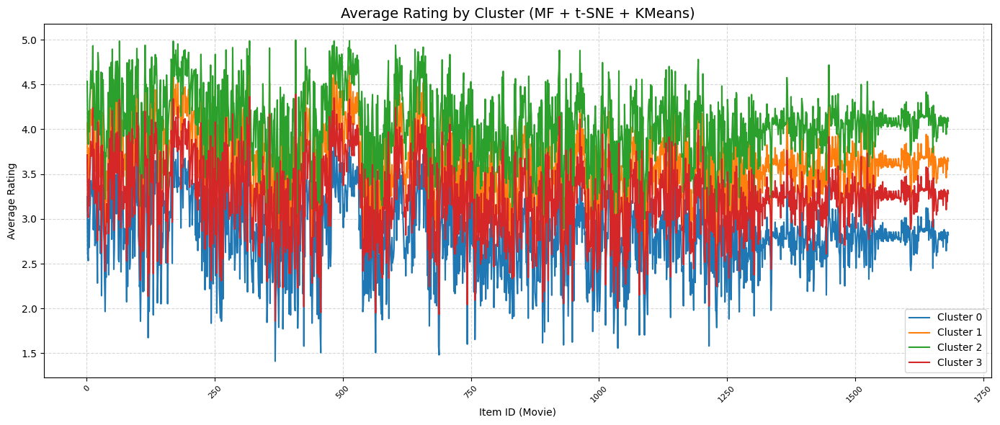

In [63]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_tsne.index:
    plt.plot(
        cluster_profile_tsne.columns,  # 横軸 = ジャンル（アイテムID）
        cluster_profile_tsne.loc[cluster_id],  # 縦軸 = 各ジャンルの平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + t-SNE + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


In [71]:
"""

# 灰色になる原因の特定

# [A] cluster_labels の形状
print(mf_matrix.shape)             # → (943, 1682)
print(len(cluster_labels))         # → 943

# [B] インデックス揃えたうえで追加
mf_matrix_tsne = mf_matrix.reset_index(drop=True)
mf_matrix_tsne["cluster_tsne"] = cluster_labels

# [C] グループ平均 → float に変換
cluster_profile_tsne = mf_matrix_tsne.groupby("cluster_tsne").mean()
cluster_profile_tsne = cluster_profile_tsne.drop(columns=["cluster_tsne"], errors="ignore")
cluster_profile_tsne = cluster_profile_tsne.astype(float)

# [D] データ確認
print(cluster_profile_tsne.head())
print(cluster_profile_tsne.dtypes.value_counts())  # float64 がすべてになるべき

# [E] ヒートマップ
plt.figure(figsize=(14, 6))
sns.heatmap(cluster_profile_tsne, cmap="coolwarm", linewidths=0.5, linecolor='gray')
plt.title("Genre Preference by Cluster (t-SNE + MF + KMeans)")
plt.xlabel("Item ID (Movie)")
plt.ylabel("Cluster (t-SNE-based)")
plt.tight_layout()
plt.show()

"""

'\n\n# 灰色になる原因の特定\n\n# [A] cluster_labels の形状\nprint(mf_matrix.shape)             # → (943, 1682)\nprint(len(cluster_labels))         # → 943\n\n# [B] インデックス揃えたうえで追加\nmf_matrix_tsne = mf_matrix.reset_index(drop=True)\nmf_matrix_tsne["cluster_tsne"] = cluster_labels\n\n# [C] グループ平均 → float に変換\ncluster_profile_tsne = mf_matrix_tsne.groupby("cluster_tsne").mean()\ncluster_profile_tsne = cluster_profile_tsne.drop(columns=["cluster_tsne"], errors="ignore")\ncluster_profile_tsne = cluster_profile_tsne.astype(float)\n\n# [D] データ確認\nprint(cluster_profile_tsne.head())\nprint(cluster_profile_tsne.dtypes.value_counts())  # float64 がすべてになるべき\n\n# [E] ヒートマップ\nplt.figure(figsize=(14, 6))\nsns.heatmap(cluster_profile_tsne, cmap="coolwarm", linewidths=0.5, linecolor=\'gray\')\nplt.title("Genre Preference by Cluster (t-SNE + MF + KMeans)")\nplt.xlabel("Item ID (Movie)")\nplt.ylabel("Cluster (t-SNE-based)")\nplt.tight_layout()\nplt.show()\n\n'

In [199]:
print(cluster_profile_tsne.describe())
print(cluster_profile_tsne.values.min(), cluster_profile_tsne.values.max())

           1         2         3         4         5         6         7     \
count  4.000000  4.000000  4.000000  4.000000  4.000000  4.000000  4.000000   
mean   3.892333  3.287143  3.189905  3.605863  3.323724  3.666294  3.795467   
std    0.544659  0.567125  0.550614  0.513007  0.545890  0.552228  0.538000   
min    3.249773  2.615707  2.534107  2.994220  2.680947  3.018700  3.150167   
25%    3.597798  2.983286  2.894973  3.327880  3.030093  3.364014  3.510270   
50%    3.892089  3.288439  3.196098  3.614216  3.321159  3.663059  3.805835   
75%    4.186624  3.592296  3.491030  3.892200  3.614790  3.965339  4.091032   
max    4.535379  3.955989  3.833316  4.200800  3.971632  4.320358  4.420032   

           8         9         10        11        12        13        14    \
count  4.000000  4.000000  4.000000  4.000000  4.000000  4.000000  4.000000   
mean   4.041528  3.872023  3.988850  3.883927  4.387280  3.506952  3.943835   
std    0.521826  0.497983  0.520831  0.541981  0.48

In [44]:
mf_matrix_tsne.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,cluster_tsne
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589,3
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329,1
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862,0
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211,2
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052,0


In [201]:
cluster_profile_tsne.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
cluster_tsne,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,3.249773,2.615707,2.534107,2.994220,2.680947,3.018700,3.150167,3.425893,3.284520,3.372753,3.250493,3.793460,2.878633,3.360073,3.160107,2.702247,2.740580,2.732327,3.400547,2.751013,2.283260,3.608873,3.554300,2.874327,2.911047,2.915593,2.613960,3.339767,2.142873,3.383913,3.034053,3.296267,2.894093,2.736513,2.297780,1.965920,2.450927,2.347187,2.704813,2.504493,2.604000,3.185153,2.374853,2.880707,3.443667,3.054067,3.006960,3.531880,2.771920,3.763227,...,2.882233,2.853647,2.896013,2.853647,2.865660,2.870487,3.123187,2.868913,2.869207,3.116747,3.051800,2.762493,2.979307,2.862060,2.874240,2.782760,2.864247,2.970667,2.965113,2.448887,2.997107,2.626713,2.717947,2.867507,2.853947,2.755960,2.587440,2.687707,2.626860,2.768040,2.777400,2.843000,2.767433,2.771820,2.848440,2.856093,2.758947,2.853647,2.853647,2.685600,2.853647,2.880247,2.783373,2.853647,2.849073,2.643973,2.815527,2.733247,2.852987,2.824767
1,4.070372,3.471065,3.376935,3.789333,3.495842,3.847000,3.981366,4.220786,4.046815,4.165848,4.054039,4.584875,3.692905,4.123107,3.968488,3.532268,3.558330,3.532795,4.203083,3.589560,3.120533,4.434667,4.347780,3.658917,3.716312,3.720810,3.462926,4.160298,2.989679,4.191815,3.878464,4.117637,3.728256,3.544759,3.114122,2.768315,3.269798,3.190577,3.532577,3.321283,3.422185,3.962327,3.202039,3.684771,4.250506,3.886563,3.801777,4.327601,3.587905,4.561482,...,3.685369,3.669702,3.695824,3.669702,3.692518,3.693646,3.942893,3.679887,3.688807,3.922637,3.859372,3.579601,3.787533,3.685452,3.684815,3.599842,3.688125,3.786500,3.775283,3.279060,3.812315,3.447527,3.544238,3.697417,3.668646,3.587259,3.399321,3.501122,3.448938,3.579042,3.599179,3.670152,3.581917,3.581738,3.672679,3.681833,3.588824,3.669702,3.669702,3.513592,3.669702,3.692214,3.621679,3.669702,3.651173,3.459298,3.651149,3.548369,3.679857,3.646479
2,4.535379,3.955989,3.833316,4.200800,3.971632,4.320358,4.420032,4.653768,4.454600,4.599863,4.530147,4.932347,4.125663,4.513968,4.436074,3.990716,4.017263,3.995400,4.648579,4.025547,3.603242,4.856032,4.747968,4.112263,4.204674,4.170221,3.934642,4.638074,3.475537,4.627979,4.349305,4.553463,4.174316,3.991621,3.575337,3.221421,3.736179,3.695705,3.981768,3.798432,3.907874,4.411242,3.672179,4.163116,4.694347,4.343789,4.253579,4.747116,4.037232,4.894526,...,4.144253,4.128000,4.147768,4.128000,4.151642,4.147621,4.415579,4.140695,4.142011,4.382337,4.309537,4.043411,4.231895,4.138505,4.144737,4.045579,4.141516,4.247600,4.230832,3.740642,4.266200,3.915389,4.003232,4.167895,4.115726,4.045305,3.864000,3.956516,3.902979,4.041537,4.038937,4.132779,4.051947,4.038726,4.152800,4.143105,4.039621,4.128000,4.128000,3.969411,4.128000,4.133611,4.071842,4.128000,4.104989,3.944295,4.116200,4.023221,4.130811,4.092695
3,3.713807,3.105812,3.015262,3.439099,3.146475,3.479119,3.630304,3.865663,3.702157,3.816936,3.701028,4.238436,3.330605,3.778191,3.612942,3.170238,3.199903,3.183859,3.847715,3.220533,2.756815,4.079859,3.988356,3.306773,3.361144,3.364285,3.097293,3.809854,2.624146,3.823075,3.502083,3.748994,3.361157,3.183193,2.752519,2.415660,2.906470,2.833047,3.169370,2.965696,3.065760,3.615923,2.835483,3.338831,3.895881,3.517362,3.452185,3.978829,3.218829,4.208215,...,3.329594,3.309428,3.338370,3.309428,3.327157,3.323558,3.578478,3.319373,3.324351,3.566022,3.503834,3.222276,3.425290,3.323948,3.326992,3.234243,3.327050,3.426760,3.425608,2.911124,3.456301,3.088061,3.184470,3.333768,3.307293,3.213677,3.044704,3.143041,3.087301,3.216276,3.230047,3.306119,3.223290,3.223445,3.310483,3

In [203]:
print(cluster_profile_tsne.dtypes.value_counts())
# 結果：float64    1682  ←ならOK

float64    1682
Name: count, dtype: int64


In [45]:
print("mf_matrix shape: ", mf_matrix.shape)
mf_matrix.head()

mf_matrix shape:  (943, 1682)


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052


In [207]:
# UMAPを行う前に，mf_matrixに追加した'cluster_tsne'を削除する
mf_matrix = mf_matrix.drop(columns=["cluster"], axis=1)

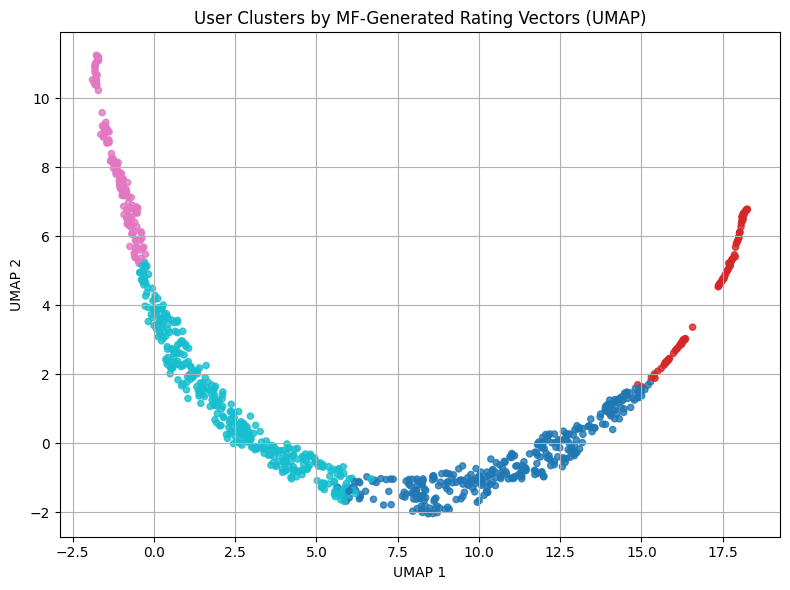

In [41]:
# UMAPによるuserの嗜好クラスタの可視化(MF後のデータフレームを用いた)

import umap
from sklearn.cluster import KMeans

# ユーザー行列（user × item）のまま使う
# (1回目と2回目でUMAPの結果がことなったの原因は，mf_matrixにcluster番号を入れたため)
"""mf_matrix = mf_matrix.drop(columns=["cluster_tsne"], axis=1)"""
X = mf_matrix.values

# 次元圧縮（UMAP）
embedding = umap.UMAP(random_state=42).fit_transform(X)

# クラスタリング（任意：4クラスタ）
labels = KMeans(n_clusters=4, random_state=42).fit_predict(X)

# 可視化
plt.figure(figsize=(8, 6))
plt.scatter(embedding[:, 0], embedding[:, 1], c=labels, cmap='tab10', s=20, alpha=0.8)
plt.title("User Clusters by MF-Generated Rating Vectors (UMAP)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# クラスタ分けできているとは言えない． -> 言えて3種類？
# 疎行列に対してUMAPを行ってk-meansを行った結果とは全く異なる
# -> 用いている行列が異なるから(前者は疎行列で，後者はMF後の行列(rating行列))

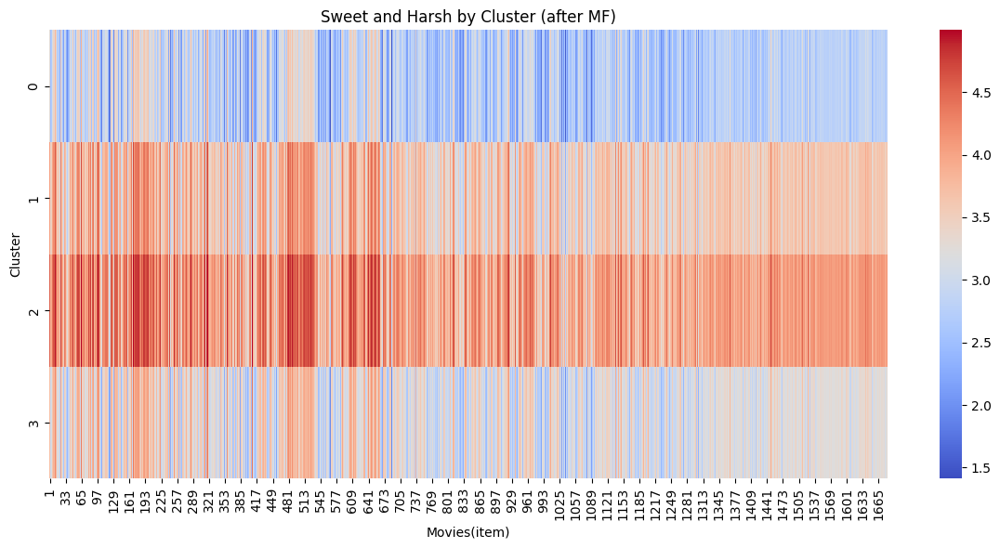

In [55]:
# クラスタ列を追加（再度）
# ここでのlabelsは'UMAP'で次元削減をしてk-meansを行った時に作成したlabel
mf_matrix['cluster'] = labels

# clusterごとのジャンル評価傾向の平均を集計
cluster_profile_UMAP = mf_matrix.groupby('cluster').mean()

# 可視化
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.heatmap(cluster_profile_UMAP, fmt=".2f", cmap="coolwarm")
plt.title("Sweet and Harsh by Cluster (after MF)")
plt.xlabel("Movies(item)")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()


In [ ]:
# cluster0:辛口評価のuserが多い(平均3以下)
# clusteer1, 2:甘口のuserが多い(平均3.5以上)
# cluster3: 甘口と辛口が混合(分散が大きい)

In [56]:
# t-SNEで次元削減をして，HMで可視化すると灰色になる原因の特定

cluster_profile_UMAP.describe()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mean,3.892333,3.287143,3.189905,3.605863,3.323724,3.666294,3.795467,4.041528,3.872023,3.988850,3.883927,4.387280,3.506952,3.943835,3.794403,3.348867,3.379019,3.361095,4.024981,3.396663,2.940962,4.244858,4.159601,3.488070,3.548294,3.542727,3.277205,3.986998,2.808059,4.006696,3.690976,3.929090,3.539456,3.364022,2.934940,2.592829,3.090843,3.016629,3.347132,3.147476,3.249954,3.793661,3.021139,3.516856,4.071100,3.700445,3.628625,4.146356,3.403971,4.356863,...,3.510362,3.490194,3.519494,3.490194,3.509244,3.508828,3.765034,3.502217,3.506094,3.746936,3.681136,3.401945,3.606006,3.502491,3.507696,3.415606,3.505234,3.607882,3.599209,3.094928,3.632981,3.269423,3.362471,3.516647,3.486403,3.400550,3.223866,3.322096,3.266519,3.401224,3.411391,3.488012,3.406147,3.403932,3.496100,3.500476,3.402132,3.490194,3.490194,3.329967,3.490194,3.508798,3.432106,3.490194,3.475896,3.287476,3.466421,3.374525,3.496315,3.462189
std,0.544659,0.567125,0.550614,0.513007,0.545890,0.552228,0.538000,0.521826,0.497983,0.520831,0.541981,0.486799,0.530178,0.491734,0.540773,0.546392,0.541355,0.534972,0.529760,0.541784,0.558970,0.529547,0.509019,0.525470,0.547775,0.532479,0.559457,0.549005,0.564154,0.529728,0.558503,0.534881,0.543745,0.533233,0.542053,0.532393,0.545274,0.569578,0.542010,0.547851,0.551877,0.520169,0.550373,0.542287,0.530722,0.547679,0.528566,0.516207,0.538088,0.484923,...,0.535309,0.540644,0.531462,0.540644,0.545778,0.542838,0.548213,0.539668,0.540503,0.536803,0.533590,0.542899,0.532322,0.541608,0.538861,0.536717,0.541885,0.541600,0.536086,0.548332,0.538108,0.546187,0.544888,0.551250,0.535830,0.548023,0.540892,0.538222,0.541492,0.540601,0.536628,0.547121,0.544471,0.537500,0.552676,0.545695,0.543965,0.540644,0.540644,0.544594,0.540644,0.532727,0.547315,0.540644,0.532576,0.550547,0.551880,0.546236,0.541808,0.538290
min,3.249773,2.615707,2.534107,2.994220,2.680947,3.018700,3.150167,3.425893,3.284520,3.372753,3.250493,3.793460,2.878633,3.360073,3.160107,2.702247,2.740580,2.732327,3.400547,2.751013,2.283260,3.608873,3.554300,2.874327,2.911047,2.915593,2.613960,3.339767,2.142873,3.383913,3.034053,3.296267,2.894093,2.736513,2.297780,1.965920,2.450927,2.347187,2.704813,2.504493,2.604000,3.185153,2.374853,2.880707,3.443667,3.054067,3.006960,3.531880,2.771920,3.763227,...,2.882233,2.853647,2.896013,2.853647,2.865660,2.870487,3.123187,2.868913,2.869207,3.116747,3.051800,2.762493,2.979307,2.862060,2.874240,2.782760,2.864247,2.970667,2.965113,2.448887,2.997107,2.626713,2.717947,2.867507,2.853947,2.755960,2.587440,2.687707,2.626860,2.768040,2.777400,2.843000,2.767433,2.771820,2.848440,2.856093,2.758947,2.853647,2.853647,2.685600,2.853647,2.880247,2.783373,2.853647,2.849073,2.643973,2.815

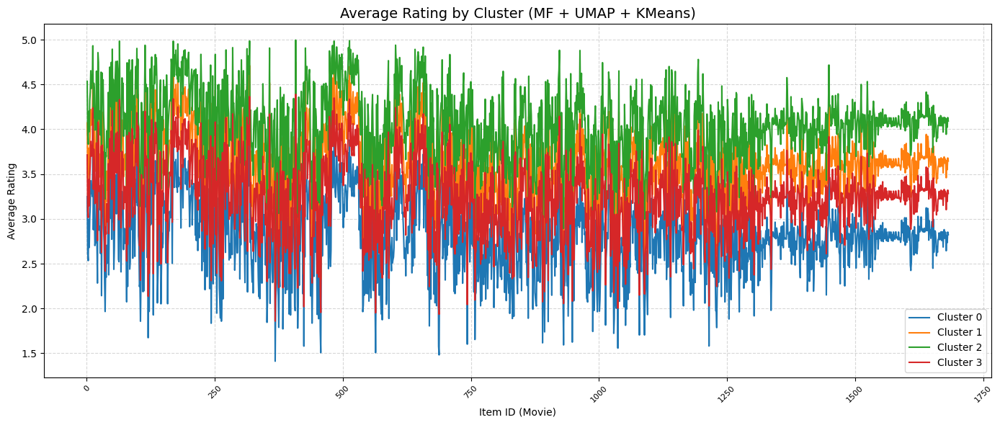

In [57]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_UMAP.index:
    plt.plot(
        cluster_profile_UMAP.columns,  # 横軸 = ジャンル（アイテムID）
        cluster_profile_UMAP.loc[cluster_id],  # 縦軸 = 各ジャンルの平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + UMAP + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


In [82]:
# mf_matrix = mf_matrix.drop(columns=["cluster"], axis=1)

In [83]:
mf_matrix.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052


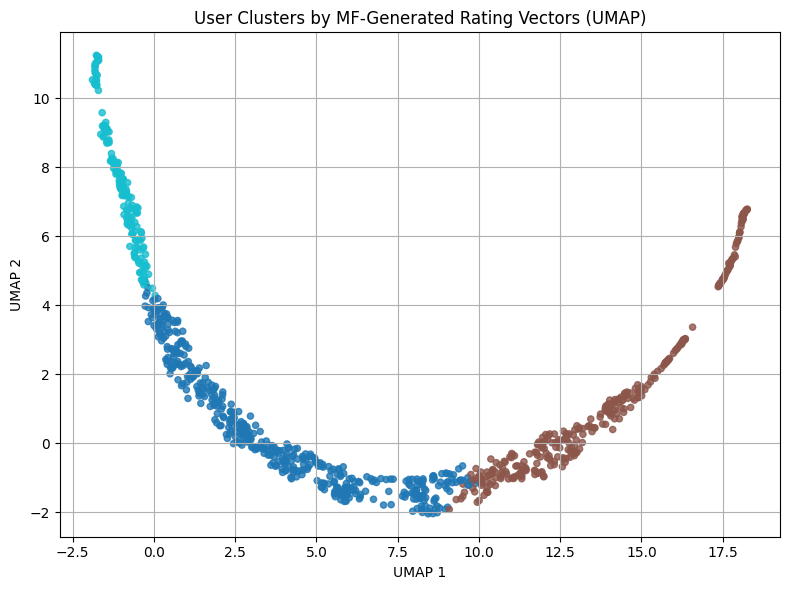

In [84]:
# UMAPによるuserの嗜好クラスタの可視化(MF後のデータフレームを用いた)
# UMAPで次元削減してk-meansすると3つに分けられそうだから，k=3とする
# UMAPで次元削減する時は，2次元!!!!!

import umap
from sklearn.cluster import KMeans

# ユーザー行列（user × item）のまま使う
# (1回目と2回目でUMAPの結果がことなったの原因は，mf_matrixにcluster番号を入れたため)
mf_matrix_UMAP = mf_matrix.copy()
X = mf_matrix.values

# 次元圧縮（UMAP, 次元数は2）
embedding = umap.UMAP(n_components=2, random_state=42).fit_transform(X)

# クラスタリング（任意：3クラスタ）
labels = KMeans(n_clusters=3, random_state=42).fit_predict(X)

# 可視化
plt.figure(figsize=(8, 6))
plt.scatter(embedding[:, 0], embedding[:, 1], c=labels, cmap='tab10', s=20, alpha=0.8)
plt.title("User Clusters by MF-Generated Rating Vectors (UMAP)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.tight_layout()
plt.show()

In [65]:
help(umap.UMAP)

# umapのデフォルトは2次元

Help on class UMAP in module umap.umap_:

class UMAP(sklearn.base.BaseEstimator)
 |  UMAP(n_neighbors=15, n_components=2, metric='euclidean', metric_kwds=None, output_metric='euclidean', output_metric_kwds=None, n_epochs=None, learning_rate=1.0, init='spectral', min_dist=0.1, spread=1.0, low_memory=True, n_jobs=-1, set_op_mix_ratio=1.0, local_connectivity=1.0, repulsion_strength=1.0, negative_sample_rate=5, transform_queue_size=4.0, a=None, b=None, random_state=None, angular_rp_forest=False, target_n_neighbors=-1, target_metric='categorical', target_metric_kwds=None, target_weight=0.5, transform_seed=42, transform_mode='embedding', force_approximation_algorithm=False, verbose=False, tqdm_kwds=None, unique=False, densmap=False, dens_lambda=2.0, dens_frac=0.3, dens_var_shift=0.1, output_dens=False, disconnection_distance=None, precomputed_knn=(None, None, None))
 |  
 |  Uniform Manifold Approximation and Projection
 |  
 |  Finds a low dimensional embedding of the data that approximates

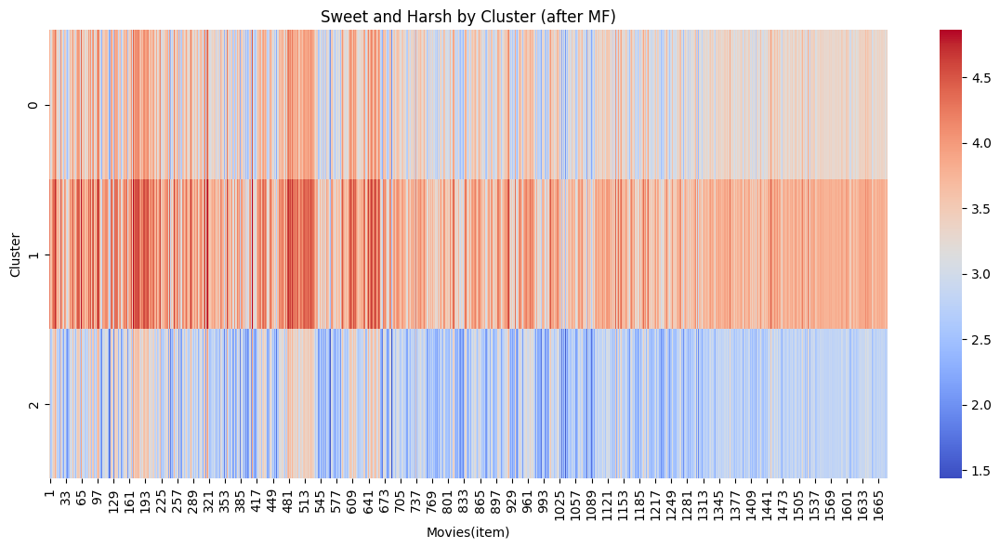

In [107]:
# クラスタ列を追加（再度）
# ここでのlabelsは'UMAP'で次元削減をしてk-meansを行った時に作成したlabel
mf_matrix_UMAP['cluster'] = labels

# clusterごとのジャンル評価傾向の平均を集計
cluster_profile_UMAP = mf_matrix_UMAP.groupby('cluster').mean()

# 可視化
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.heatmap(cluster_profile_UMAP, fmt=".2f", cmap="coolwarm")
plt.title("Sweet and Harsh by Cluster (after MF)")
plt.xlabel("Movies(item)")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()


In [ ]:
# cluster 0: 甘口と辛口の混合
# cluster 1: 甘口が多い
# cluster 2: 辛口が多い

In [86]:
# t-SNEで次元削減をして，HMで可視化すると灰色になる原因の特定

cluster_profile_UMAP.describe()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
count,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
mean,3.767140,3.157718,3.065612,3.491108,3.198104,3.540157,3.674893,3.923159,3.759776,3.870085,3.758265,4.281958,3.387035,3.834212,3.670758,3.225544,3.256011,3.237803,3.904840,3.275966,2.812465,4.126790,4.045695,3.366287,3.420954,3.420844,3.150300,3.860220,2.678517,3.886705,3.563855,3.809047,3.416682,3.243073,2.811306,2.470565,2.966668,2.884690,3.224166,3.021391,3.122067,3.674067,2.895072,3.392108,3.950447,3.576096,3.507284,4.029732,3.281810,4.253407,...,3.387505,3.366773,3.398443,3.366773,3.385093,3.385298,3.639103,3.378678,3.383362,3.624062,3.558672,3.277560,3.484934,3.379605,3.384841,3.293645,3.382585,3.483820,3.476572,2.970084,3.510276,3.144216,3.238760,3.390881,3.365119,3.276132,3.099395,3.199332,3.143769,3.277304,3.290272,3.363262,3.281635,3.280798,3.368921,3.376805,3.278821,3.366773,3.366773,3.206345,3.366773,3.388119,3.309074,3.366773,3.354291,3.159786,3.340782,3.248514,3.373692,3.340373
std,0.484503,0.504030,0.496088,0.468428,0.483763,0.489707,0.485504,0.470296,0.452874,0.469252,0.479776,0.456479,0.481075,0.452817,0.480226,0.488201,0.483490,0.474488,0.474067,0.490381,0.495656,0.479150,0.466575,0.466461,0.479753,0.477519,0.499999,0.484781,0.499231,0.477939,0.496976,0.483470,0.492730,0.478135,0.483897,0.475893,0.485768,0.497835,0.487537,0.484090,0.487188,0.463891,0.489757,0.478800,0.475185,0.490268,0.476035,0.466742,0.480843,0.456057,...,0.477314,0.483041,0.473664,0.483041,0.487883,0.485370,0.486095,0.480284,0.484086,0.478865,0.480023,0.485087,0.478353,0.486964,0.481584,0.484416,0.486522,0.481516,0.479738,0.487858,0.482956,0.487195,0.487718,0.492002,0.479849,0.489864,0.482737,0.482405,0.486326,0.481155,0.484407,0.489957,0.481726,0.480116,0.487663,0.487363,0.491451,0.483041,0.483041,0.488536,0.483041,0.478723,0.492402,0.483041,0.476584,0.486602,0.493427,0.484437,0.487169,0.484725
min,3.274838,2.645737,2.562084,3.017695,2.707880,3.046946,3.179760,3.449144,3.305569,3.394749,3.273940,3.815647,2.900874,3.380186,3.187563,2.732527,2.768257,2.757072,3.427162,2.780311,2.310311,3.637754,3.574665,2.895090,2.937263,2.938216,2.643485,3.366677,2.171455,3.406683,3.062275,3.322527,2.918569,2.762144,2.323880,1.988784,2.478557,2.377922,2.730132,2.531826,2.629323,3.207671,2.400760,2.908964,3.469311,3.080713,3.027617,3.555407,2.797952,3.787383,...,2.906168,2.879072,2.922299,2.879072,2.892293,2.895916,3.149138,2.894395,2.895359,3.141659,3.072653,2.787162,3.002976,2.887743,2.900228,2.805515,2.891413,2.996503,2.989886,2.476683,3.021677,2.651880,2.745461,2.894503,2.881072,2.782653,2.610850,2.712413,2.653240,2.792838,2.802138,2.868515,2.796060,2.795820,2.876090,2.885030,2.782928,2.879072,2.879072,2.712090,2.879072,2.905317,2.812018,2.879072,2.873850,2.668353,2.842

In [87]:
cluster_profile_UMAP.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,3.783132,3.174015,3.080842,3.501244,3.211295,3.547242,3.694760,3.930688,3.762455,3.882501,3.767497,4.302301,3.397374,3.836640,3.676752,3.235323,3.264655,3.250545,3.912147,3.286690,2.825725,4.147213,4.054738,3.375908,3.428927,3.431233,3.164222,3.878248,2.694567,3.890899,3.573193,3.815207,3.427629,3.248710,2.818442,2.482569,2.971389,2.903064,3.237433,3.032534,3.133376,3.679119,2.904312,3.400916,3.962580,3.586490,3.514633,4.045288,3.287899,4.274042,...,3.395657,3.376231,3.403440,3.376231,3.395079,3.393424,3.646938,3.386778,3.391295,3.631220,3.570899,3.288363,3.492229,3.389556,3.390958,3.301163,3.392022,3.495640,3.490782,2.981367,3.521767,3.154666,3.250121,3.399754,3.373629,3.283444,3.111229,3.208490,3.152290,3.283996,3.297815,3.372987,3.289429,3.290675,3.379429,3.385754,3.287826,3.376231,3.376231,3.217991,3.376231,3.396382,3.318519,3.376231,3.362101,3.169598,3.351202,3.260222,3.387123,3.350967
1,4.243449,3.653402,3.553910,3.954386,3.675137,4.026283,4.150159,4.389645,4.211305,4.333006,4.233358,4.727925,3.862857,4.285810,4.147960,3.708782,3.735121,3.705791,4.375212,3.760897,3.301358,4.595402,4.507682,3.827863,3.896670,3.893084,3.643193,4.335735,3.169530,4.362533,4.056097,4.289408,3.903847,3.718364,3.291595,2.940343,3.450059,3.373084,3.704935,3.499813,3.603502,4.135411,3.380143,3.866442,4.419449,4.061084,3.979601,4.488502,3.759579,4.698798,...,3.860692,3.845016,3.869589,3.845016,3.867907,3.866555,4.121234,3.854860,3.863433,4.099308,4.032464,3.757156,3.959598,3.861517,3.863336,3.774259,3.864321,3.959318,3.949047,3.452202,3.987383,3.626103,3.720698,3.878386,3.840657,3.762299,3.576106,3.677093,3.625779,3.755078,3.770863,3.848283,3.759417,3.755900,3.851246,3.859632,3.765707,3.845016,3.845016,3.688953,3.845016,3.862657,3.796685,3.845016,3.826922,3.641408,3.828916,3.726991,3.854006,3.819713
2,3.274838,2.645737,2.562084,3.017695,2.707880,3.046946,3.179760,3.449144,3.305569,3.394749,3.273940,3.815647,2.900874,3.380186,3.187563,2.732527,2.768257,2.757072,3.427162,2.780311,2.310311,3.637754,3.574665,2.895090,2.937263,2.938216,2.643485,3.366677,2.171455,3.406683,3.062275,3.322527,2.918569,2.762144,2.323880,1.988784,2.478557,2.377922,2.730132,2.531826,2.629323,3.207671,2.400760,2.908964,3.469311,3.080713,3.027617,3.555407,2.797952,3.787383,...,2.906168,2.879072,2.922299,2.879072,2.892293,2.895916,3.149138,2.894395,2.895359,3.141659,3.072653,2.787162,3.002976,2.887743,2.900228,2.805515,2.891413,2.996503,2.989886,2.476683,3.021677,2.651880,2.745461,2.894503,2.881072,2.782653,2.610850,2.712413,2.653240,2.792838,2.802138,2.868515,2.796060,2.795820,2.876090,2.885030,2.782928,2.879072,2.879072,2.712090,2.879072,2.905317,2.812018,2.879072,2.873850,2.668353,2.842228,2.758329,2.879946,2.850437


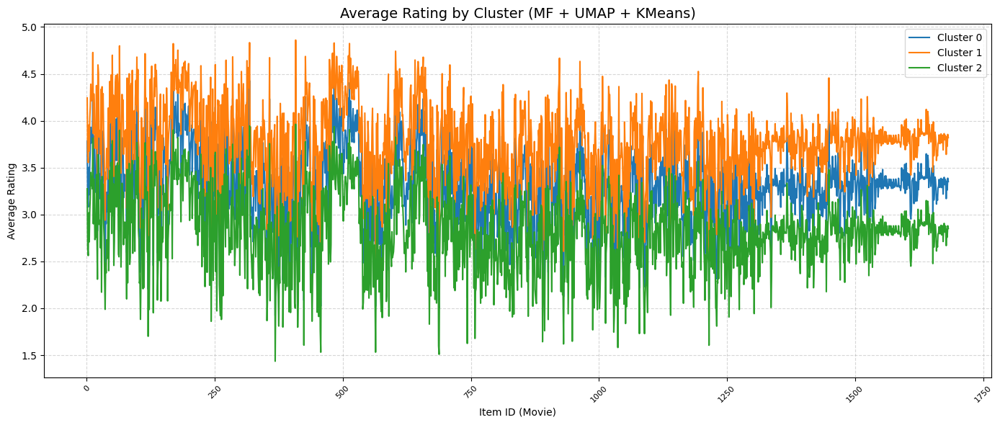

In [88]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_UMAP.index:
    plt.plot(
        cluster_profile_UMAP.columns,  # 横軸 = ジャンル（アイテムID）
        cluster_profile_UMAP.loc[cluster_id],  # 縦軸 = 各ジャンルの平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + UMAP + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


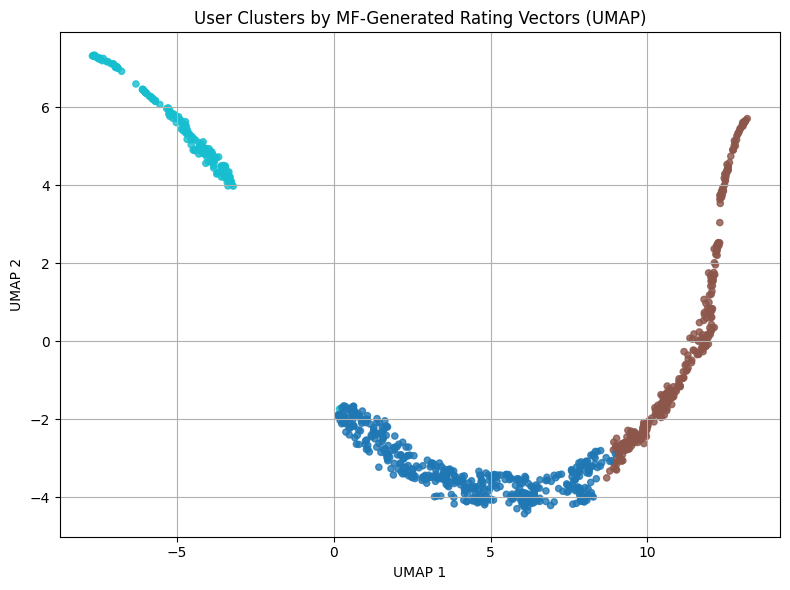

In [66]:
# UMAPによるuserの嗜好クラスタの可視化(MF後のデータフレームを用いた)
# UMAPで次元削減してk-meansすると3つに分けられそうだから，k=3とする
# UMAPで次元削減する時は，3次元!!!!!

import umap
from sklearn.cluster import KMeans

# ユーザー行列（user × item）のまま使う
# (1回目と2回目でUMAPの結果がことなったの原因は，mf_matrixにcluster番号を入れたため)
"""mf_matrix = mf_matrix.drop(columns=["cluster_tsne"], axis=1)"""
X = mf_matrix.values

# 次元圧縮（UMAP）
embedding = umap.UMAP(n_components=3, random_state=42).fit_transform(X)

# クラスタリング（任意：3クラスタ）
labels = KMeans(n_clusters=3, random_state=42).fit_predict(X)

# 可視化
plt.figure(figsize=(8, 6))
plt.scatter(embedding[:, 0], embedding[:, 1], c=labels, cmap='tab10', s=20, alpha=0.8)
plt.title("User Clusters by MF-Generated Rating Vectors (UMAP)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.grid(True)
plt.tight_layout()
plt.show()

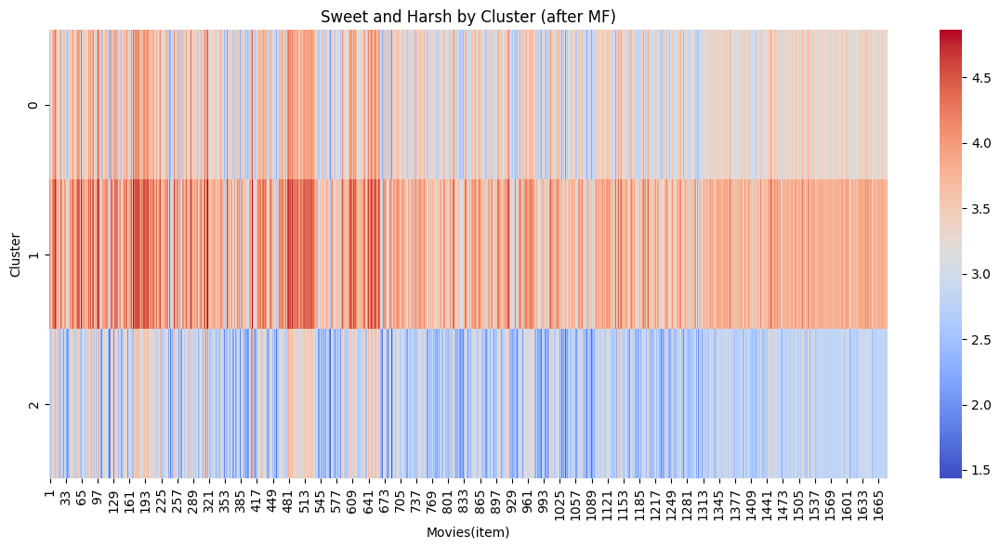

In [67]:
# クラスタ列を追加（再度）
# ここでのlabelsは'UMAP'で次元削減をしてk-meansを行った時に作成したlabel
mf_matrix['cluster'] = labels

# clusterごとのジャンル評価傾向の平均を集計
cluster_profile_UMAP = mf_matrix.groupby('cluster').mean()

# 可視化
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.heatmap(cluster_profile_UMAP, fmt=".2f", cmap="coolwarm")
plt.title("Sweet and Harsh by Cluster (after MF)")
plt.xlabel("Movies(item)")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()


In [68]:
# t-SNEで次元削減をして，HMで可視化すると灰色になる原因の特定

cluster_profile_UMAP.describe()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
count,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
mean,3.766435,3.156938,3.065035,3.490573,3.197355,3.539355,3.674338,3.922457,3.759481,3.869562,3.757780,4.281457,3.386520,3.833823,3.670035,3.224841,3.255175,3.237261,3.904150,3.275244,2.811691,4.126057,4.045178,3.365780,3.420021,3.420243,3.149519,3.859418,2.677889,3.886040,3.563200,3.808402,3.416131,3.242346,2.810570,2.469899,2.965921,2.883819,3.223614,3.020518,3.121419,3.673578,2.894336,3.391223,3.949775,3.575286,3.506814,4.029209,3.281004,4.252839,...,3.386901,3.366099,3.397837,3.366099,3.384370,3.384597,3.638299,3.377896,3.382788,3.623359,3.558135,3.276909,3.484287,3.378965,3.384115,3.293067,3.381844,3.483170,3.475900,2.969495,3.509587,3.143515,3.237948,3.390102,3.364588,3.275409,3.098800,3.198651,3.143199,3.276614,3.289611,3.362536,3.280860,3.280089,3.368054,3.376089,3.278278,3.366099,3.366099,3.205603,3.366099,3.387531,3.308313,3.366099,3.353638,3.159005,3.340056,3.247888,3.373008,3.339740
std,0.485293,0.504966,0.496550,0.468853,0.484667,0.490742,0.485918,0.471124,0.452779,0.469639,0.480063,0.456810,0.481428,0.452944,0.481092,0.488994,0.484614,0.474911,0.474861,0.491215,0.496599,0.480007,0.466963,0.466824,0.481115,0.478086,0.500950,0.485802,0.499808,0.478673,0.497641,0.484144,0.493146,0.479014,0.484783,0.476615,0.486685,0.498998,0.487959,0.485297,0.487846,0.464230,0.490629,0.480048,0.475921,0.491313,0.476299,0.467125,0.481905,0.456554,...,0.477894,0.483775,0.474263,0.483775,0.488726,0.486168,0.487140,0.481285,0.484583,0.479682,0.480425,0.485759,0.479037,0.487609,0.482453,0.484924,0.487411,0.482190,0.480460,0.488374,0.483721,0.487984,0.488769,0.492972,0.480249,0.490708,0.483274,0.483159,0.486808,0.481937,0.485112,0.490802,0.482710,0.480939,0.488851,0.488191,0.491858,0.483775,0.483775,0.489417,0.483775,0.479263,0.493328,0.483775,0.477284,0.487585,0.494264,0.485047,0.487909,0.485353
min,3.273265,2.643880,2.561151,3.016837,2.706084,3.044886,3.178916,3.447494,3.305753,3.393964,3.273355,3.814964,2.900157,3.379928,3.185837,2.730946,2.766024,2.756217,3.425578,2.778651,2.308440,3.636054,3.573880,2.894355,2.934560,2.937078,2.641596,3.364657,2.170295,3.405217,3.060946,3.321181,2.917729,2.760392,2.322114,1.987343,2.476729,2.375627,2.729277,2.529434,2.628006,3.206988,2.399024,2.906488,3.467843,3.078639,3.027078,3.554627,2.795837,3.786380,...,2.905006,2.877608,2.921102,2.877608,2.890614,2.894325,3.147060,2.892404,2.894361,3.140030,3.071837,2.785819,3.001608,2.886452,2.898494,2.804494,2.889645,2.995157,2.988446,2.475645,3.020151,2.650307,2.743373,2.892572,2.880265,2.780970,2.609771,2.710910,2.652271,2.791277,2.800729,2.866831,2.794102,2.794181,2.873735,2.883380,2.782108,2.877608,2.877608,2.710337,2.877608,2.904235,2.810175,2.877608,2.872452,2.666398,2.840

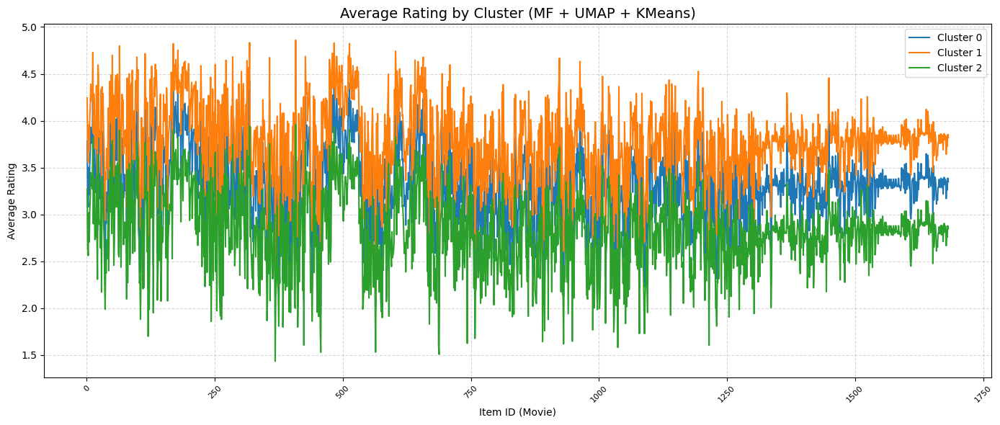

In [69]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_UMAP.index:
    plt.plot(
        cluster_profile_UMAP.columns,  # 横軸 = ジャンル（アイテムID）
        cluster_profile_UMAP.loc[cluster_id],  # 縦軸 = 各ジャンルの平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + UMAP + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


In [ ]:
# UMAPで次元削減する時の次元数は2, 3, 4でも，ヒートマップと折れ線グラフでは違いはわからない．

In [70]:
"""
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# ① 特徴量（ユーザー × アイテム MF後行列）
# すでに 'cluster' や 'cluster_tsne' がある場合は除外しておく
X = mf_matrix.drop(columns=["cluster", "cluster_tsne"], errors='ignore').values

# ② t-SNE による次元削減（2次元）
tsne_embedding = TSNE(n_components=2, random_state=42, perplexity=30).fit_transform(X)

# ③ KMeans によるクラスタリング（3クラスタ）
tsne_labels = KMeans(n_clusters=3, random_state=42, n_init=10).fit_predict(X)

# ④ クラスタラベルを追加（コピーした上で）
mf_matrix_clean = mf_matrix.drop(columns=["cluster", "cluster_tsne"], errors='ignore').copy()
mf_matrix_clean["cluster_tsne"] = tsne_labels

# ⑤ クラスタごとの平均（ラベル列除外）
cluster_profile_tsne = mf_matrix_clean.groupby("cluster_tsne").mean()

# ⑥ 視覚化
plt.figure(figsize=(12, 6))
sns.heatmap(cluster_profile_tsne, fmt=".2f", cmap="coolwarm", linewidths=0.5, linecolor='gray')
plt.title("Genre Preference by Cluster (t-SNE + MF + KMeans)", fontsize=14)
plt.xlabel("Item ID / Genre")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()
"""

'\nfrom sklearn.manifold import TSNE\nfrom sklearn.cluster import KMeans\nimport matplotlib.pyplot as plt\nimport seaborn as sns\nimport pandas as pd\n\n# ① 特徴量（ユーザー × アイテム MF後行列）\n# すでに \'cluster\' や \'cluster_tsne\' がある場合は除外しておく\nX = mf_matrix.drop(columns=["cluster", "cluster_tsne"], errors=\'ignore\').values\n\n# ② t-SNE による次元削減（2次元）\ntsne_embedding = TSNE(n_components=2, random_state=42, perplexity=30).fit_transform(X)\n\n# ③ KMeans によるクラスタリング（3クラスタ）\ntsne_labels = KMeans(n_clusters=3, random_state=42, n_init=10).fit_predict(X)\n\n# ④ クラスタラベルを追加（コピーした上で）\nmf_matrix_clean = mf_matrix.drop(columns=["cluster", "cluster_tsne"], errors=\'ignore\').copy()\nmf_matrix_clean["cluster_tsne"] = tsne_labels\n\n# ⑤ クラスタごとの平均（ラベル列除外）\ncluster_profile_tsne = mf_matrix_clean.groupby("cluster_tsne").mean()\n\n# ⑥ 視覚化\nplt.figure(figsize=(12, 6))\nsns.heatmap(cluster_profile_tsne, fmt=".2f", cmap="coolwarm", linewidths=0.5, linecolor=\'gray\')\nplt.title("Genre Preference by Cluster (t-SNE + MF + K

In [74]:
mf_matrix

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,cluster
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589,0
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329,0
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862,2
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211,1
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,5.000,3.845,4.830

In [ ]:
# ⓪mf_matrixに余分なカラムが入っている場合は削除する
# mf_matrix = mf_matrix.drop(columns=["cluster_tsne"], axis=1)

In [89]:
mf_matrix_UMAP.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,cluster
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589,0
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329,0
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862,2
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211,1
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052,2


In [90]:
# 3つに分類したclusterにおいて，ジャンルの偏りがあるかを調べる．
# 用いるデータフレームは，mf_matrix_UMAP

from scipy.stats import f_oneway

for genre in mf_matrix.columns[:-1]:  # 'cluster'列を除く
    group0 = mf_matrix_UMAP[mf_matrix_UMAP["cluster"] == 0][genre]
    group1 = mf_matrix_UMAP[mf_matrix_UMAP["cluster"] == 1][genre]
    group2 = mf_matrix_UMAP[mf_matrix_UMAP["cluster"] == 2][genre]
    stat, p = f_oneway(group0, group1, group2)
    if p < 0.05:
        print(f"{genre} に有意差あり (p={p:.4f})")


1 に有意差あり (p=0.0000)
2 に有意差あり (p=0.0000)
3 に有意差あり (p=0.0000)
4 に有意差あり (p=0.0000)
5 に有意差あり (p=0.0000)
6 に有意差あり (p=0.0000)
7 に有意差あり (p=0.0000)
8 に有意差あり (p=0.0000)
9 に有意差あり (p=0.0000)
10 に有意差あり (p=0.0000)
11 に有意差あり (p=0.0000)
12 に有意差あり (p=0.0000)
13 に有意差あり (p=0.0000)
14 に有意差あり (p=0.0000)
15 に有意差あり (p=0.0000)
16 に有意差あり (p=0.0000)
17 に有意差あり (p=0.0000)
18 に有意差あり (p=0.0000)
19 に有意差あり (p=0.0000)
20 に有意差あり (p=0.0000)
21 に有意差あり (p=0.0000)
22 に有意差あり (p=0.0000)
23 に有意差あり (p=0.0000)
24 に有意差あり (p=0.0000)
25 に有意差あり (p=0.0000)
26 に有意差あり (p=0.0000)
27 に有意差あり (p=0.0000)
28 に有意差あり (p=0.0000)
29 に有意差あり (p=0.0000)
30 に有意差あり (p=0.0000)
31 に有意差あり (p=0.0000)
32 に有意差あり (p=0.0000)
33 に有意差あり (p=0.0000)
34 に有意差あり (p=0.0000)
35 に有意差あり (p=0.0000)
36 に有意差あり (p=0.0000)
37 に有意差あり (p=0.0000)
38 に有意差あり (p=0.0000)
39 に有意差あり (p=0.0000)
40 に有意差あり (p=0.0000)
41 に有意差あり (p=0.0000)
42 に有意差あり (p=0.0000)
43 に有意差あり (p=0.0000)
44 に有意差あり (p=0.0000)
45 に有意差あり (p=0.0000)
46 に有意差あり (p=0.0000)
47 に有意差あり (p=0.0000)
48 に有意差あり (p=0.0000)
4

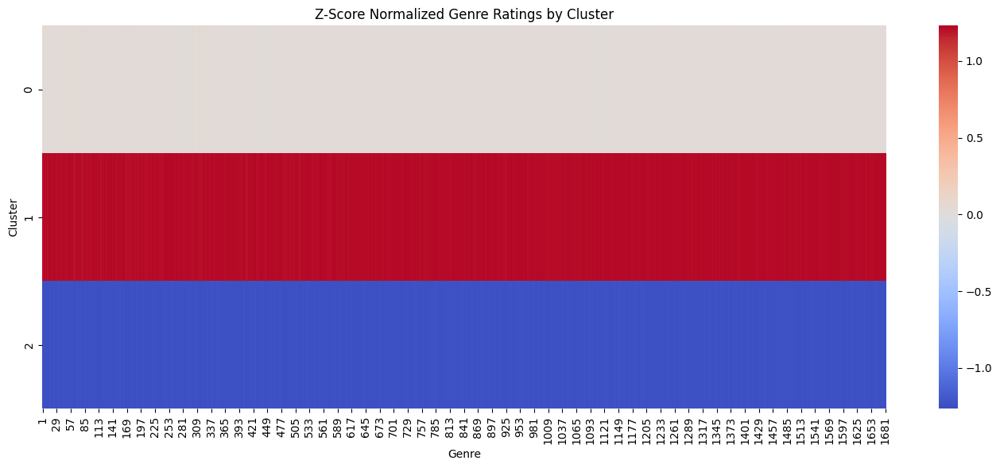

In [92]:
# 各clusterでジャンルの偏りがあるかを調べたいが，下の可視化はratingの行列だから，ジャンルに関する情報を追加する必要がある(clusteringをした後で)．

from scipy.stats import zscore

cluster_profile = mf_matrix_UMAP.groupby("cluster").mean()
z_scaled = cluster_profile.apply(zscore, axis=0)

plt.figure(figsize=(14, 6))
sns.heatmap(z_scaled, cmap="coolwarm", fmt=".2f")
plt.title("Z-Score Normalized Genre Ratings by Cluster")
plt.xlabel("item ID (Movie)")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()


In [94]:
print("mf_matrix shape: ", mf_matrix.shape)
mf_matrix.head()

mf_matrix shape:  (943, 1682)


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.596,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.531,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,3.023,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.282,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.996,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052


In [101]:
# MF後のデータに対してスペクトラルクラスタリングを行う
# ここで用いる行列は，user * itemのMF後の行列

from sklearn.cluster import SpectralClustering
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# ① データの標準化（スペクトラルクラスタリングでは距離計算が重要）
scaler = StandardScaler()
X_scaled = scaler.fit_transform(mf_matrix.values)

# ② スペクトラルクラスタリング
n_clusters = 3
spectral = SpectralClustering(
    n_clusters=n_clusters,
    affinity='nearest_neighbors',
    n_neighbors=10,
    assign_labels='kmeans',
    random_state=42
)
cluster_labels_spec = spectral.fit_predict(X_scaled)

# ③ クラスタラベルを mf_matrix に追加
mf_matrix_spec = mf_matrix.copy()
mf_matrix_spec["cluster_spectral"] = cluster_labels

# ④ クラスタごとのアイテム平均評価（ジャンルごとの傾向）
cluster_profile_spec = mf_matrix_spec.groupby("cluster_spectral").mean()

# ⑤ クラスタ列は除外
cluster_profile_spec = cluster_profile_spec.drop(columns=["cluster_spectral"], errors="ignore")

print("cluster_profile_spec shape: ", cluster_profile_spec.shape)
cluster_profile_spec.head()

cluster_profile_spec shape:  (3, 1682)


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682
cluster_spectral,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,4.542815,3.965283,3.841435,4.206989,3.979685,4.328902,4.427217,4.658609,4.456261,4.604967,4.536435,4.933554,4.131370,4.517989,4.443891,3.998174,4.025783,4.002848,4.655228,4.033815,3.612391,4.863402,4.754337,4.117957,4.214587,4.176533,3.943880,4.646620,3.483348,4.636272,4.356641,4.559804,4.177957,3.999891,3.583935,3.228185,3.744326,3.705326,3.987728,3.807380,3.915239,4.415076,3.680380,4.170978,4.701207,4.352891,4.259576,4.753370,4.045533,4.894804,...,4.149728,4.135337,4.154174,4.135337,4.158424,4.154109,4.424011,4.148163,4.148141,4.389663,4.316272,4.050989,4.238804,4.144587,4.153185,4.050391,4.148533,4.254685,4.239272,3.748424,4.274022,3.923880,4.012478,4.176663,4.122522,4.053337,3.870141,3.962826,3.908924,4.048196,4.046120,4.140772,4.060250,4.046065,4.161913,4.150848,4.046174,4.135337,4.135337,3.976935,4.135337,4.139359,4.079924,4.135337,4.111750,3.952880,4.123326,4.030522,4.138609,4.098250
1,3.902532,3.298637,3.206089,3.624184,3.331357,3.672869,3.815774,4.054196,3.884642,4.002196,3.888279,4.422725,3.523220,3.961514,3.799643,3.360972,3.388590,3.368728,4.035012,3.414624,2.949248,4.267156,4.179300,3.493777,3.548991,3.553140,3.289832,3.995522,2.817312,4.017822,3.701120,3.943299,3.556155,3.373802,2.943076,2.602848,3.097886,3.021961,3.361692,3.153600,3.254722,3.799776,3.028746,3.521952,4.083134,3.712192,3.638256,4.163574,3.413089,4.395526,...,3.518080,3.499954,3.526449,3.499954,3.520070,3.519000,3.771244,3.509737,3.517282,3.754811,3.693085,3.411788,3.616722,3.515688,3.516247,3.428348,3.517663,3.616979,3.610984,3.104878,3.644730,3.278162,3.373929,3.525615,3.497649,3.411138,3.233345,3.332786,3.278455,3.408392,3.425153,3.498648,3.412285,3.413712,3.501321,3.511244,3.416108,3.499954,3.499954,3.342471,3.499954,3.521064,3.446975,3.499954,3.485007,3.291632,3.477091,3.381149,3.510949,3.476202
2,3.292287,2.662742,2.580596,3.035169,2.724382,3.062764,3.196725,3.463371,3.322674,3.411354,3.290466,3.831702,2.915815,3.394118,3.206416,2.748073,2.785382,2.772876,3.443607,2.796916,2.326287,3.653831,3.588612,2.910663,2.951140,2.955444,2.661539,3.382775,2.188545,3.422006,3.076096,3.338983,2.935073,2.777961,2.340837,2.004697,2.494466,2.393803,2.746955,2.547225,2.645376,3.223096,2.418393,2.923247,3.486135,3.096455,3.043792,3.571758,2.813927,3.803287,...,2.922433,2.895056,2.939567,2.895056,2.908933,2.911938,3.163612,2.910528,2.909921,3.156758,3.088596,2.802719,3.019483,2.902742,2.914764,2.821197,2.908039,3.012444,3.005933,2.493522,3.038545,2.668629,2.763140,2.911461,2.897758,2.796433,2.626163,2.728303,2.669871,2.807416,2.817635,2.884882,2.811202,2.809758,2.892764,2.900646,2.798949,2.895056,2.895056,2.729764,2.895056,2.921112,2.826416,2.895056,2.890112,2.683938,2.860129,2.775758,2.896669,2.866955


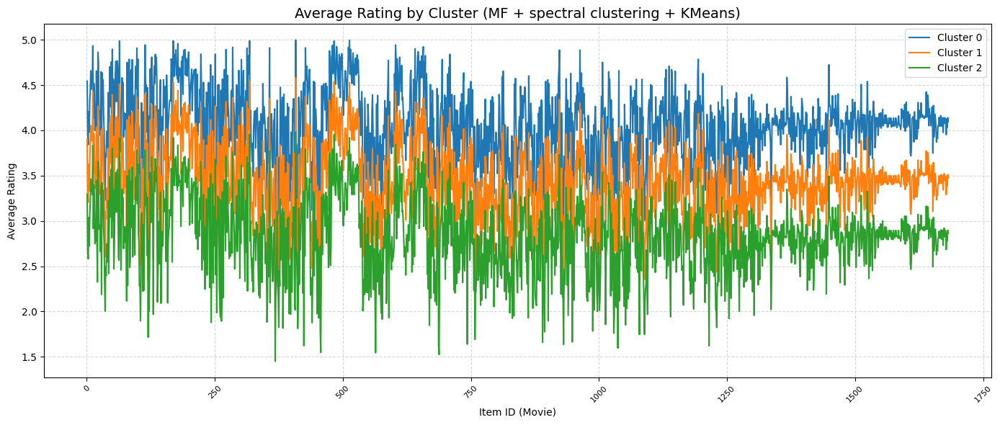

In [102]:
# 集約統計量だと分かりにくいから，折れ線グラフで可視化する

import matplotlib.pyplot as plt

# 折れ線グラフでクラスタごとの傾向を比較
plt.figure(figsize=(14, 6))

for cluster_id in cluster_profile_spec.index:
    plt.plot(
        cluster_profile_spec.columns,  # 横軸 = 映画（アイテムID）
        cluster_profile_spec.loc[cluster_id],  # 縦軸 = 各映画の平均rating
        label=f"Cluster {cluster_id}"
    )

plt.title("Average Rating by Cluster (MF + spectral clustering + KMeans)", fontsize=14)
plt.xlabel("Item ID (Movie)")
plt.ylabel("Average Rating")
plt.xticks(rotation=45, fontsize=8)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


In [103]:
# 標準化してるからマイナスが存在する．

X_scaled

array([[ 0.59459037,  0.01773272, -0.25608965, ..., -0.19635464,
        -0.11334276,  0.42790219],
       [-0.01974238, -0.20889128,  0.01475783, ..., -0.05651731,
         0.29151413, -0.23784895],
       [-1.42790428, -1.42157078, -1.35425308, ..., -1.39387068,
        -1.51496755, -1.43364043],
       ...,
       [ 0.77155866,  0.46374805,  0.71896129, ...,  0.70114677,
         0.63743615,  0.68652091],
       [ 1.21397936,  1.01343179,  0.85438503, ...,  0.94776897,
         1.08329121,  1.30874217],
       [ 0.11424789,  0.29980728,  0.20927557, ...,  0.39604714,
         0.12495908,  0.45862917]])

In [104]:
# 
cluster_labels_spec

array([1, 1, 2, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 2, 1, 1, 2, 2, 1,
       1, 0, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1,
       0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 1, 1, 1,
       1, 1, 1, 2, 1, 2, 1, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 0, 2, 1,
       2, 1, 1, 1, 1, 1, 2, 1, 2, 0, 1, 1, 1, 1, 1, 0, 1, 2, 0, 1, 1, 1,
       1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2,
       2, 0, 2, 2, 1, 1, 2, 2, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1,
       1, 2, 1, 2, 0, 1, 1, 2, 2, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 2, 1, 2, 1, 1, 1, 0, 1, 2, 2, 0, 1, 1, 1, 0, 0, 2, 1, 0,
       1, 1, 1, 2, 2, 0, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       0, 1, 2, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 0, 1,

In [105]:
mf_matrix_spec

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,...,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,cluster_spectral
1,4.085,3.251,3.046,3.740,3.261,3.696,4.280,3.901,4.086,3.953,3.564,4.644,3.725,4.079,3.485,3.628,3.272,3.563,4.142,3.657,2.563,4.268,4.150,3.525,3.276,3.427,3.195,4.090,2.573,3.626,3.676,3.842,3.417,3.200,2.720,2.508,2.842,3.052,3.403,3.086,3.190,3.766,2.975,3.718,4.175,3.611,3.538,4.286,3.282,4.613,...,3.444,3.705,3.444,3.452,3.414,3.624,3.477,3.585,3.695,3.571,3.314,3.514,3.592,3.455,3.270,3.471,3.699,3.585,3.005,3.536,3.199,3.304,3.312,3.584,3.152,3.137,3.354,3.401,3.347,3.182,3.328,3.481,3.374,3.409,3.551,3.270,3.444,3.444,3.352,3.444,3.647,3.328,3.444,3.460,2.944,3.354,3.253,3.412,3.589,1
2,3.842,3.157,3.156,3.768,3.409,3.513,3.957,4.080,3.799,3.925,3.955,4.476,3.661,4.065,3.741,3.334,3.310,3.494,4.089,3.322,2.906,4.264,4.290,3.604,3.647,3.628,3.215,4.135,2.722,3.908,3.810,3.811,3.451,3.376,2.826,2.636,3.040,3.181,3.405,3.245,3.109,3.793,2.934,3.545,4.224,3.653,3.603,4.199,3.383,4.719,...,3.503,3.553,3.503,3.487,3.444,3.736,3.520,3.501,3.787,3.737,3.437,3.639,3.472,3.514,3.377,3.456,3.721,3.748,2.971,3.699,3.337,3.397,3.421,3.460,3.325,3.329,3.299,3.270,3.423,3.383,3.568,3.401,3.583,3.436,3.470,3.425,3.503,3.503,3.331,3.503,3.615,3.478,3.503,3.494,3.257,3.379,3.308,3.570,3.329,1
3,3.285,2.654,2.600,2.977,2.751,3.098,2.939,3.417,3.323,3.368,3.462,3.897,2.952,3.407,3.207,2.717,2.680,2.723,3.476,2.739,2.292,3.616,3.605,2.840,2.951,3.059,2.713,3.477,2.071,3.434,3.303,3.321,3.088,2.825,2.347,1.922,2.549,2.422,2.842,2.478,2.637,3.414,2.471,2.939,3.479,3.138,3.174,3.523,2.850,3.926,...,2.933,2.914,2.933,2.914,2.995,3.226,2.984,2.967,3.224,3.098,2.866,3.096,2.901,3.014,2.938,2.935,3.080,3.001,2.437,3.001,2.700,2.722,2.967,2.846,2.775,2.740,2.861,2.657,2.814,2.870,3.001,2.863,2.880,2.919,2.930,2.964,2.933,2.933,2.817,2.933,2.958,2.880,2.933,2.907,2.776,2.854,2.782,2.865,2.862,2
4,4.528,3.996,3.807,4.318,4.025,4.366,4.521,4.808,4.583,4.622,4.611,5.000,4.123,4.638,4.490,4.108,4.068,4.062,4.732,4.044,3.583,4.872,4.826,4.229,4.124,4.294,3.962,4.631,3.573,4.749,4.431,4.680,4.234,4.056,3.634,3.275,3.848,3.758,4.034,3.802,3.940,4.613,3.726,4.233,4.769,4.439,4.299,4.809,4.132,5.000,...,4.201,4.221,4.201,4.255,4.192,4.432,4.196,4.240,4.479,4.364,4.102,4.327,4.201,4.205,4.174,4.192,4.324,4.239,3.792,4.325,3.928,4.038,4.236,4.247,4.065,3.900,4.069,4.017,4.119,4.111,4.195,4.123,4.081,4.266,4.221,4.107,4.201,4.201,4.008,4.201,4.233,4.130,4.201,4.209,3.986,4.145,4.166,4.190,4.211,0
5,3.475,3.094,2.811,3.181,2.892,3.138,3.597,3.484,3.323,3.592,3.431,4.048,2.815,3.273,3.211,2.937,2.861,2.960,3.371,2.836,2.607,3.842,3.575,3.054,2.920,2.998,2.851,3.525,2.679,3.524,3.086,3.358,2.935,2.704,2.395,2.139,2.507,2.803,2.884,2.614,2.859,3.368,2.597,2.839,3.439,3.298,3.158,3.806,2.825,3.841,...,2.988,2.769,2.988,3.004,2.933,3.226,2.878,3.042,3.121,3.338,2.979,2.986,2.957,2.928,2.743,2.921,3.087,3.161,2.868,3.197,2.825,2.867,3.080,3.140,2.768,2.737,2.846,2.728,2.751,2.868,2.981,3.022,2.754,3.156,2.996,2.916,2.988,2.988,2.868,2.988,2.962,2.921,2.988,2.970,2.910,2.908,3.129,3.062,3.052,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,4.864,4.374,4.163,4.407,4.307,4.549,4.831,4.804,4.532,4.809,4.810,5.000,4.304,4.608,4.623,4.317,4.138,4.305,4.860,4.295,3.969,5.000,5.000,4.341,4.393,4.510,4.286,5.000,3.

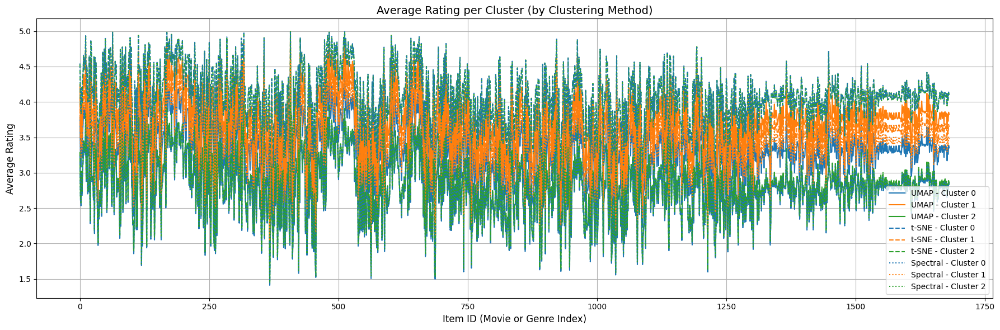

In [109]:
# 次元削減による違いを確認したいから，UMAP, t-SNE, スペクトラルクラスタリングの結果を折れ線グラフで可視化する

import matplotlib.pyplot as plt

# クラスタ数（共通前提：3クラスタ）
n_clusters = 3

# 折れ線の色：クラスタリング手法ごとに異なる
colors = ['tab:blue', 'tab:orange', 'tab:green']

# 描画設定
plt.figure(figsize=(18, 6))

# 1. UMAPクラスタ結果（実線）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_UMAP.iloc[cluster_id].values,
        label=f"UMAP - Cluster {cluster_id}",
        linestyle='-',
        color=colors[cluster_id]
    )

# 2. t-SNEクラスタ結果（破線）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_tsne.iloc[cluster_id].values,
        label=f"t-SNE - Cluster {cluster_id}",
        linestyle='--',
        color=colors[cluster_id]
    )

# 3. Spectralクラスタ結果（点線）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_spec.iloc[cluster_id].values,
        label=f"Spectral - Cluster {cluster_id}",
        linestyle=':',
        color=colors[cluster_id]
    )

# 可視化
plt.title("Average Rating per Cluster (by Clustering Method)", fontsize=14)
plt.xlabel("Item ID (Movie or Genre Index)", fontsize=12)
plt.ylabel("Average Rating", fontsize=12)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

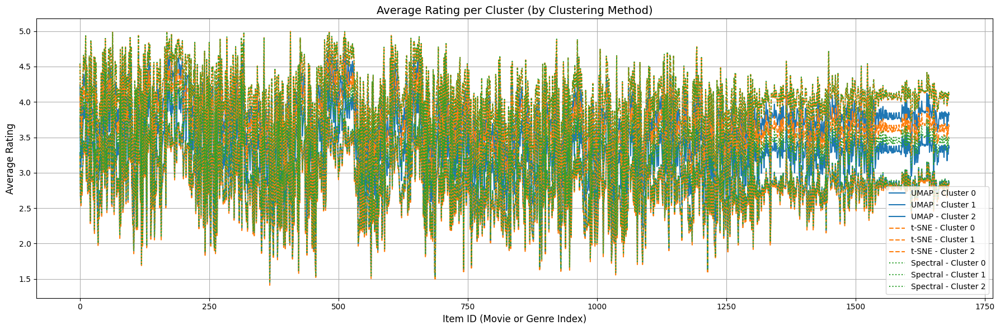

In [112]:
import matplotlib.pyplot as plt

# クラスタ数（共通前提：3クラスタ）
n_clusters = 3

# 手法ごとの色とスタイル
method_styles = {
    'UMAP': {'linestyle': '-', 'color': 'tab:blue'},
    't-SNE': {'linestyle': '--', 'color': 'tab:orange'},
    'Spectral': {'linestyle': ':', 'color': 'tab:green'}
}

# 描画設定
plt.figure(figsize=(18, 6))

# 1. UMAP（すべて青）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_UMAP.iloc[cluster_id].values,
        label=f"UMAP - Cluster {cluster_id}",
        linestyle=method_styles['UMAP']['linestyle'],
        color=method_styles['UMAP']['color']
    )

# 2. t-SNE（すべてオレンジ）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_tsne.iloc[cluster_id].values,
        label=f"t-SNE - Cluster {cluster_id}",
        linestyle=method_styles['t-SNE']['linestyle'],
        color=method_styles['t-SNE']['color']
    )

# 3. Spectral（すべて緑）
for cluster_id in range(n_clusters):
    plt.plot(
        cluster_profile_spec.iloc[cluster_id].values,
        label=f"Spectral - Cluster {cluster_id}",
        linestyle=method_styles['Spectral']['linestyle'],
        color=method_styles['Spectral']['color']
    )

# タイトルや軸
plt.title("Average Rating per Cluster (by Clustering Method)", fontsize=14)
plt.xlabel("Item ID (Movie or Genre Index)", fontsize=12)
plt.ylabel("Average Rating", fontsize=12)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


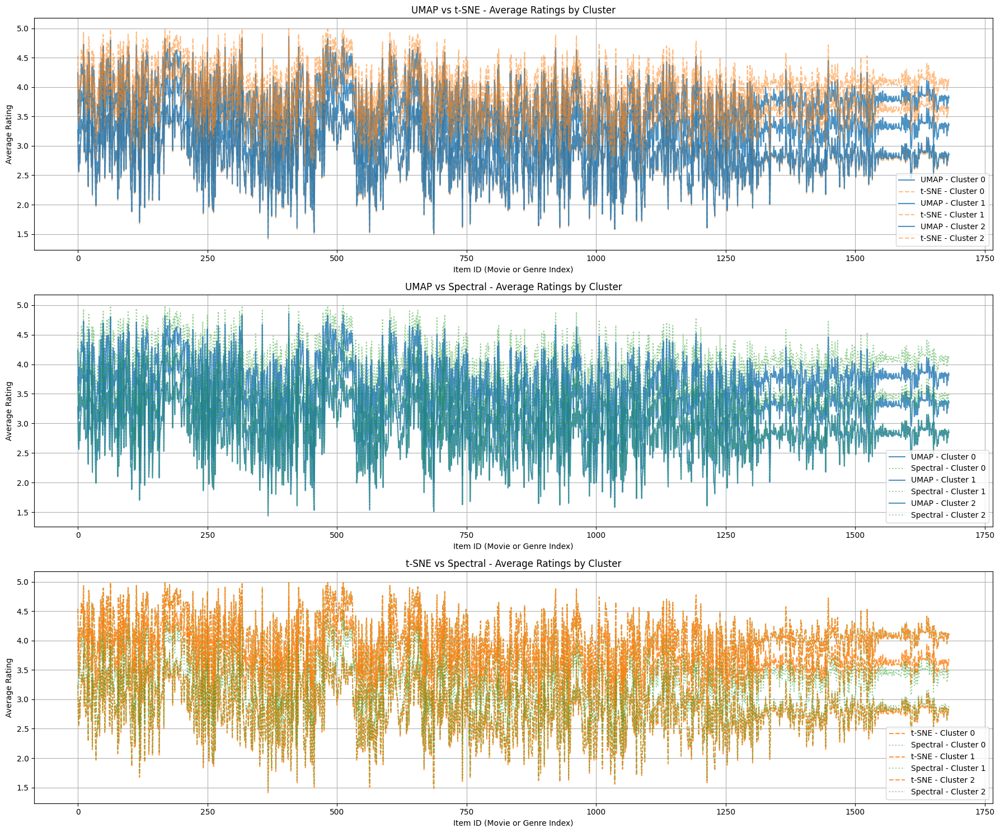

In [111]:
# 見えにくいから3C2で組み合わせで可視化する．

import matplotlib.pyplot as plt

# クラスタ数（共通前提）
n_clusters = 3

# 描画設定（手法ごとの線スタイルと色）
styles = {
    'UMAP': {'linestyle': '-', 'color': 'tab:blue'},
    't-SNE': {'linestyle': '--', 'color': 'tab:orange'},
    'Spectral': {'linestyle': ':', 'color': 'tab:green'}
}

# 手法ごとのデータ
profiles = {
    'UMAP': cluster_profile_UMAP,
    't-SNE': cluster_profile_tsne,
    'Spectral': cluster_profile_spec
}

# 組み合わせ: 3C2 = (UMAP vs t-SNE), (UMAP vs Spectral), (t-SNE vs Spectral)
pairs = [
    ('UMAP', 't-SNE'),
    ('UMAP', 'Spectral'),
    ('t-SNE', 'Spectral')
]

# 可視化（3つのグラフに分ける）
plt.figure(figsize=(18, 15))

for i, (method1, method2) in enumerate(pairs, 1):
    plt.subplot(3, 1, i)
    for cluster_id in range(n_clusters):
        plt.plot(
            profiles[method1].iloc[cluster_id].values,
            label=f"{method1} - Cluster {cluster_id}",
            linestyle=styles[method1]['linestyle'],
            color=styles[method1]['color'],
            alpha=0.8
        )
        plt.plot(
            profiles[method2].iloc[cluster_id].values,
            label=f"{method2} - Cluster {cluster_id}",
            linestyle=styles[method2]['linestyle'],
            color=styles[method2]['color'],
            alpha=0.5
        )
    plt.title(f"{method1} vs {method2} - Average Ratings by Cluster")
    plt.xlabel("Item ID (Movie or Genre Index)")
    plt.ylabel("Average Rating")
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.show()


In [114]:
pip install networkx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 17.0 MB/s eta 0:00:0031m18.0 MB/s eta 0:00:01

[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


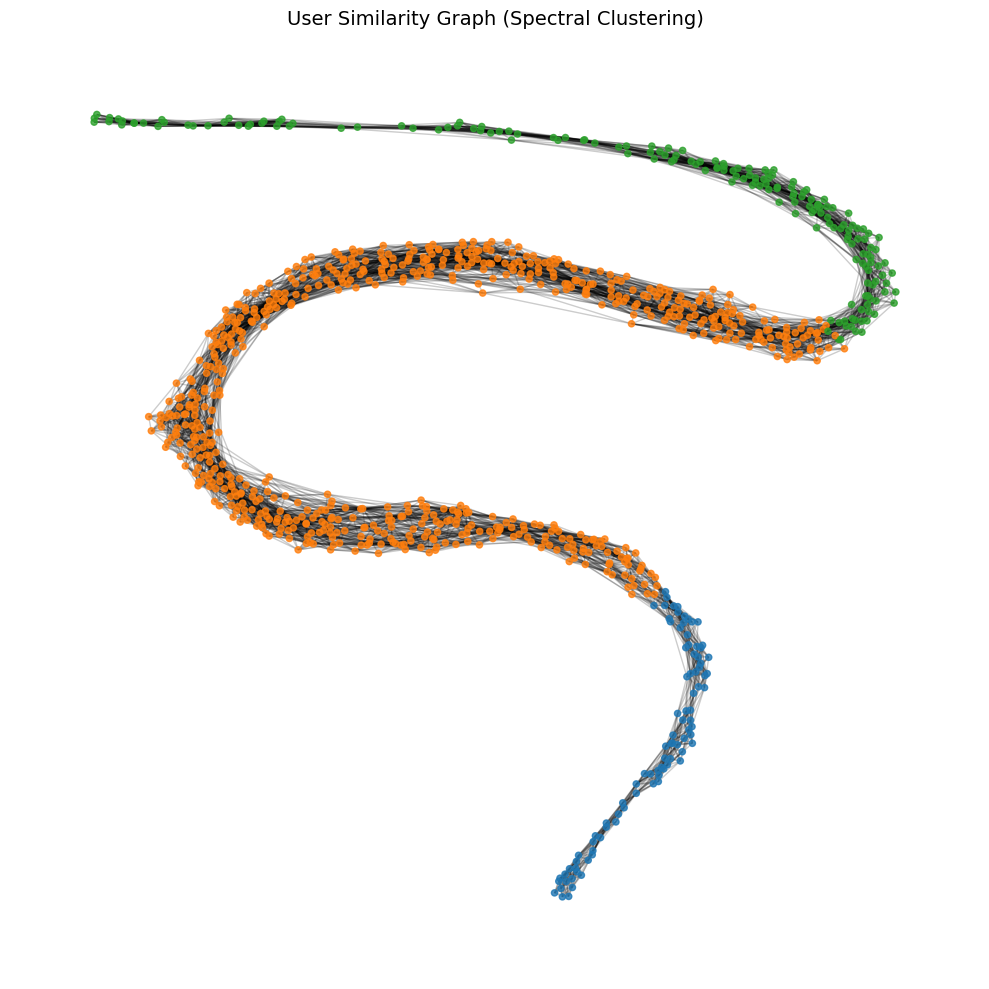

In [ ]:
# スペクトラルクラスタリングを用いて，user * item ratingデータをネットワーク構造で可視化する．

import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import kneighbors_graph
from sklearn.cluster import SpectralClustering
import networkx as nx
import matplotlib.pyplot as plt

# ① 標準化
X_scaled = StandardScaler().fit_transform(mf_matrix.values)

# ② グラフ構築（最近傍グラフ：n_neighbors=10）
knn_graph = kneighbors_graph(X_scaled, n_neighbors=10, include_self=False)
adj_matrix = knn_graph.toarray()

# ③ スペクトラルクラスタリング（クラスタ数3）
n_clusters = 3
spectral = SpectralClustering(
    n_clusters=n_clusters,
    affinity='nearest_neighbors',
    n_neighbors=10
    assign_labels='kmeans',
    random_state=42
)
cluster_labels = spectral.fit_predict(X_scaled)

# ④ NetworkX グラフへ変換
G = nx.from_numpy_array(adj_matrix)
・・・・・・・
# ⑤ ノードの色をクラスタラベルで指定
colors = [f"C{label}" for label in cluster_labels]

# ⑥ レイアウトと描画
plt.figure(figsize=(10, 10))
pos = nx.spring_layout(G, seed=42)  # force-directed layout
nx.draw_networkx_nodes(G, pos, node_size=20, node_color=colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, alpha=0.2)
plt.title("User Similarity Graph (Spectral Clustering)", fontsize=14)
plt.axis("off")
plt.tight_layout()
plt.show()


In [127]:
from surprise import SVD, Dataset, Reader
from surprise.model_selection import train_test_split
from surprise import accuracy
import pandas as pd

# ① 評価データ（df_data）を Surprise 用に変換
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df_data[["user_id", "item_id", "rating"]], reader)

# ② 学習・テスト分割
trainset, testset = train_test_split(data, test_size=0.2, random_state=42)　

# ③ モデル定義と学習
model = SVD(n_factors=20, random_state=42)
model.fit(trainset)

# ④ 精度確認（RMSE）
predictions = model.test(testset)
print("RMSE:", accuracy.rmse(predictions))　


SyntaxError: invalid non-printable character U+3000 (2624163958.py, line 11)